# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

mkdir: cannot create directory ‘data’: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

SVHN Training Set: 182MB [00:18, 9.91MB/s]                              
SVHN Testing Set: 64.3MB [00:05, 10.9MB/s]                            


These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

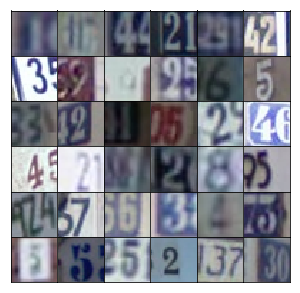

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [10]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer 4x4x512
        x  = tf.layers.dense(z, 4*4*512)
        x  = tf.reshape(x, [-1, 4, 4, 512])
        x  = tf.layers.batch_normalization(x, training=training)
        x  = tf.maximum(alpha * x, x)
        
        # 8x8x256
        x = tf.layers.conv2d_transpose(x, 256, 5, strides=2, padding='same')
        x = tf.layers.batch_normalization(x, training=training)
        x = tf.maximum(alpha * x, x)
        
        # 16x16x128
        x = tf.layers.conv2d_transpose(x, 128, 5, strides=2, padding='same')
        x = tf.layers.batch_normalization(x, training=training)
        x = tf.maximum(alpha * x, x)
        
        # Output layer, 32x32x3
        logits = tf.layers.conv2d_transpose(x, output_dim, 5, strides=2, padding='same')
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [11]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        # 16x16x64
        x = tf.layers.conv2d(x, 64, 5, strides=2, padding='same')
        x = tf.maximum(alpha * x, x)
        
        # 8x8x128
        x = tf.layers.conv2d(x, 128, 5, strides=2, padding='same')
        x = tf.layers.batch_normalization(x, training=True)
        x = tf.maximum(alpha * x, x)
        
        # 4x4x256
        x = tf.layers.conv2d(x, 256, 5, strides=2, padding='same')
        x = tf.layers.batch_normalization(x, training=True)
        x = tf.maximum(alpha * x, x)
        
        x = tf.reshape(x, [-1, 4*4*256])
        
        logits = tf.layers.dense(x, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [12]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [13]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [14]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [15]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [16]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [27]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 30
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/30... Discriminator Loss: 1.1377... Generator Loss: 0.6796
Epoch 1/30... Discriminator Loss: 0.4970... Generator Loss: 1.3594
Epoch 1/30... Discriminator Loss: 0.1312... Generator Loss: 3.6769
Epoch 1/30... Discriminator Loss: 0.1533... Generator Loss: 2.6442
Epoch 1/30... Discriminator Loss: 0.1696... Generator Loss: 2.6833
Epoch 1/30... Discriminator Loss: 0.1808... Generator Loss: 2.3879
Epoch 1/30... Discriminator Loss: 0.1811... Generator Loss: 2.8212
Epoch 1/30... Discriminator Loss: 0.2769... Generator Loss: 2.2690
Epoch 1/30... Discriminator Loss: 1.0758... Generator Loss: 1.2193
Epoch 1/30... Discriminator Loss: 0.7376... Generator Loss: 2.2317


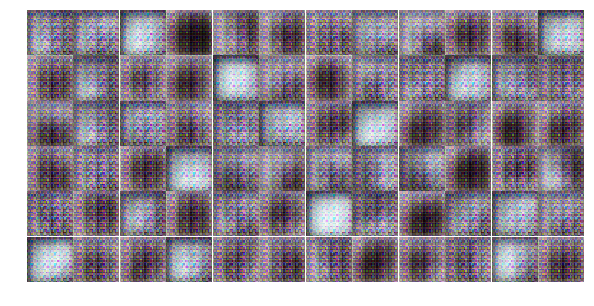

Epoch 1/30... Discriminator Loss: 0.4785... Generator Loss: 1.6532
Epoch 1/30... Discriminator Loss: 0.3477... Generator Loss: 1.8575
Epoch 1/30... Discriminator Loss: 0.6290... Generator Loss: 1.0572
Epoch 1/30... Discriminator Loss: 0.3892... Generator Loss: 3.3967
Epoch 1/30... Discriminator Loss: 0.6974... Generator Loss: 0.9642
Epoch 1/30... Discriminator Loss: 0.4905... Generator Loss: 1.5365
Epoch 1/30... Discriminator Loss: 0.3134... Generator Loss: 2.2385
Epoch 1/30... Discriminator Loss: 0.2863... Generator Loss: 2.4227
Epoch 1/30... Discriminator Loss: 2.5588... Generator Loss: 2.2586
Epoch 1/30... Discriminator Loss: 0.6064... Generator Loss: 2.4746


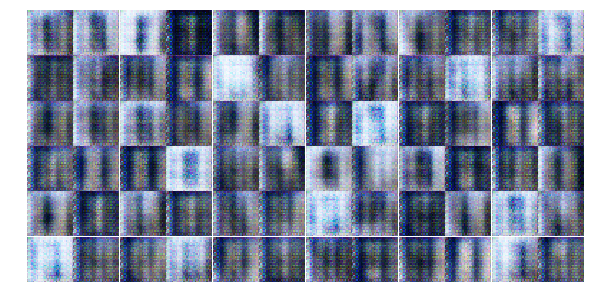

Epoch 1/30... Discriminator Loss: 1.1146... Generator Loss: 0.6462
Epoch 1/30... Discriminator Loss: 0.7157... Generator Loss: 1.1414
Epoch 1/30... Discriminator Loss: 0.8725... Generator Loss: 1.5355
Epoch 1/30... Discriminator Loss: 0.2126... Generator Loss: 2.5012
Epoch 1/30... Discriminator Loss: 1.2193... Generator Loss: 6.4782
Epoch 1/30... Discriminator Loss: 1.2490... Generator Loss: 1.5710
Epoch 1/30... Discriminator Loss: 1.0109... Generator Loss: 4.3215
Epoch 1/30... Discriminator Loss: 0.3421... Generator Loss: 3.6769
Epoch 1/30... Discriminator Loss: 0.2895... Generator Loss: 2.0555
Epoch 1/30... Discriminator Loss: 0.7623... Generator Loss: 2.3013


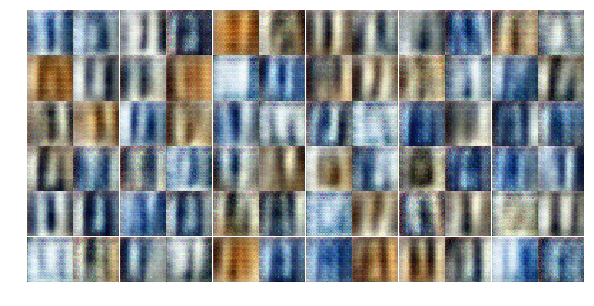

Epoch 1/30... Discriminator Loss: 0.3897... Generator Loss: 2.5772
Epoch 1/30... Discriminator Loss: 0.2769... Generator Loss: 3.0999
Epoch 1/30... Discriminator Loss: 0.8917... Generator Loss: 0.8982
Epoch 1/30... Discriminator Loss: 0.8478... Generator Loss: 1.5445
Epoch 1/30... Discriminator Loss: 0.9429... Generator Loss: 0.8011
Epoch 1/30... Discriminator Loss: 1.1236... Generator Loss: 0.6116
Epoch 1/30... Discriminator Loss: 0.8297... Generator Loss: 1.0139
Epoch 1/30... Discriminator Loss: 0.5954... Generator Loss: 1.8027
Epoch 1/30... Discriminator Loss: 0.6765... Generator Loss: 1.7984
Epoch 1/30... Discriminator Loss: 0.4164... Generator Loss: 2.3071


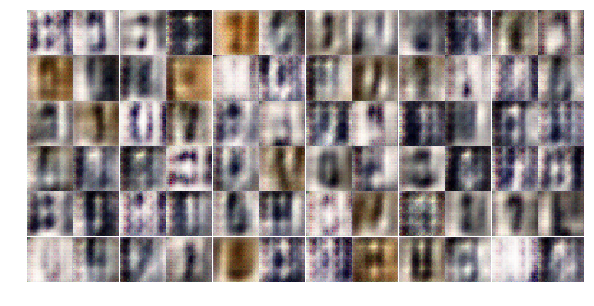

Epoch 1/30... Discriminator Loss: 0.6384... Generator Loss: 1.4007
Epoch 1/30... Discriminator Loss: 0.4342... Generator Loss: 1.9406
Epoch 1/30... Discriminator Loss: 0.9357... Generator Loss: 1.1012
Epoch 1/30... Discriminator Loss: 0.5754... Generator Loss: 1.8480
Epoch 1/30... Discriminator Loss: 0.8220... Generator Loss: 1.6570
Epoch 1/30... Discriminator Loss: 0.5877... Generator Loss: 1.5376
Epoch 1/30... Discriminator Loss: 0.3434... Generator Loss: 1.9992
Epoch 1/30... Discriminator Loss: 0.6850... Generator Loss: 1.8221
Epoch 1/30... Discriminator Loss: 0.8523... Generator Loss: 0.9149
Epoch 1/30... Discriminator Loss: 0.7948... Generator Loss: 1.1567


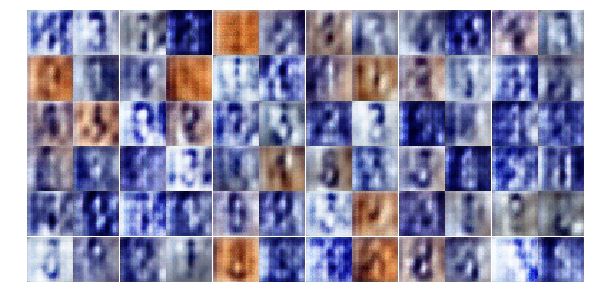

Epoch 1/30... Discriminator Loss: 0.8031... Generator Loss: 0.9994
Epoch 1/30... Discriminator Loss: 0.6747... Generator Loss: 1.9864
Epoch 1/30... Discriminator Loss: 0.8100... Generator Loss: 1.2073
Epoch 1/30... Discriminator Loss: 1.2694... Generator Loss: 0.6350
Epoch 1/30... Discriminator Loss: 0.7055... Generator Loss: 1.5368
Epoch 1/30... Discriminator Loss: 0.4759... Generator Loss: 1.8490
Epoch 1/30... Discriminator Loss: 0.5522... Generator Loss: 1.6712
Epoch 2/30... Discriminator Loss: 0.8744... Generator Loss: 1.8010
Epoch 2/30... Discriminator Loss: 0.6041... Generator Loss: 2.4295
Epoch 2/30... Discriminator Loss: 0.9499... Generator Loss: 0.9919


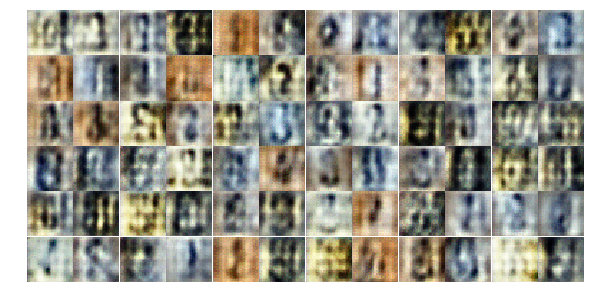

Epoch 2/30... Discriminator Loss: 0.7200... Generator Loss: 2.1703
Epoch 2/30... Discriminator Loss: 0.6835... Generator Loss: 1.2670
Epoch 2/30... Discriminator Loss: 0.9345... Generator Loss: 1.3832
Epoch 2/30... Discriminator Loss: 0.9315... Generator Loss: 0.9306
Epoch 2/30... Discriminator Loss: 1.3044... Generator Loss: 0.7081
Epoch 2/30... Discriminator Loss: 1.1297... Generator Loss: 0.9434
Epoch 2/30... Discriminator Loss: 0.9376... Generator Loss: 0.9868
Epoch 2/30... Discriminator Loss: 1.0087... Generator Loss: 0.9508
Epoch 2/30... Discriminator Loss: 0.8414... Generator Loss: 1.1714
Epoch 2/30... Discriminator Loss: 0.8837... Generator Loss: 1.2008


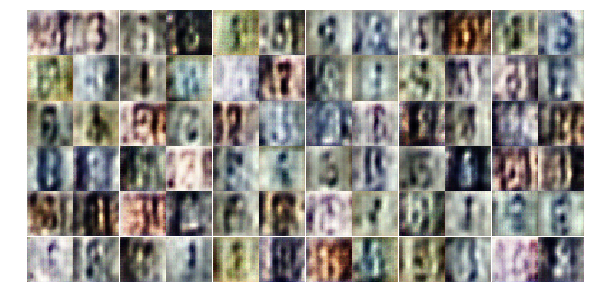

Epoch 2/30... Discriminator Loss: 1.4176... Generator Loss: 0.4770
Epoch 2/30... Discriminator Loss: 1.0796... Generator Loss: 1.3182
Epoch 2/30... Discriminator Loss: 0.7309... Generator Loss: 1.4960
Epoch 2/30... Discriminator Loss: 0.7728... Generator Loss: 1.1890
Epoch 2/30... Discriminator Loss: 1.0455... Generator Loss: 1.0603
Epoch 2/30... Discriminator Loss: 1.2504... Generator Loss: 0.7932
Epoch 2/30... Discriminator Loss: 1.0811... Generator Loss: 0.8902
Epoch 2/30... Discriminator Loss: 1.2981... Generator Loss: 0.6944
Epoch 2/30... Discriminator Loss: 1.0067... Generator Loss: 1.1088
Epoch 2/30... Discriminator Loss: 0.9779... Generator Loss: 0.9480


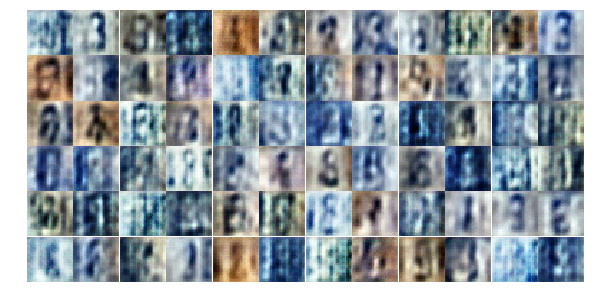

Epoch 2/30... Discriminator Loss: 1.2333... Generator Loss: 0.7152
Epoch 2/30... Discriminator Loss: 1.1235... Generator Loss: 0.9475
Epoch 2/30... Discriminator Loss: 0.8706... Generator Loss: 1.3193
Epoch 2/30... Discriminator Loss: 1.0605... Generator Loss: 1.2205
Epoch 2/30... Discriminator Loss: 0.9717... Generator Loss: 1.3238
Epoch 2/30... Discriminator Loss: 0.8986... Generator Loss: 1.0573
Epoch 2/30... Discriminator Loss: 1.0800... Generator Loss: 0.6281
Epoch 2/30... Discriminator Loss: 1.2576... Generator Loss: 0.6404
Epoch 2/30... Discriminator Loss: 1.1188... Generator Loss: 1.1472
Epoch 2/30... Discriminator Loss: 0.8492... Generator Loss: 1.4517


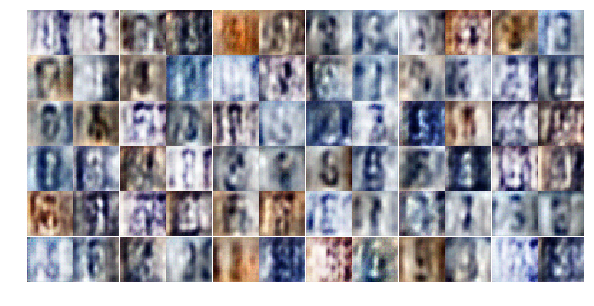

Epoch 2/30... Discriminator Loss: 1.1555... Generator Loss: 0.6814
Epoch 2/30... Discriminator Loss: 0.9611... Generator Loss: 1.1292
Epoch 2/30... Discriminator Loss: 1.1779... Generator Loss: 0.7576
Epoch 2/30... Discriminator Loss: 1.2149... Generator Loss: 0.7698
Epoch 2/30... Discriminator Loss: 0.9584... Generator Loss: 1.3271
Epoch 2/30... Discriminator Loss: 1.2493... Generator Loss: 0.6593
Epoch 2/30... Discriminator Loss: 1.1335... Generator Loss: 0.7935
Epoch 2/30... Discriminator Loss: 1.0480... Generator Loss: 1.2187
Epoch 2/30... Discriminator Loss: 1.1556... Generator Loss: 1.1525
Epoch 2/30... Discriminator Loss: 0.7473... Generator Loss: 1.2211


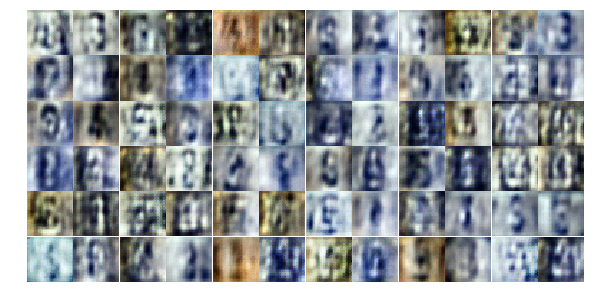

Epoch 2/30... Discriminator Loss: 0.7820... Generator Loss: 1.5240
Epoch 2/30... Discriminator Loss: 1.1243... Generator Loss: 1.2108
Epoch 2/30... Discriminator Loss: 1.0278... Generator Loss: 0.8290
Epoch 2/30... Discriminator Loss: 1.0847... Generator Loss: 0.7412
Epoch 2/30... Discriminator Loss: 1.0824... Generator Loss: 1.1742
Epoch 2/30... Discriminator Loss: 0.8939... Generator Loss: 0.8490
Epoch 2/30... Discriminator Loss: 1.0830... Generator Loss: 1.3784
Epoch 2/30... Discriminator Loss: 0.8468... Generator Loss: 1.0786
Epoch 2/30... Discriminator Loss: 0.7361... Generator Loss: 1.3383
Epoch 2/30... Discriminator Loss: 0.8374... Generator Loss: 1.4073


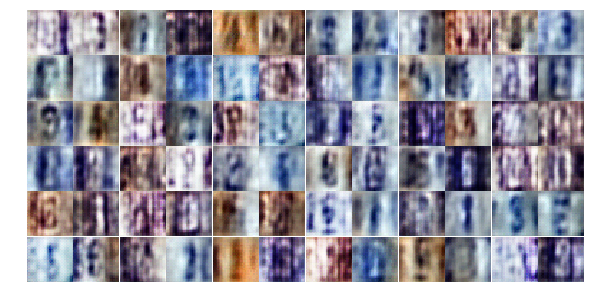

Epoch 2/30... Discriminator Loss: 0.7440... Generator Loss: 1.7648
Epoch 2/30... Discriminator Loss: 0.9842... Generator Loss: 0.8605
Epoch 2/30... Discriminator Loss: 0.9162... Generator Loss: 1.8667
Epoch 2/30... Discriminator Loss: 1.0674... Generator Loss: 0.6475
Epoch 3/30... Discriminator Loss: 1.3100... Generator Loss: 2.7289
Epoch 3/30... Discriminator Loss: 0.8144... Generator Loss: 0.9238
Epoch 3/30... Discriminator Loss: 0.8477... Generator Loss: 1.5633
Epoch 3/30... Discriminator Loss: 0.6739... Generator Loss: 1.1078
Epoch 3/30... Discriminator Loss: 1.0945... Generator Loss: 2.6420
Epoch 3/30... Discriminator Loss: 0.6793... Generator Loss: 1.6108


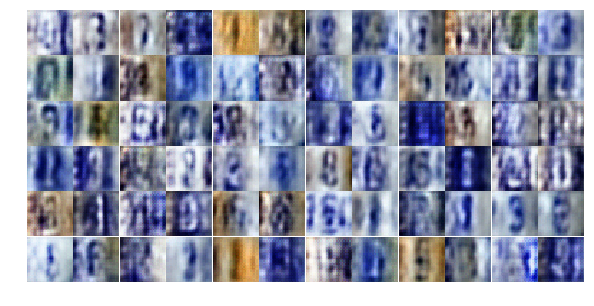

Epoch 3/30... Discriminator Loss: 0.4450... Generator Loss: 1.5292
Epoch 3/30... Discriminator Loss: 0.8305... Generator Loss: 1.5434
Epoch 3/30... Discriminator Loss: 0.4897... Generator Loss: 1.7766
Epoch 3/30... Discriminator Loss: 0.7558... Generator Loss: 0.9647
Epoch 3/30... Discriminator Loss: 0.6407... Generator Loss: 1.0656
Epoch 3/30... Discriminator Loss: 0.5070... Generator Loss: 1.4085
Epoch 3/30... Discriminator Loss: 1.8722... Generator Loss: 0.2376
Epoch 3/30... Discriminator Loss: 0.6040... Generator Loss: 1.7470
Epoch 3/30... Discriminator Loss: 0.7247... Generator Loss: 1.0725
Epoch 3/30... Discriminator Loss: 1.4151... Generator Loss: 0.4670


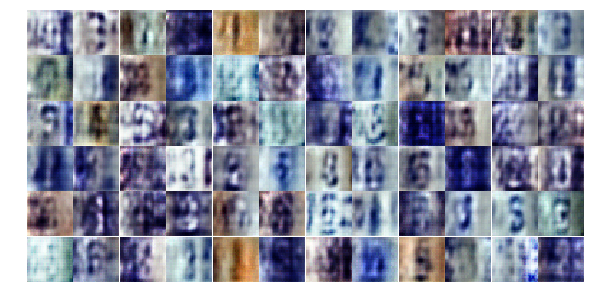

Epoch 3/30... Discriminator Loss: 0.9297... Generator Loss: 1.1909
Epoch 3/30... Discriminator Loss: 0.5696... Generator Loss: 1.5740
Epoch 3/30... Discriminator Loss: 0.3720... Generator Loss: 2.0644
Epoch 3/30... Discriminator Loss: 0.5098... Generator Loss: 1.5658
Epoch 3/30... Discriminator Loss: 0.7116... Generator Loss: 1.0785
Epoch 3/30... Discriminator Loss: 0.3735... Generator Loss: 3.0194
Epoch 3/30... Discriminator Loss: 0.4263... Generator Loss: 1.7504
Epoch 3/30... Discriminator Loss: 0.3284... Generator Loss: 2.3391
Epoch 3/30... Discriminator Loss: 0.5286... Generator Loss: 1.4653
Epoch 3/30... Discriminator Loss: 0.5545... Generator Loss: 1.3394


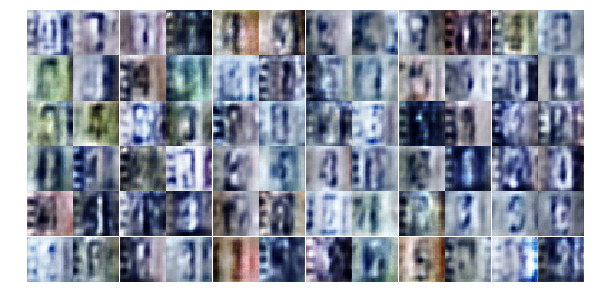

Epoch 3/30... Discriminator Loss: 0.4133... Generator Loss: 1.9250
Epoch 3/30... Discriminator Loss: 0.7934... Generator Loss: 1.6159
Epoch 3/30... Discriminator Loss: 1.3396... Generator Loss: 0.4740
Epoch 3/30... Discriminator Loss: 0.6901... Generator Loss: 2.0528
Epoch 3/30... Discriminator Loss: 0.5003... Generator Loss: 1.6281
Epoch 3/30... Discriminator Loss: 0.7935... Generator Loss: 1.0684
Epoch 3/30... Discriminator Loss: 1.1530... Generator Loss: 0.6822
Epoch 3/30... Discriminator Loss: 0.5304... Generator Loss: 2.7710
Epoch 3/30... Discriminator Loss: 0.6678... Generator Loss: 1.0710
Epoch 3/30... Discriminator Loss: 1.2288... Generator Loss: 3.0403


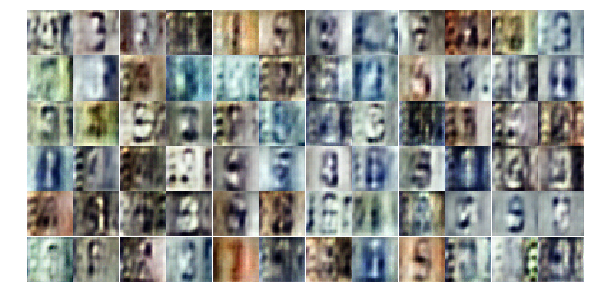

Epoch 3/30... Discriminator Loss: 0.7928... Generator Loss: 1.0646
Epoch 3/30... Discriminator Loss: 0.3791... Generator Loss: 2.6276
Epoch 3/30... Discriminator Loss: 0.4733... Generator Loss: 1.7687
Epoch 3/30... Discriminator Loss: 0.7704... Generator Loss: 0.9540
Epoch 3/30... Discriminator Loss: 0.5780... Generator Loss: 2.5152
Epoch 3/30... Discriminator Loss: 0.4290... Generator Loss: 1.9244
Epoch 3/30... Discriminator Loss: 0.7536... Generator Loss: 1.2077
Epoch 3/30... Discriminator Loss: 0.7453... Generator Loss: 0.9740
Epoch 3/30... Discriminator Loss: 0.8874... Generator Loss: 2.5030
Epoch 3/30... Discriminator Loss: 1.1662... Generator Loss: 0.5953


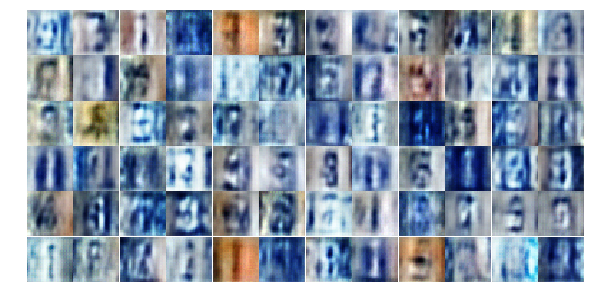

Epoch 3/30... Discriminator Loss: 0.7696... Generator Loss: 0.9933
Epoch 3/30... Discriminator Loss: 1.4511... Generator Loss: 0.4101
Epoch 3/30... Discriminator Loss: 0.4880... Generator Loss: 1.5013
Epoch 3/30... Discriminator Loss: 0.5870... Generator Loss: 1.4512
Epoch 3/30... Discriminator Loss: 0.4194... Generator Loss: 1.9894
Epoch 3/30... Discriminator Loss: 0.4359... Generator Loss: 2.1373
Epoch 3/30... Discriminator Loss: 0.5108... Generator Loss: 1.8816
Epoch 3/30... Discriminator Loss: 0.3483... Generator Loss: 2.3689
Epoch 3/30... Discriminator Loss: 0.7689... Generator Loss: 1.0288
Epoch 3/30... Discriminator Loss: 0.7945... Generator Loss: 1.1887


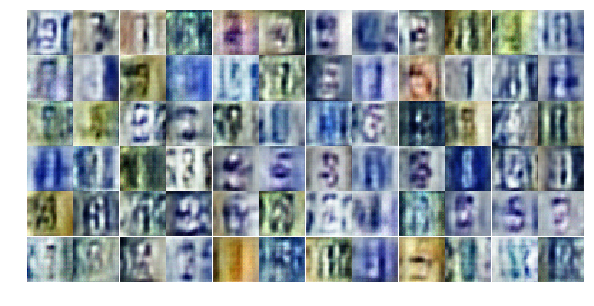

Epoch 3/30... Discriminator Loss: 0.5171... Generator Loss: 1.5003
Epoch 4/30... Discriminator Loss: 0.6258... Generator Loss: 1.2145
Epoch 4/30... Discriminator Loss: 0.7065... Generator Loss: 1.1160
Epoch 4/30... Discriminator Loss: 0.8770... Generator Loss: 0.8624
Epoch 4/30... Discriminator Loss: 0.5757... Generator Loss: 1.3298
Epoch 4/30... Discriminator Loss: 0.6608... Generator Loss: 1.8358
Epoch 4/30... Discriminator Loss: 0.6444... Generator Loss: 1.2380
Epoch 4/30... Discriminator Loss: 1.1001... Generator Loss: 0.6234
Epoch 4/30... Discriminator Loss: 1.2742... Generator Loss: 0.7049
Epoch 4/30... Discriminator Loss: 0.5866... Generator Loss: 1.3769


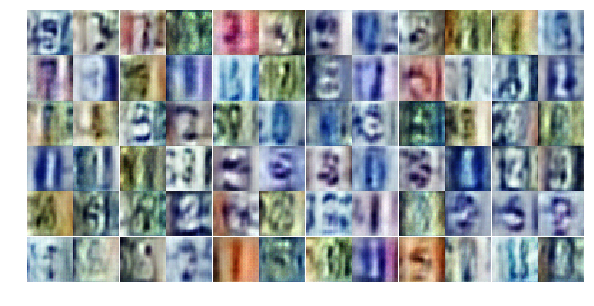

Epoch 4/30... Discriminator Loss: 0.4593... Generator Loss: 1.9538
Epoch 4/30... Discriminator Loss: 1.0735... Generator Loss: 0.6622
Epoch 4/30... Discriminator Loss: 0.7508... Generator Loss: 1.4281
Epoch 4/30... Discriminator Loss: 0.7453... Generator Loss: 1.2292
Epoch 4/30... Discriminator Loss: 0.8856... Generator Loss: 0.7738
Epoch 4/30... Discriminator Loss: 0.9403... Generator Loss: 0.8757
Epoch 4/30... Discriminator Loss: 0.9942... Generator Loss: 0.7678
Epoch 4/30... Discriminator Loss: 0.5768... Generator Loss: 1.5183
Epoch 4/30... Discriminator Loss: 0.5541... Generator Loss: 1.5352
Epoch 4/30... Discriminator Loss: 0.7076... Generator Loss: 1.5694


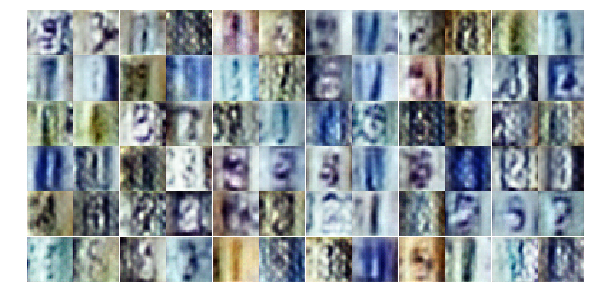

Epoch 4/30... Discriminator Loss: 0.5540... Generator Loss: 1.7844
Epoch 4/30... Discriminator Loss: 0.8736... Generator Loss: 2.6071
Epoch 4/30... Discriminator Loss: 0.8902... Generator Loss: 0.7251
Epoch 4/30... Discriminator Loss: 0.4979... Generator Loss: 1.7216
Epoch 4/30... Discriminator Loss: 0.4254... Generator Loss: 1.9977
Epoch 4/30... Discriminator Loss: 0.7419... Generator Loss: 1.8450
Epoch 4/30... Discriminator Loss: 0.3926... Generator Loss: 1.6928
Epoch 4/30... Discriminator Loss: 0.5681... Generator Loss: 1.3701
Epoch 4/30... Discriminator Loss: 0.7495... Generator Loss: 1.9752
Epoch 4/30... Discriminator Loss: 0.6184... Generator Loss: 2.6130


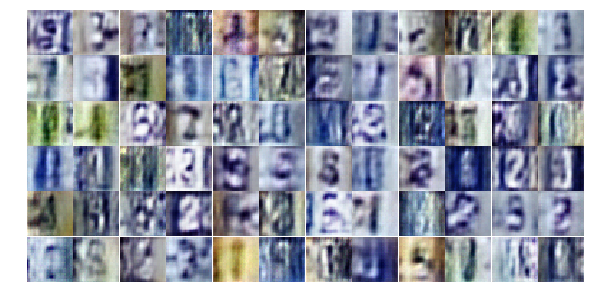

Epoch 4/30... Discriminator Loss: 0.6565... Generator Loss: 1.5310
Epoch 4/30... Discriminator Loss: 0.5279... Generator Loss: 1.9426
Epoch 4/30... Discriminator Loss: 0.5505... Generator Loss: 1.3875
Epoch 4/30... Discriminator Loss: 0.5125... Generator Loss: 2.1456
Epoch 4/30... Discriminator Loss: 0.4140... Generator Loss: 2.4020
Epoch 4/30... Discriminator Loss: 0.3995... Generator Loss: 2.2409
Epoch 4/30... Discriminator Loss: 0.5645... Generator Loss: 1.3904
Epoch 4/30... Discriminator Loss: 1.1862... Generator Loss: 0.5205
Epoch 4/30... Discriminator Loss: 0.3611... Generator Loss: 1.7124
Epoch 4/30... Discriminator Loss: 0.4655... Generator Loss: 1.4654


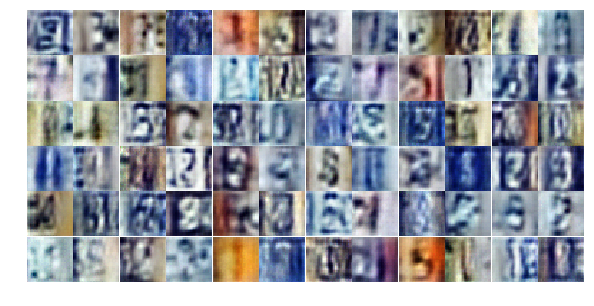

Epoch 4/30... Discriminator Loss: 0.8012... Generator Loss: 0.9373
Epoch 4/30... Discriminator Loss: 0.7245... Generator Loss: 0.9018
Epoch 4/30... Discriminator Loss: 0.9909... Generator Loss: 0.6795
Epoch 4/30... Discriminator Loss: 0.3367... Generator Loss: 1.9715
Epoch 4/30... Discriminator Loss: 0.5582... Generator Loss: 1.9224
Epoch 4/30... Discriminator Loss: 1.0193... Generator Loss: 0.6759
Epoch 4/30... Discriminator Loss: 0.3906... Generator Loss: 1.5692
Epoch 4/30... Discriminator Loss: 0.8498... Generator Loss: 0.9781
Epoch 4/30... Discriminator Loss: 0.8565... Generator Loss: 0.9314
Epoch 4/30... Discriminator Loss: 0.5565... Generator Loss: 1.5533


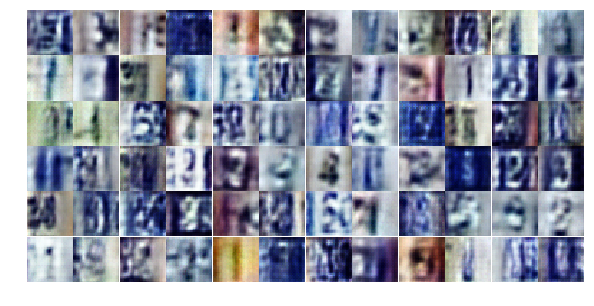

Epoch 4/30... Discriminator Loss: 0.4738... Generator Loss: 1.6960
Epoch 4/30... Discriminator Loss: 0.2492... Generator Loss: 2.6820
Epoch 4/30... Discriminator Loss: 0.2796... Generator Loss: 2.1245
Epoch 4/30... Discriminator Loss: 0.3674... Generator Loss: 2.4584
Epoch 4/30... Discriminator Loss: 0.7773... Generator Loss: 1.0242
Epoch 4/30... Discriminator Loss: 0.6509... Generator Loss: 1.2979
Epoch 4/30... Discriminator Loss: 0.4382... Generator Loss: 1.5720
Epoch 4/30... Discriminator Loss: 1.1296... Generator Loss: 0.5606
Epoch 4/30... Discriminator Loss: 0.4661... Generator Loss: 2.1199
Epoch 5/30... Discriminator Loss: 0.3932... Generator Loss: 1.6191


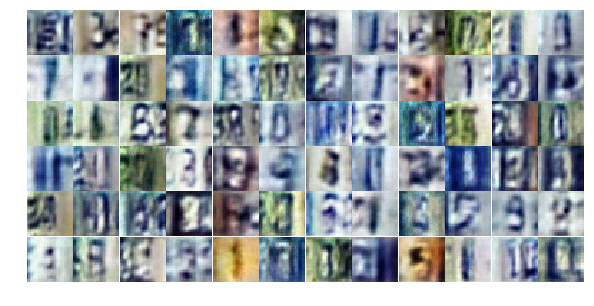

Epoch 5/30... Discriminator Loss: 0.4800... Generator Loss: 1.5388
Epoch 5/30... Discriminator Loss: 0.3400... Generator Loss: 1.9014
Epoch 5/30... Discriminator Loss: 0.4365... Generator Loss: 1.5251
Epoch 5/30... Discriminator Loss: 0.6119... Generator Loss: 0.9883
Epoch 5/30... Discriminator Loss: 0.3564... Generator Loss: 1.8920
Epoch 5/30... Discriminator Loss: 0.6458... Generator Loss: 1.1463
Epoch 5/30... Discriminator Loss: 1.4398... Generator Loss: 0.9781
Epoch 5/30... Discriminator Loss: 0.5954... Generator Loss: 1.3349
Epoch 5/30... Discriminator Loss: 0.7465... Generator Loss: 1.0367
Epoch 5/30... Discriminator Loss: 0.5374... Generator Loss: 1.4046


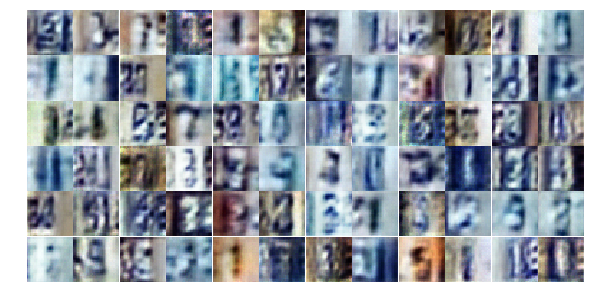

Epoch 5/30... Discriminator Loss: 0.6153... Generator Loss: 1.4243
Epoch 5/30... Discriminator Loss: 0.3688... Generator Loss: 2.2593
Epoch 5/30... Discriminator Loss: 0.3556... Generator Loss: 2.0716
Epoch 5/30... Discriminator Loss: 1.9001... Generator Loss: 0.3062
Epoch 5/30... Discriminator Loss: 0.7635... Generator Loss: 2.2645
Epoch 5/30... Discriminator Loss: 0.7633... Generator Loss: 1.2010
Epoch 5/30... Discriminator Loss: 0.5625... Generator Loss: 1.6242
Epoch 5/30... Discriminator Loss: 0.6464... Generator Loss: 1.6498
Epoch 5/30... Discriminator Loss: 0.5281... Generator Loss: 1.4124
Epoch 5/30... Discriminator Loss: 0.4257... Generator Loss: 1.7788


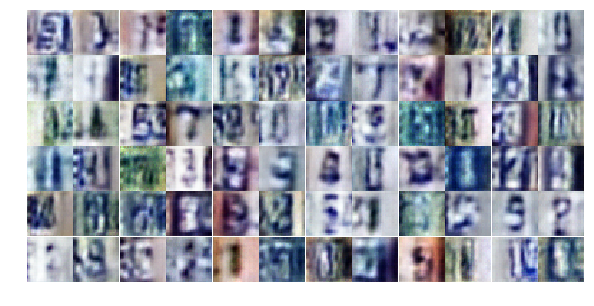

Epoch 5/30... Discriminator Loss: 0.6826... Generator Loss: 0.9745
Epoch 5/30... Discriminator Loss: 0.6211... Generator Loss: 1.2864
Epoch 5/30... Discriminator Loss: 0.5243... Generator Loss: 1.3194
Epoch 5/30... Discriminator Loss: 0.5495... Generator Loss: 1.3873
Epoch 5/30... Discriminator Loss: 0.9150... Generator Loss: 0.7163
Epoch 5/30... Discriminator Loss: 0.8836... Generator Loss: 0.7364
Epoch 5/30... Discriminator Loss: 1.0647... Generator Loss: 0.5790
Epoch 5/30... Discriminator Loss: 0.5051... Generator Loss: 1.9090
Epoch 5/30... Discriminator Loss: 1.0927... Generator Loss: 0.5747
Epoch 5/30... Discriminator Loss: 0.4435... Generator Loss: 1.5441


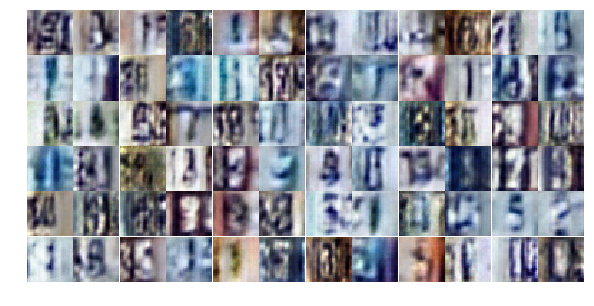

Epoch 5/30... Discriminator Loss: 0.4181... Generator Loss: 1.8051
Epoch 5/30... Discriminator Loss: 0.4270... Generator Loss: 1.5658
Epoch 5/30... Discriminator Loss: 0.4783... Generator Loss: 1.5005
Epoch 5/30... Discriminator Loss: 0.4643... Generator Loss: 1.4476
Epoch 5/30... Discriminator Loss: 0.8487... Generator Loss: 1.7745
Epoch 5/30... Discriminator Loss: 0.2344... Generator Loss: 2.6121
Epoch 5/30... Discriminator Loss: 0.8412... Generator Loss: 0.7971
Epoch 5/30... Discriminator Loss: 0.6332... Generator Loss: 1.3399
Epoch 5/30... Discriminator Loss: 1.1475... Generator Loss: 0.5416
Epoch 5/30... Discriminator Loss: 0.5265... Generator Loss: 1.3107


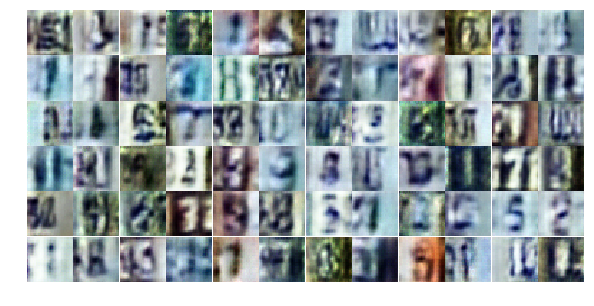

Epoch 5/30... Discriminator Loss: 0.4664... Generator Loss: 1.9152
Epoch 5/30... Discriminator Loss: 0.6715... Generator Loss: 0.9726
Epoch 5/30... Discriminator Loss: 1.1401... Generator Loss: 0.6017
Epoch 5/30... Discriminator Loss: 0.6075... Generator Loss: 1.7383
Epoch 5/30... Discriminator Loss: 0.9306... Generator Loss: 0.6814
Epoch 5/30... Discriminator Loss: 1.1485... Generator Loss: 0.5079
Epoch 5/30... Discriminator Loss: 0.4618... Generator Loss: 1.6630
Epoch 5/30... Discriminator Loss: 0.5677... Generator Loss: 1.2118
Epoch 5/30... Discriminator Loss: 0.4127... Generator Loss: 1.7473
Epoch 5/30... Discriminator Loss: 0.4887... Generator Loss: 1.5384


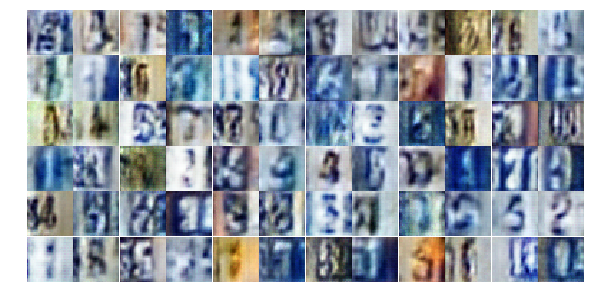

Epoch 5/30... Discriminator Loss: 1.0220... Generator Loss: 1.0286
Epoch 5/30... Discriminator Loss: 0.7497... Generator Loss: 0.8516
Epoch 5/30... Discriminator Loss: 0.7634... Generator Loss: 1.1694
Epoch 5/30... Discriminator Loss: 0.6387... Generator Loss: 1.1630
Epoch 5/30... Discriminator Loss: 0.5712... Generator Loss: 1.2918
Epoch 5/30... Discriminator Loss: 0.7108... Generator Loss: 1.0990
Epoch 6/30... Discriminator Loss: 0.5294... Generator Loss: 1.4081
Epoch 6/30... Discriminator Loss: 0.3614... Generator Loss: 1.5898
Epoch 6/30... Discriminator Loss: 0.4428... Generator Loss: 1.5601
Epoch 6/30... Discriminator Loss: 0.7297... Generator Loss: 0.9291


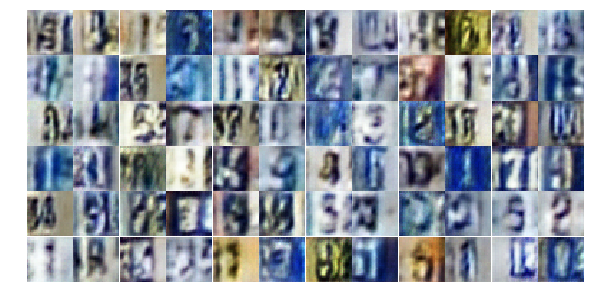

Epoch 6/30... Discriminator Loss: 1.0073... Generator Loss: 0.6371
Epoch 6/30... Discriminator Loss: 0.9193... Generator Loss: 0.9235
Epoch 6/30... Discriminator Loss: 0.9231... Generator Loss: 1.1849
Epoch 6/30... Discriminator Loss: 0.6759... Generator Loss: 1.1253
Epoch 6/30... Discriminator Loss: 1.0662... Generator Loss: 0.6176
Epoch 6/30... Discriminator Loss: 0.7049... Generator Loss: 0.8920
Epoch 6/30... Discriminator Loss: 0.4736... Generator Loss: 1.5985
Epoch 6/30... Discriminator Loss: 0.7844... Generator Loss: 0.9024
Epoch 6/30... Discriminator Loss: 0.7752... Generator Loss: 0.8084
Epoch 6/30... Discriminator Loss: 0.5188... Generator Loss: 1.4827


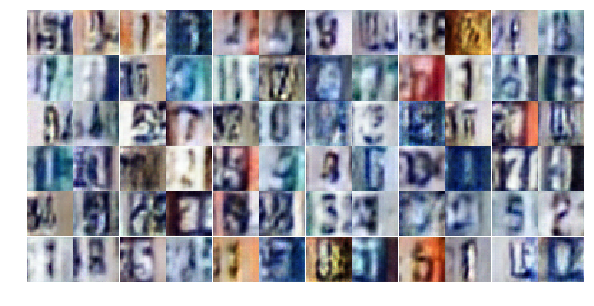

Epoch 6/30... Discriminator Loss: 1.0290... Generator Loss: 0.5727
Epoch 6/30... Discriminator Loss: 1.5661... Generator Loss: 1.5666
Epoch 6/30... Discriminator Loss: 1.0902... Generator Loss: 0.5550
Epoch 6/30... Discriminator Loss: 0.4624... Generator Loss: 1.4169
Epoch 6/30... Discriminator Loss: 0.6207... Generator Loss: 1.2834
Epoch 6/30... Discriminator Loss: 0.5074... Generator Loss: 1.6915
Epoch 6/30... Discriminator Loss: 0.5385... Generator Loss: 1.5939
Epoch 6/30... Discriminator Loss: 0.7443... Generator Loss: 0.9038
Epoch 6/30... Discriminator Loss: 1.1735... Generator Loss: 3.1577
Epoch 6/30... Discriminator Loss: 0.9867... Generator Loss: 0.6714


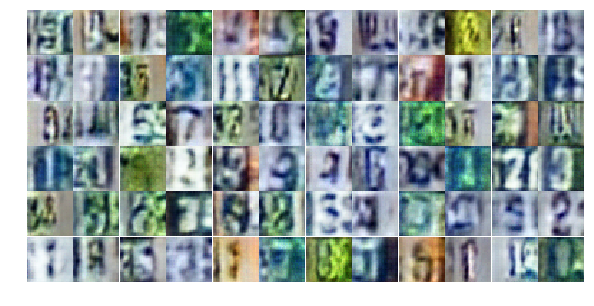

Epoch 6/30... Discriminator Loss: 0.9223... Generator Loss: 0.6781
Epoch 6/30... Discriminator Loss: 0.6341... Generator Loss: 1.0626
Epoch 6/30... Discriminator Loss: 0.6906... Generator Loss: 1.1328
Epoch 6/30... Discriminator Loss: 0.6682... Generator Loss: 1.0541
Epoch 6/30... Discriminator Loss: 0.3704... Generator Loss: 1.8108
Epoch 6/30... Discriminator Loss: 1.5396... Generator Loss: 0.4106
Epoch 6/30... Discriminator Loss: 0.9750... Generator Loss: 0.6495
Epoch 6/30... Discriminator Loss: 0.3638... Generator Loss: 1.5608
Epoch 6/30... Discriminator Loss: 0.4543... Generator Loss: 1.6655
Epoch 6/30... Discriminator Loss: 0.3375... Generator Loss: 1.9578


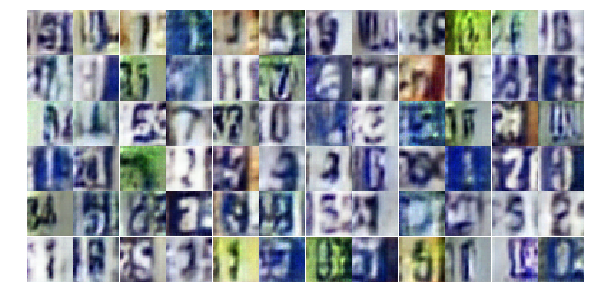

Epoch 6/30... Discriminator Loss: 0.6878... Generator Loss: 1.1004
Epoch 6/30... Discriminator Loss: 0.7347... Generator Loss: 0.9296
Epoch 6/30... Discriminator Loss: 0.8621... Generator Loss: 0.7321
Epoch 6/30... Discriminator Loss: 0.4899... Generator Loss: 1.3362
Epoch 6/30... Discriminator Loss: 0.6566... Generator Loss: 1.0487
Epoch 6/30... Discriminator Loss: 0.8244... Generator Loss: 0.8727
Epoch 6/30... Discriminator Loss: 0.4092... Generator Loss: 1.5737
Epoch 6/30... Discriminator Loss: 0.5442... Generator Loss: 1.9266
Epoch 6/30... Discriminator Loss: 0.6833... Generator Loss: 1.1328
Epoch 6/30... Discriminator Loss: 0.3681... Generator Loss: 1.6314


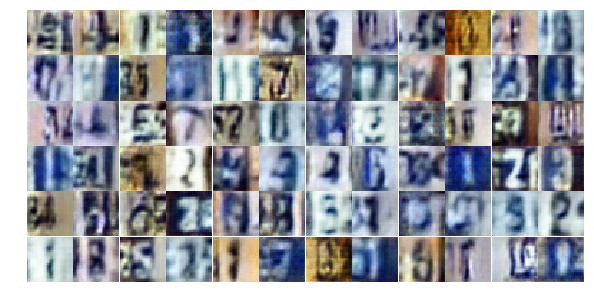

Epoch 6/30... Discriminator Loss: 0.6542... Generator Loss: 1.0060
Epoch 6/30... Discriminator Loss: 1.0094... Generator Loss: 2.2729
Epoch 6/30... Discriminator Loss: 0.6004... Generator Loss: 1.1880
Epoch 6/30... Discriminator Loss: 0.5422... Generator Loss: 1.3535
Epoch 6/30... Discriminator Loss: 0.4459... Generator Loss: 2.5744
Epoch 6/30... Discriminator Loss: 0.4670... Generator Loss: 1.3605
Epoch 6/30... Discriminator Loss: 0.7409... Generator Loss: 1.0231
Epoch 6/30... Discriminator Loss: 2.0413... Generator Loss: 0.2705
Epoch 6/30... Discriminator Loss: 1.1668... Generator Loss: 0.5268
Epoch 6/30... Discriminator Loss: 1.4554... Generator Loss: 0.3676


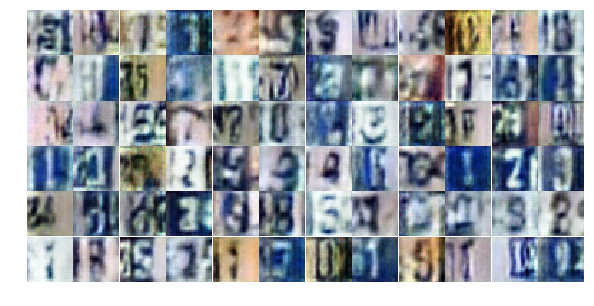

Epoch 6/30... Discriminator Loss: 0.6207... Generator Loss: 1.1498
Epoch 6/30... Discriminator Loss: 0.4598... Generator Loss: 1.6610
Epoch 6/30... Discriminator Loss: 0.4556... Generator Loss: 2.0288
Epoch 7/30... Discriminator Loss: 0.5703... Generator Loss: 1.9120
Epoch 7/30... Discriminator Loss: 0.8086... Generator Loss: 1.0334
Epoch 7/30... Discriminator Loss: 0.6571... Generator Loss: 1.2843
Epoch 7/30... Discriminator Loss: 1.0118... Generator Loss: 0.6143
Epoch 7/30... Discriminator Loss: 0.5172... Generator Loss: 1.6839
Epoch 7/30... Discriminator Loss: 0.4085... Generator Loss: 1.7896
Epoch 7/30... Discriminator Loss: 0.9922... Generator Loss: 0.6781


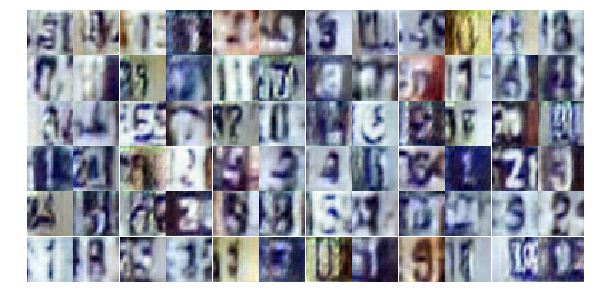

Epoch 7/30... Discriminator Loss: 0.5069... Generator Loss: 2.1301
Epoch 7/30... Discriminator Loss: 0.8340... Generator Loss: 0.7786
Epoch 7/30... Discriminator Loss: 0.7427... Generator Loss: 1.2037
Epoch 7/30... Discriminator Loss: 0.6150... Generator Loss: 1.3797
Epoch 7/30... Discriminator Loss: 0.3832... Generator Loss: 2.0587
Epoch 7/30... Discriminator Loss: 0.5121... Generator Loss: 1.2197
Epoch 7/30... Discriminator Loss: 0.9226... Generator Loss: 2.5982
Epoch 7/30... Discriminator Loss: 0.7831... Generator Loss: 1.7337
Epoch 7/30... Discriminator Loss: 0.8357... Generator Loss: 2.2955
Epoch 7/30... Discriminator Loss: 0.4755... Generator Loss: 1.7955


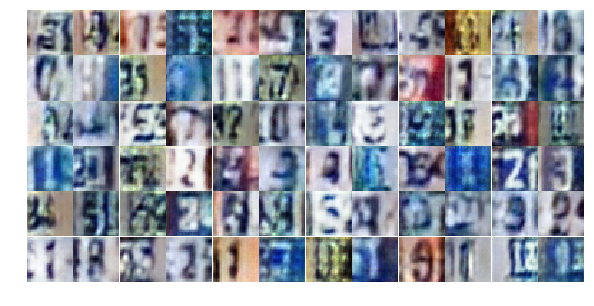

Epoch 7/30... Discriminator Loss: 0.5714... Generator Loss: 1.4559
Epoch 7/30... Discriminator Loss: 0.4202... Generator Loss: 1.7086
Epoch 7/30... Discriminator Loss: 0.6571... Generator Loss: 1.3178
Epoch 7/30... Discriminator Loss: 0.5286... Generator Loss: 1.8249
Epoch 7/30... Discriminator Loss: 0.4125... Generator Loss: 1.7927
Epoch 7/30... Discriminator Loss: 0.4064... Generator Loss: 1.6989
Epoch 7/30... Discriminator Loss: 0.7000... Generator Loss: 0.9647
Epoch 7/30... Discriminator Loss: 1.3229... Generator Loss: 0.4624
Epoch 7/30... Discriminator Loss: 0.4253... Generator Loss: 1.4777
Epoch 7/30... Discriminator Loss: 0.5524... Generator Loss: 2.5419


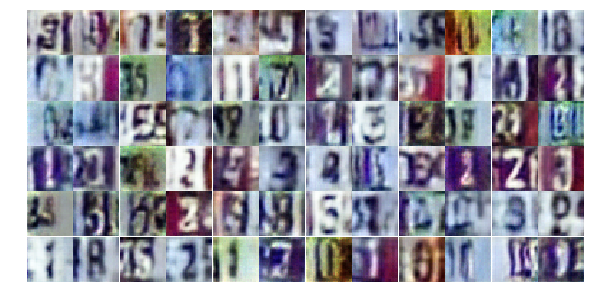

Epoch 7/30... Discriminator Loss: 1.5500... Generator Loss: 0.3100
Epoch 7/30... Discriminator Loss: 0.9621... Generator Loss: 0.6376
Epoch 7/30... Discriminator Loss: 0.9350... Generator Loss: 0.8152
Epoch 7/30... Discriminator Loss: 0.7752... Generator Loss: 0.8866
Epoch 7/30... Discriminator Loss: 0.6949... Generator Loss: 0.9694
Epoch 7/30... Discriminator Loss: 1.0440... Generator Loss: 0.6704
Epoch 7/30... Discriminator Loss: 0.4900... Generator Loss: 1.5079
Epoch 7/30... Discriminator Loss: 0.7643... Generator Loss: 0.9672
Epoch 7/30... Discriminator Loss: 0.8561... Generator Loss: 0.7199
Epoch 7/30... Discriminator Loss: 0.4523... Generator Loss: 2.2134


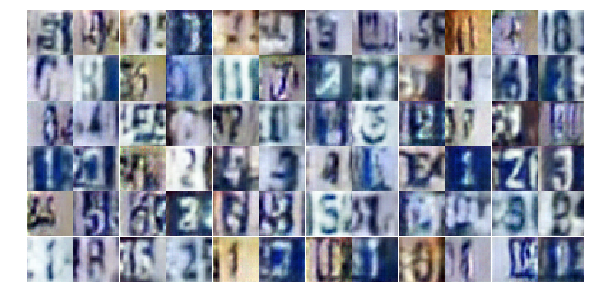

Epoch 7/30... Discriminator Loss: 1.4055... Generator Loss: 0.3872
Epoch 7/30... Discriminator Loss: 0.5271... Generator Loss: 1.8186
Epoch 7/30... Discriminator Loss: 0.3611... Generator Loss: 1.8656
Epoch 7/30... Discriminator Loss: 0.4898... Generator Loss: 1.7109
Epoch 7/30... Discriminator Loss: 0.8116... Generator Loss: 1.0777
Epoch 7/30... Discriminator Loss: 0.5060... Generator Loss: 1.8177
Epoch 7/30... Discriminator Loss: 0.8324... Generator Loss: 0.7649
Epoch 7/30... Discriminator Loss: 0.8886... Generator Loss: 0.7971
Epoch 7/30... Discriminator Loss: 0.3211... Generator Loss: 3.7981
Epoch 7/30... Discriminator Loss: 1.2981... Generator Loss: 0.4767


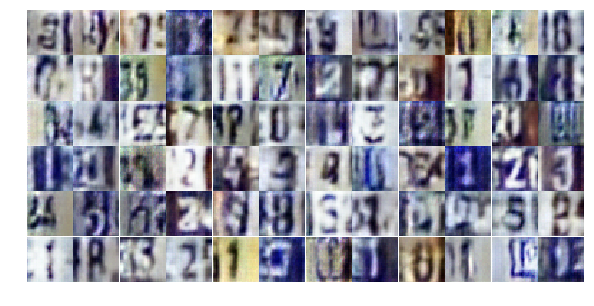

Epoch 7/30... Discriminator Loss: 0.4973... Generator Loss: 1.6299
Epoch 7/30... Discriminator Loss: 0.4838... Generator Loss: 1.3991
Epoch 7/30... Discriminator Loss: 0.6686... Generator Loss: 1.1295
Epoch 7/30... Discriminator Loss: 0.5334... Generator Loss: 1.2972
Epoch 7/30... Discriminator Loss: 0.6607... Generator Loss: 1.0103
Epoch 7/30... Discriminator Loss: 0.6600... Generator Loss: 1.4257
Epoch 7/30... Discriminator Loss: 1.3151... Generator Loss: 0.4073
Epoch 7/30... Discriminator Loss: 0.7306... Generator Loss: 1.7195
Epoch 7/30... Discriminator Loss: 0.8919... Generator Loss: 0.7334
Epoch 7/30... Discriminator Loss: 0.4025... Generator Loss: 1.6912


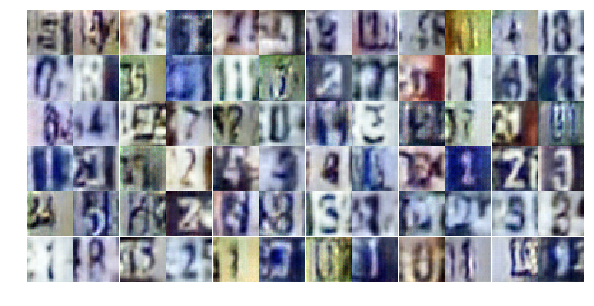

Epoch 7/30... Discriminator Loss: 0.5212... Generator Loss: 1.6674
Epoch 8/30... Discriminator Loss: 0.6601... Generator Loss: 0.9912
Epoch 8/30... Discriminator Loss: 0.5710... Generator Loss: 1.2326
Epoch 8/30... Discriminator Loss: 0.6021... Generator Loss: 1.2102
Epoch 8/30... Discriminator Loss: 0.6010... Generator Loss: 1.1137
Epoch 8/30... Discriminator Loss: 0.9169... Generator Loss: 2.3604
Epoch 8/30... Discriminator Loss: 0.6603... Generator Loss: 1.0038
Epoch 8/30... Discriminator Loss: 0.3884... Generator Loss: 1.6405
Epoch 8/30... Discriminator Loss: 0.6786... Generator Loss: 1.0255
Epoch 8/30... Discriminator Loss: 0.6750... Generator Loss: 1.0954


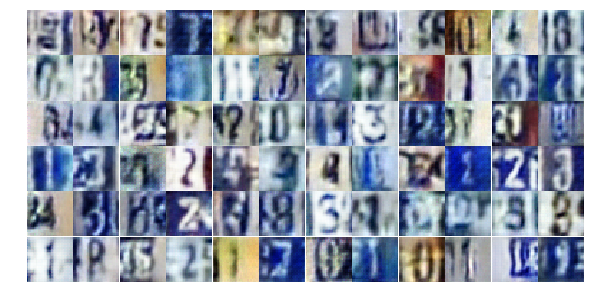

Epoch 8/30... Discriminator Loss: 0.4940... Generator Loss: 1.6230
Epoch 8/30... Discriminator Loss: 0.4944... Generator Loss: 1.5255
Epoch 8/30... Discriminator Loss: 0.4024... Generator Loss: 1.7607
Epoch 8/30... Discriminator Loss: 0.2830... Generator Loss: 1.9561
Epoch 8/30... Discriminator Loss: 0.9236... Generator Loss: 1.0709
Epoch 8/30... Discriminator Loss: 0.8898... Generator Loss: 0.8308
Epoch 8/30... Discriminator Loss: 0.4111... Generator Loss: 1.7927
Epoch 8/30... Discriminator Loss: 0.8700... Generator Loss: 0.8243
Epoch 8/30... Discriminator Loss: 0.9536... Generator Loss: 0.7162
Epoch 8/30... Discriminator Loss: 1.7558... Generator Loss: 0.2831


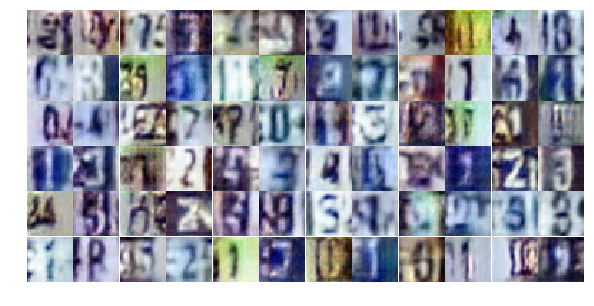

Epoch 8/30... Discriminator Loss: 0.4233... Generator Loss: 1.9835
Epoch 8/30... Discriminator Loss: 0.5022... Generator Loss: 1.3640
Epoch 8/30... Discriminator Loss: 0.6675... Generator Loss: 1.1044
Epoch 8/30... Discriminator Loss: 0.5409... Generator Loss: 2.0889
Epoch 8/30... Discriminator Loss: 0.3304... Generator Loss: 1.8898
Epoch 8/30... Discriminator Loss: 0.4392... Generator Loss: 1.4285
Epoch 8/30... Discriminator Loss: 0.5768... Generator Loss: 1.3830
Epoch 8/30... Discriminator Loss: 0.5051... Generator Loss: 1.4355
Epoch 8/30... Discriminator Loss: 0.6418... Generator Loss: 2.3280
Epoch 8/30... Discriminator Loss: 1.0658... Generator Loss: 0.6636


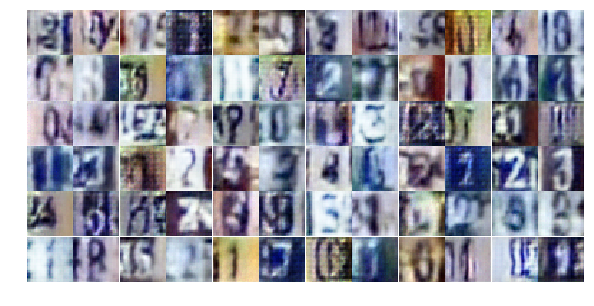

Epoch 8/30... Discriminator Loss: 1.2026... Generator Loss: 0.5394
Epoch 8/30... Discriminator Loss: 1.1311... Generator Loss: 0.5416
Epoch 8/30... Discriminator Loss: 0.5068... Generator Loss: 1.4344
Epoch 8/30... Discriminator Loss: 0.7464... Generator Loss: 0.8607
Epoch 8/30... Discriminator Loss: 0.8553... Generator Loss: 0.8151
Epoch 8/30... Discriminator Loss: 0.4248... Generator Loss: 1.4837
Epoch 8/30... Discriminator Loss: 0.5541... Generator Loss: 1.2795
Epoch 8/30... Discriminator Loss: 0.4940... Generator Loss: 1.6072
Epoch 8/30... Discriminator Loss: 1.0794... Generator Loss: 0.6061
Epoch 8/30... Discriminator Loss: 0.5268... Generator Loss: 1.4356


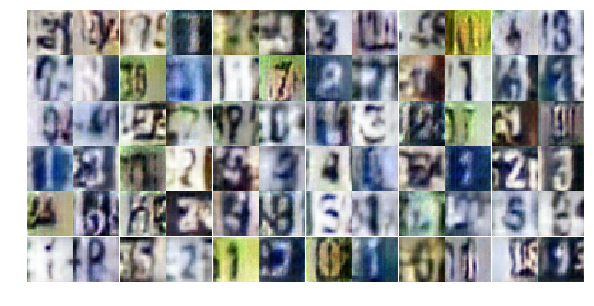

Epoch 8/30... Discriminator Loss: 0.8371... Generator Loss: 2.6573
Epoch 8/30... Discriminator Loss: 1.6289... Generator Loss: 0.3424
Epoch 8/30... Discriminator Loss: 0.7990... Generator Loss: 0.9392
Epoch 8/30... Discriminator Loss: 1.0241... Generator Loss: 0.6238
Epoch 8/30... Discriminator Loss: 1.0760... Generator Loss: 2.3020
Epoch 8/30... Discriminator Loss: 0.7061... Generator Loss: 1.0407
Epoch 8/30... Discriminator Loss: 0.4929... Generator Loss: 1.3271
Epoch 8/30... Discriminator Loss: 0.5477... Generator Loss: 2.3349
Epoch 8/30... Discriminator Loss: 0.8102... Generator Loss: 2.1120
Epoch 8/30... Discriminator Loss: 0.4742... Generator Loss: 1.6151


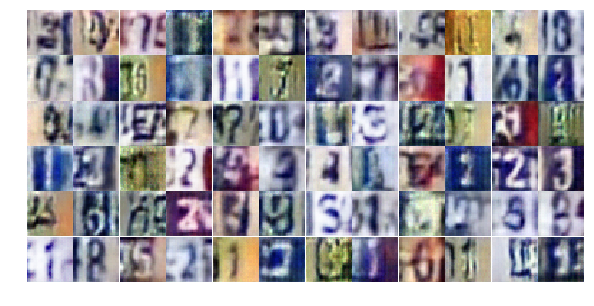

Epoch 8/30... Discriminator Loss: 0.9585... Generator Loss: 2.6184
Epoch 8/30... Discriminator Loss: 0.4709... Generator Loss: 1.4798
Epoch 8/30... Discriminator Loss: 0.5457... Generator Loss: 1.7277
Epoch 8/30... Discriminator Loss: 1.3279... Generator Loss: 0.4314
Epoch 8/30... Discriminator Loss: 0.5173... Generator Loss: 1.4317
Epoch 8/30... Discriminator Loss: 0.9161... Generator Loss: 0.7525
Epoch 8/30... Discriminator Loss: 0.6200... Generator Loss: 1.0972
Epoch 8/30... Discriminator Loss: 0.7520... Generator Loss: 2.5287
Epoch 9/30... Discriminator Loss: 0.7488... Generator Loss: 1.1335
Epoch 9/30... Discriminator Loss: 0.9208... Generator Loss: 0.7257


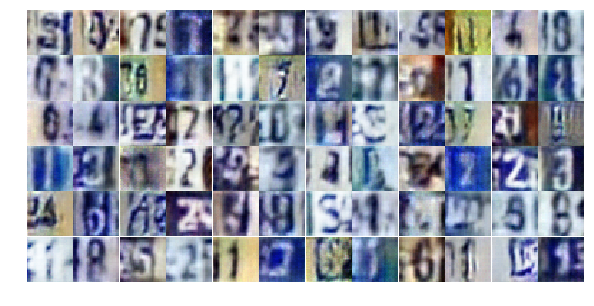

Epoch 9/30... Discriminator Loss: 0.6991... Generator Loss: 1.0907
Epoch 9/30... Discriminator Loss: 0.6669... Generator Loss: 0.9884
Epoch 9/30... Discriminator Loss: 0.9579... Generator Loss: 0.6904
Epoch 9/30... Discriminator Loss: 0.6639... Generator Loss: 1.0557
Epoch 9/30... Discriminator Loss: 1.4823... Generator Loss: 0.3607
Epoch 9/30... Discriminator Loss: 0.5325... Generator Loss: 1.3849
Epoch 9/30... Discriminator Loss: 0.6636... Generator Loss: 1.6282
Epoch 9/30... Discriminator Loss: 0.4853... Generator Loss: 1.2587
Epoch 9/30... Discriminator Loss: 0.9290... Generator Loss: 0.7081
Epoch 9/30... Discriminator Loss: 0.7095... Generator Loss: 1.0990


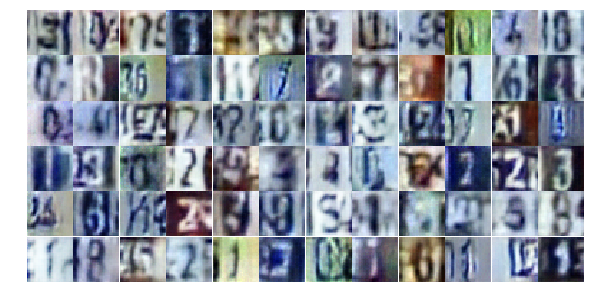

Epoch 9/30... Discriminator Loss: 0.9850... Generator Loss: 0.6415
Epoch 9/30... Discriminator Loss: 0.9787... Generator Loss: 0.7230
Epoch 9/30... Discriminator Loss: 0.7518... Generator Loss: 0.9706
Epoch 9/30... Discriminator Loss: 1.2463... Generator Loss: 3.1007
Epoch 9/30... Discriminator Loss: 0.6009... Generator Loss: 2.1333
Epoch 9/30... Discriminator Loss: 0.8055... Generator Loss: 0.9584
Epoch 9/30... Discriminator Loss: 0.6294... Generator Loss: 1.1958
Epoch 9/30... Discriminator Loss: 0.4340... Generator Loss: 1.5103
Epoch 9/30... Discriminator Loss: 0.9145... Generator Loss: 0.7192
Epoch 9/30... Discriminator Loss: 0.7427... Generator Loss: 0.9882


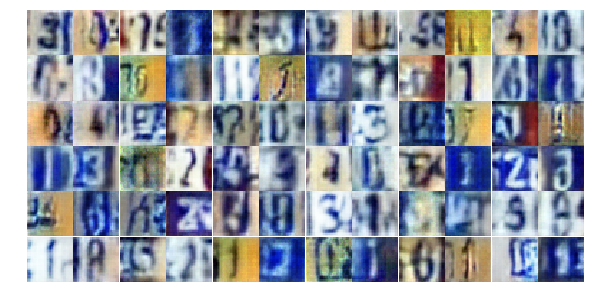

Epoch 9/30... Discriminator Loss: 0.7204... Generator Loss: 1.0487
Epoch 9/30... Discriminator Loss: 0.5427... Generator Loss: 1.2375
Epoch 9/30... Discriminator Loss: 0.5892... Generator Loss: 1.1575
Epoch 9/30... Discriminator Loss: 0.6647... Generator Loss: 1.0820
Epoch 9/30... Discriminator Loss: 0.5171... Generator Loss: 1.2745
Epoch 9/30... Discriminator Loss: 0.5671... Generator Loss: 1.2030
Epoch 9/30... Discriminator Loss: 0.4562... Generator Loss: 1.3996
Epoch 9/30... Discriminator Loss: 0.5105... Generator Loss: 1.9927
Epoch 9/30... Discriminator Loss: 0.4860... Generator Loss: 1.3242
Epoch 9/30... Discriminator Loss: 0.5444... Generator Loss: 1.2056


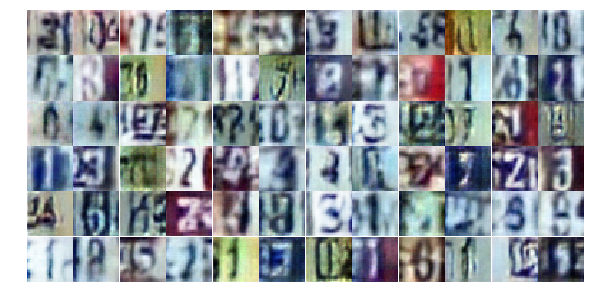

Epoch 9/30... Discriminator Loss: 0.4319... Generator Loss: 1.4613
Epoch 9/30... Discriminator Loss: 0.3603... Generator Loss: 1.8726
Epoch 9/30... Discriminator Loss: 0.8024... Generator Loss: 0.9002
Epoch 9/30... Discriminator Loss: 1.3441... Generator Loss: 0.5520
Epoch 9/30... Discriminator Loss: 1.1952... Generator Loss: 3.5766
Epoch 9/30... Discriminator Loss: 1.0101... Generator Loss: 0.7771
Epoch 9/30... Discriminator Loss: 0.9037... Generator Loss: 2.5619
Epoch 9/30... Discriminator Loss: 0.3758... Generator Loss: 1.7897
Epoch 9/30... Discriminator Loss: 1.0444... Generator Loss: 0.6708
Epoch 9/30... Discriminator Loss: 0.7665... Generator Loss: 0.8773


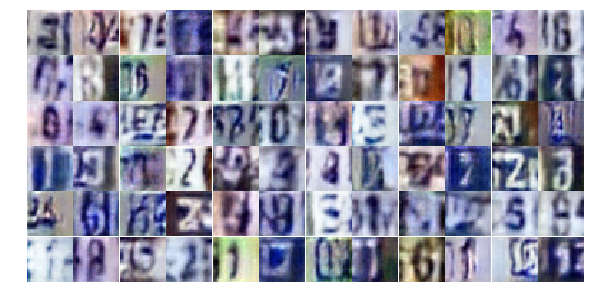

Epoch 9/30... Discriminator Loss: 0.4930... Generator Loss: 1.6999
Epoch 9/30... Discriminator Loss: 0.6288... Generator Loss: 1.0802
Epoch 9/30... Discriminator Loss: 0.5643... Generator Loss: 1.9591
Epoch 9/30... Discriminator Loss: 0.5968... Generator Loss: 2.1518
Epoch 9/30... Discriminator Loss: 0.5194... Generator Loss: 2.3256
Epoch 9/30... Discriminator Loss: 0.7219... Generator Loss: 0.9580
Epoch 9/30... Discriminator Loss: 0.8067... Generator Loss: 0.8581
Epoch 9/30... Discriminator Loss: 1.3408... Generator Loss: 0.3953
Epoch 9/30... Discriminator Loss: 0.5103... Generator Loss: 1.3523
Epoch 9/30... Discriminator Loss: 0.6050... Generator Loss: 1.7717


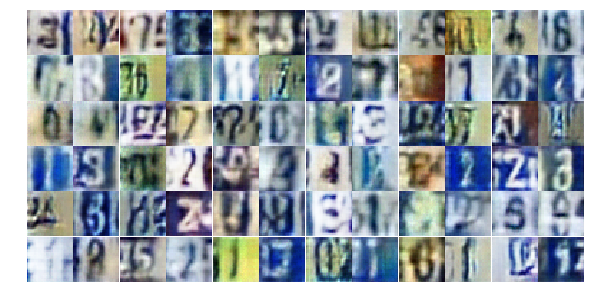

Epoch 9/30... Discriminator Loss: 0.7576... Generator Loss: 0.9963
Epoch 9/30... Discriminator Loss: 0.4786... Generator Loss: 2.0791
Epoch 9/30... Discriminator Loss: 0.6360... Generator Loss: 1.1298
Epoch 9/30... Discriminator Loss: 1.2815... Generator Loss: 0.4696
Epoch 9/30... Discriminator Loss: 0.4823... Generator Loss: 1.7432
Epoch 10/30... Discriminator Loss: 0.4863... Generator Loss: 1.5301
Epoch 10/30... Discriminator Loss: 0.5134... Generator Loss: 1.6976
Epoch 10/30... Discriminator Loss: 0.5787... Generator Loss: 1.1843
Epoch 10/30... Discriminator Loss: 0.6901... Generator Loss: 1.0920
Epoch 10/30... Discriminator Loss: 1.3154... Generator Loss: 0.4048


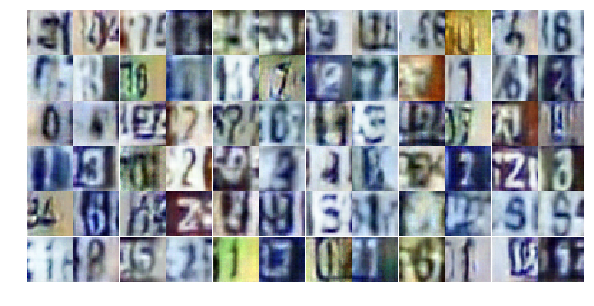

Epoch 10/30... Discriminator Loss: 1.2589... Generator Loss: 0.5209
Epoch 10/30... Discriminator Loss: 0.6700... Generator Loss: 1.0319
Epoch 10/30... Discriminator Loss: 0.6086... Generator Loss: 1.1295
Epoch 10/30... Discriminator Loss: 0.5545... Generator Loss: 1.3213
Epoch 10/30... Discriminator Loss: 0.5320... Generator Loss: 2.1500
Epoch 10/30... Discriminator Loss: 0.7442... Generator Loss: 0.9669
Epoch 10/30... Discriminator Loss: 0.5606... Generator Loss: 1.4229
Epoch 10/30... Discriminator Loss: 0.8541... Generator Loss: 0.8121
Epoch 10/30... Discriminator Loss: 1.6352... Generator Loss: 0.2884
Epoch 10/30... Discriminator Loss: 0.5666... Generator Loss: 1.4715


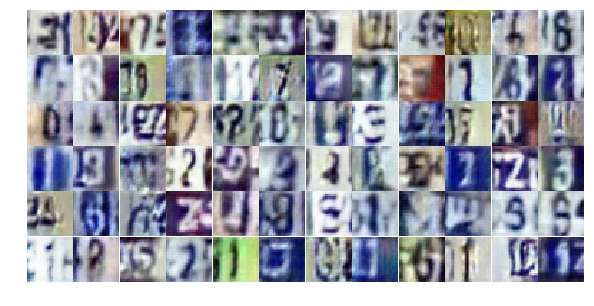

Epoch 10/30... Discriminator Loss: 0.5567... Generator Loss: 1.8572
Epoch 10/30... Discriminator Loss: 0.6943... Generator Loss: 1.0896
Epoch 10/30... Discriminator Loss: 0.6766... Generator Loss: 0.9664
Epoch 10/30... Discriminator Loss: 1.5222... Generator Loss: 0.3641
Epoch 10/30... Discriminator Loss: 0.5172... Generator Loss: 1.8167
Epoch 10/30... Discriminator Loss: 0.5481... Generator Loss: 1.3238
Epoch 10/30... Discriminator Loss: 1.2155... Generator Loss: 0.4787
Epoch 10/30... Discriminator Loss: 0.7639... Generator Loss: 0.9646
Epoch 10/30... Discriminator Loss: 0.7189... Generator Loss: 0.9843
Epoch 10/30... Discriminator Loss: 0.4117... Generator Loss: 2.7369


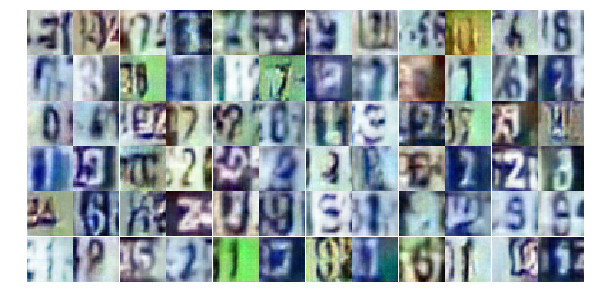

Epoch 10/30... Discriminator Loss: 0.9481... Generator Loss: 0.6766
Epoch 10/30... Discriminator Loss: 0.7930... Generator Loss: 0.8781
Epoch 10/30... Discriminator Loss: 0.4026... Generator Loss: 1.5439
Epoch 10/30... Discriminator Loss: 0.4866... Generator Loss: 2.0951
Epoch 10/30... Discriminator Loss: 1.2934... Generator Loss: 0.4187
Epoch 10/30... Discriminator Loss: 0.6887... Generator Loss: 1.0169
Epoch 10/30... Discriminator Loss: 0.4243... Generator Loss: 1.4038
Epoch 10/30... Discriminator Loss: 0.5814... Generator Loss: 1.3322
Epoch 10/30... Discriminator Loss: 0.6535... Generator Loss: 0.9986
Epoch 10/30... Discriminator Loss: 0.9587... Generator Loss: 2.1338


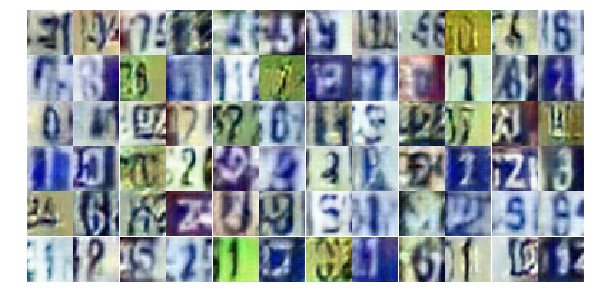

Epoch 10/30... Discriminator Loss: 0.4520... Generator Loss: 1.7984
Epoch 10/30... Discriminator Loss: 0.6207... Generator Loss: 1.1629
Epoch 10/30... Discriminator Loss: 0.8057... Generator Loss: 3.1299
Epoch 10/30... Discriminator Loss: 0.8053... Generator Loss: 1.5188
Epoch 10/30... Discriminator Loss: 1.0136... Generator Loss: 0.6071
Epoch 10/30... Discriminator Loss: 0.7807... Generator Loss: 0.9161
Epoch 10/30... Discriminator Loss: 0.6443... Generator Loss: 1.2604
Epoch 10/30... Discriminator Loss: 1.0300... Generator Loss: 0.6788
Epoch 10/30... Discriminator Loss: 0.5296... Generator Loss: 1.2712
Epoch 10/30... Discriminator Loss: 1.1296... Generator Loss: 0.6292


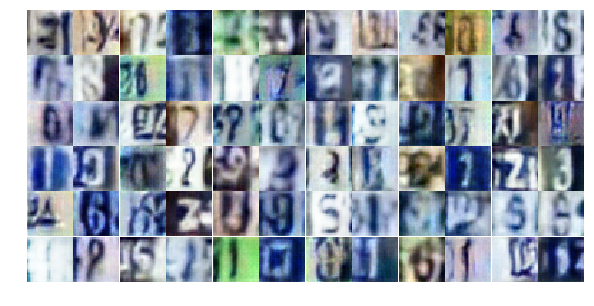

Epoch 10/30... Discriminator Loss: 1.4967... Generator Loss: 0.3916
Epoch 10/30... Discriminator Loss: 0.7767... Generator Loss: 0.9309
Epoch 10/30... Discriminator Loss: 0.4626... Generator Loss: 1.4075
Epoch 10/30... Discriminator Loss: 0.8884... Generator Loss: 0.7280
Epoch 10/30... Discriminator Loss: 0.4187... Generator Loss: 1.6961
Epoch 10/30... Discriminator Loss: 0.7416... Generator Loss: 1.6261
Epoch 10/30... Discriminator Loss: 0.6521... Generator Loss: 1.0191
Epoch 10/30... Discriminator Loss: 0.4239... Generator Loss: 1.8924
Epoch 10/30... Discriminator Loss: 2.2625... Generator Loss: 0.1821
Epoch 10/30... Discriminator Loss: 0.6400... Generator Loss: 1.9643


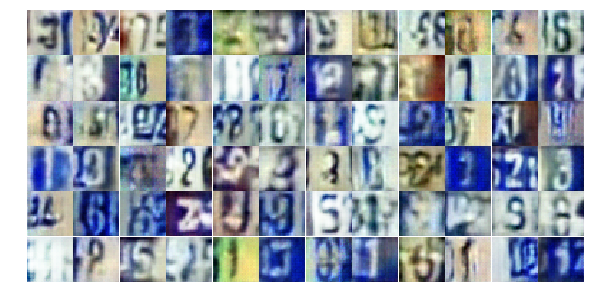

Epoch 10/30... Discriminator Loss: 0.7861... Generator Loss: 0.9783
Epoch 10/30... Discriminator Loss: 0.7159... Generator Loss: 0.9708
Epoch 10/30... Discriminator Loss: 0.6084... Generator Loss: 1.1419
Epoch 11/30... Discriminator Loss: 1.1143... Generator Loss: 0.6332
Epoch 11/30... Discriminator Loss: 0.6511... Generator Loss: 1.0764
Epoch 11/30... Discriminator Loss: 1.2840... Generator Loss: 0.4637
Epoch 11/30... Discriminator Loss: 0.7347... Generator Loss: 0.9430
Epoch 11/30... Discriminator Loss: 0.6270... Generator Loss: 1.6488
Epoch 11/30... Discriminator Loss: 1.7715... Generator Loss: 0.2958
Epoch 11/30... Discriminator Loss: 0.5579... Generator Loss: 1.6166


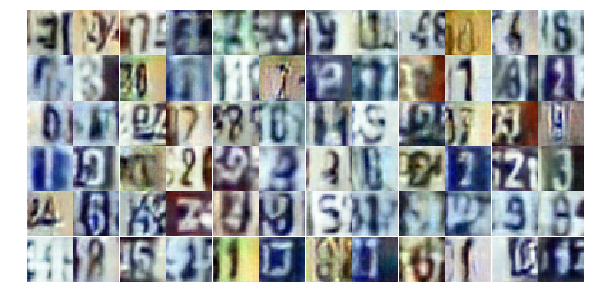

Epoch 11/30... Discriminator Loss: 0.4268... Generator Loss: 1.5390
Epoch 11/30... Discriminator Loss: 0.6954... Generator Loss: 1.0359
Epoch 11/30... Discriminator Loss: 0.4031... Generator Loss: 1.5352
Epoch 11/30... Discriminator Loss: 0.3295... Generator Loss: 1.7631
Epoch 11/30... Discriminator Loss: 0.7992... Generator Loss: 0.8545
Epoch 11/30... Discriminator Loss: 0.5369... Generator Loss: 1.5762
Epoch 11/30... Discriminator Loss: 0.5509... Generator Loss: 1.7300
Epoch 11/30... Discriminator Loss: 0.2703... Generator Loss: 2.3802
Epoch 11/30... Discriminator Loss: 0.6155... Generator Loss: 1.1340
Epoch 11/30... Discriminator Loss: 1.3755... Generator Loss: 0.4749


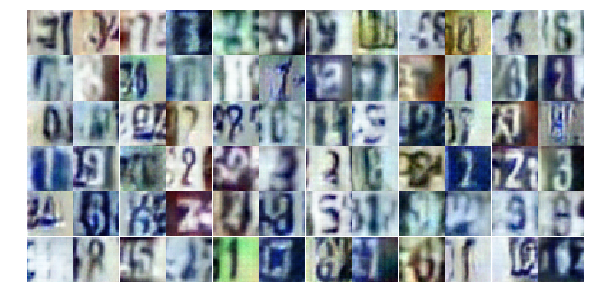

Epoch 11/30... Discriminator Loss: 1.4718... Generator Loss: 0.3629
Epoch 11/30... Discriminator Loss: 0.4373... Generator Loss: 2.0041
Epoch 11/30... Discriminator Loss: 0.6760... Generator Loss: 1.0211
Epoch 11/30... Discriminator Loss: 0.5245... Generator Loss: 1.2262
Epoch 11/30... Discriminator Loss: 0.3215... Generator Loss: 2.0015
Epoch 11/30... Discriminator Loss: 0.4404... Generator Loss: 2.4375
Epoch 11/30... Discriminator Loss: 0.5246... Generator Loss: 1.2158
Epoch 11/30... Discriminator Loss: 0.7691... Generator Loss: 1.0986
Epoch 11/30... Discriminator Loss: 0.4489... Generator Loss: 1.5958
Epoch 11/30... Discriminator Loss: 0.5120... Generator Loss: 1.3391


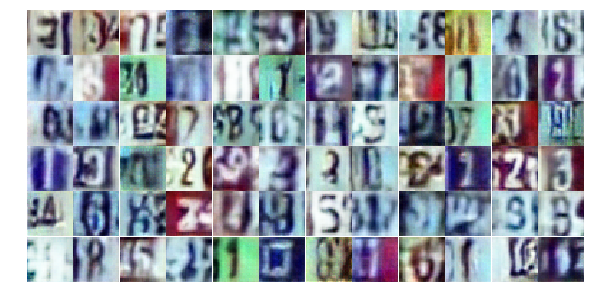

Epoch 11/30... Discriminator Loss: 0.6783... Generator Loss: 1.4512
Epoch 11/30... Discriminator Loss: 0.6929... Generator Loss: 1.0789
Epoch 11/30... Discriminator Loss: 0.6988... Generator Loss: 0.9528
Epoch 11/30... Discriminator Loss: 0.4102... Generator Loss: 1.7930
Epoch 11/30... Discriminator Loss: 0.5104... Generator Loss: 1.3516
Epoch 11/30... Discriminator Loss: 0.8643... Generator Loss: 0.7663
Epoch 11/30... Discriminator Loss: 1.0443... Generator Loss: 0.6977
Epoch 11/30... Discriminator Loss: 1.1834... Generator Loss: 0.4808
Epoch 11/30... Discriminator Loss: 0.5850... Generator Loss: 1.1139
Epoch 11/30... Discriminator Loss: 1.3075... Generator Loss: 0.4258


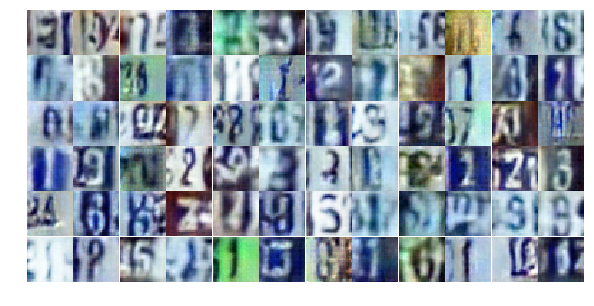

Epoch 11/30... Discriminator Loss: 0.5273... Generator Loss: 1.6099
Epoch 11/30... Discriminator Loss: 0.5472... Generator Loss: 1.3119
Epoch 11/30... Discriminator Loss: 0.5640... Generator Loss: 1.2112
Epoch 11/30... Discriminator Loss: 0.7068... Generator Loss: 0.9391
Epoch 11/30... Discriminator Loss: 0.8583... Generator Loss: 0.7648
Epoch 11/30... Discriminator Loss: 0.5167... Generator Loss: 1.8194
Epoch 11/30... Discriminator Loss: 0.5439... Generator Loss: 1.2900
Epoch 11/30... Discriminator Loss: 0.9815... Generator Loss: 0.7291
Epoch 11/30... Discriminator Loss: 0.9349... Generator Loss: 0.9328
Epoch 11/30... Discriminator Loss: 0.4138... Generator Loss: 1.6636


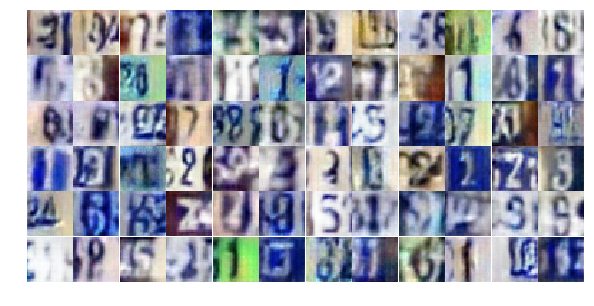

Epoch 11/30... Discriminator Loss: 0.7998... Generator Loss: 0.8686
Epoch 11/30... Discriminator Loss: 0.4844... Generator Loss: 1.3176
Epoch 11/30... Discriminator Loss: 0.5628... Generator Loss: 1.3635
Epoch 11/30... Discriminator Loss: 0.4761... Generator Loss: 1.3792
Epoch 11/30... Discriminator Loss: 0.6878... Generator Loss: 1.2044
Epoch 11/30... Discriminator Loss: 0.6590... Generator Loss: 1.1277
Epoch 11/30... Discriminator Loss: 1.7864... Generator Loss: 1.0919
Epoch 11/30... Discriminator Loss: 0.5292... Generator Loss: 1.4083
Epoch 11/30... Discriminator Loss: 0.6281... Generator Loss: 1.2114
Epoch 11/30... Discriminator Loss: 0.8400... Generator Loss: 0.8178


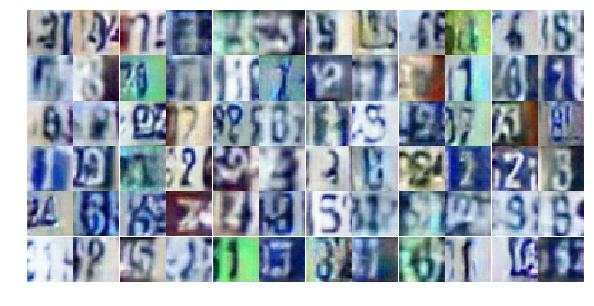

Epoch 12/30... Discriminator Loss: 0.7341... Generator Loss: 1.9130
Epoch 12/30... Discriminator Loss: 0.7885... Generator Loss: 0.8250
Epoch 12/30... Discriminator Loss: 0.7872... Generator Loss: 0.9070
Epoch 12/30... Discriminator Loss: 0.5367... Generator Loss: 1.8317
Epoch 12/30... Discriminator Loss: 0.3998... Generator Loss: 1.7529
Epoch 12/30... Discriminator Loss: 1.2652... Generator Loss: 0.4484
Epoch 12/30... Discriminator Loss: 0.7146... Generator Loss: 0.9550
Epoch 12/30... Discriminator Loss: 0.5668... Generator Loss: 1.2557
Epoch 12/30... Discriminator Loss: 0.5203... Generator Loss: 1.6699
Epoch 12/30... Discriminator Loss: 1.5103... Generator Loss: 0.3714


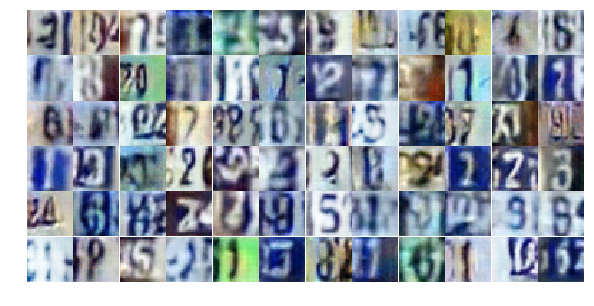

Epoch 12/30... Discriminator Loss: 0.4042... Generator Loss: 1.6515
Epoch 12/30... Discriminator Loss: 0.7527... Generator Loss: 0.9453
Epoch 12/30... Discriminator Loss: 0.6032... Generator Loss: 1.9977
Epoch 12/30... Discriminator Loss: 0.9026... Generator Loss: 1.7822
Epoch 12/30... Discriminator Loss: 0.5703... Generator Loss: 1.5760
Epoch 12/30... Discriminator Loss: 1.5930... Generator Loss: 0.3336
Epoch 12/30... Discriminator Loss: 2.0084... Generator Loss: 0.2082
Epoch 12/30... Discriminator Loss: 0.4282... Generator Loss: 1.8111
Epoch 12/30... Discriminator Loss: 0.5026... Generator Loss: 1.3999
Epoch 12/30... Discriminator Loss: 0.9136... Generator Loss: 0.7231


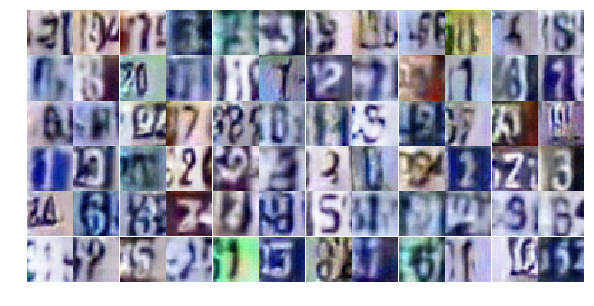

Epoch 12/30... Discriminator Loss: 0.3449... Generator Loss: 1.5293
Epoch 12/30... Discriminator Loss: 0.4258... Generator Loss: 1.6533
Epoch 12/30... Discriminator Loss: 0.7367... Generator Loss: 0.8661
Epoch 12/30... Discriminator Loss: 0.4503... Generator Loss: 1.4451
Epoch 12/30... Discriminator Loss: 0.4438... Generator Loss: 1.5523
Epoch 12/30... Discriminator Loss: 0.5408... Generator Loss: 1.2868
Epoch 12/30... Discriminator Loss: 0.5495... Generator Loss: 1.2640
Epoch 12/30... Discriminator Loss: 0.3690... Generator Loss: 1.7365
Epoch 12/30... Discriminator Loss: 0.4093... Generator Loss: 2.1439
Epoch 12/30... Discriminator Loss: 0.7820... Generator Loss: 0.8120


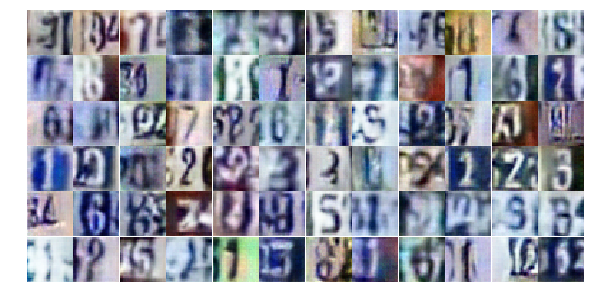

Epoch 12/30... Discriminator Loss: 0.5943... Generator Loss: 1.1425
Epoch 12/30... Discriminator Loss: 0.8858... Generator Loss: 0.7444
Epoch 12/30... Discriminator Loss: 0.6756... Generator Loss: 0.9428
Epoch 12/30... Discriminator Loss: 1.0951... Generator Loss: 0.6022
Epoch 12/30... Discriminator Loss: 0.5993... Generator Loss: 1.2208
Epoch 12/30... Discriminator Loss: 0.7148... Generator Loss: 1.0139
Epoch 12/30... Discriminator Loss: 0.8918... Generator Loss: 0.7155
Epoch 12/30... Discriminator Loss: 0.8985... Generator Loss: 2.3288
Epoch 12/30... Discriminator Loss: 0.5996... Generator Loss: 1.1815
Epoch 12/30... Discriminator Loss: 0.3803... Generator Loss: 1.4674


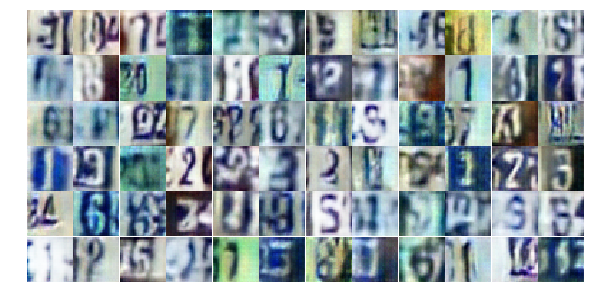

Epoch 12/30... Discriminator Loss: 0.9165... Generator Loss: 0.7229
Epoch 12/30... Discriminator Loss: 0.5688... Generator Loss: 3.1966
Epoch 12/30... Discriminator Loss: 0.6125... Generator Loss: 1.0853
Epoch 12/30... Discriminator Loss: 1.2251... Generator Loss: 0.5563
Epoch 12/30... Discriminator Loss: 0.6160... Generator Loss: 1.0652
Epoch 12/30... Discriminator Loss: 1.1606... Generator Loss: 0.5281
Epoch 12/30... Discriminator Loss: 1.1771... Generator Loss: 0.5652
Epoch 12/30... Discriminator Loss: 0.7464... Generator Loss: 1.0586
Epoch 12/30... Discriminator Loss: 0.6933... Generator Loss: 1.6723
Epoch 12/30... Discriminator Loss: 1.1288... Generator Loss: 3.5463


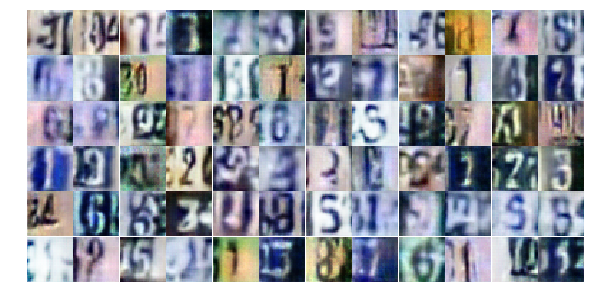

Epoch 12/30... Discriminator Loss: 1.2185... Generator Loss: 0.5745
Epoch 12/30... Discriminator Loss: 0.8389... Generator Loss: 0.9457
Epoch 12/30... Discriminator Loss: 0.6812... Generator Loss: 1.1687
Epoch 12/30... Discriminator Loss: 1.4790... Generator Loss: 0.3488
Epoch 12/30... Discriminator Loss: 0.6660... Generator Loss: 0.9847
Epoch 12/30... Discriminator Loss: 0.5878... Generator Loss: 1.4287
Epoch 12/30... Discriminator Loss: 0.9638... Generator Loss: 0.6897
Epoch 13/30... Discriminator Loss: 0.4474... Generator Loss: 1.4834
Epoch 13/30... Discriminator Loss: 0.4148... Generator Loss: 1.7659
Epoch 13/30... Discriminator Loss: 0.8859... Generator Loss: 0.7535


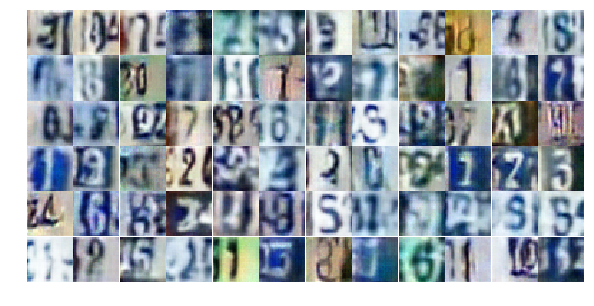

Epoch 13/30... Discriminator Loss: 0.5072... Generator Loss: 1.6652
Epoch 13/30... Discriminator Loss: 0.6585... Generator Loss: 1.9440
Epoch 13/30... Discriminator Loss: 1.0469... Generator Loss: 0.5970
Epoch 13/30... Discriminator Loss: 1.8775... Generator Loss: 0.2913
Epoch 13/30... Discriminator Loss: 0.8253... Generator Loss: 1.0641
Epoch 13/30... Discriminator Loss: 0.5879... Generator Loss: 1.4523
Epoch 13/30... Discriminator Loss: 0.3780... Generator Loss: 1.6483
Epoch 13/30... Discriminator Loss: 0.6736... Generator Loss: 0.9551
Epoch 13/30... Discriminator Loss: 0.5610... Generator Loss: 1.2322
Epoch 13/30... Discriminator Loss: 0.6293... Generator Loss: 1.0242


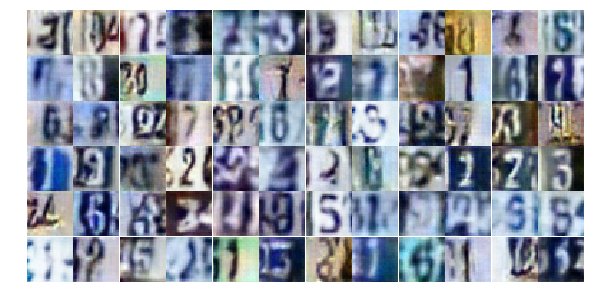

Epoch 13/30... Discriminator Loss: 0.6246... Generator Loss: 1.1336
Epoch 13/30... Discriminator Loss: 0.4522... Generator Loss: 1.4879
Epoch 13/30... Discriminator Loss: 3.1503... Generator Loss: 5.1906
Epoch 13/30... Discriminator Loss: 1.0008... Generator Loss: 0.7843
Epoch 13/30... Discriminator Loss: 0.5693... Generator Loss: 1.2780
Epoch 13/30... Discriminator Loss: 0.9825... Generator Loss: 0.6929
Epoch 13/30... Discriminator Loss: 0.6437... Generator Loss: 1.0939
Epoch 13/30... Discriminator Loss: 0.8665... Generator Loss: 0.7958
Epoch 13/30... Discriminator Loss: 0.6362... Generator Loss: 1.0558
Epoch 13/30... Discriminator Loss: 0.9876... Generator Loss: 0.6250


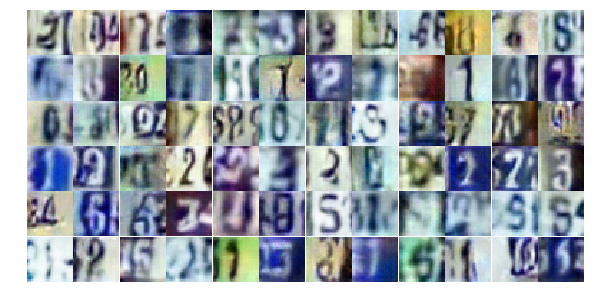

Epoch 13/30... Discriminator Loss: 0.6280... Generator Loss: 1.1807
Epoch 13/30... Discriminator Loss: 0.5108... Generator Loss: 1.5856
Epoch 13/30... Discriminator Loss: 0.4681... Generator Loss: 1.8965
Epoch 13/30... Discriminator Loss: 0.6380... Generator Loss: 1.0906
Epoch 13/30... Discriminator Loss: 0.7303... Generator Loss: 0.9340
Epoch 13/30... Discriminator Loss: 0.7928... Generator Loss: 0.9283
Epoch 13/30... Discriminator Loss: 0.9199... Generator Loss: 1.7123
Epoch 13/30... Discriminator Loss: 0.5916... Generator Loss: 1.1430
Epoch 13/30... Discriminator Loss: 0.6008... Generator Loss: 1.1767
Epoch 13/30... Discriminator Loss: 0.5910... Generator Loss: 1.1628


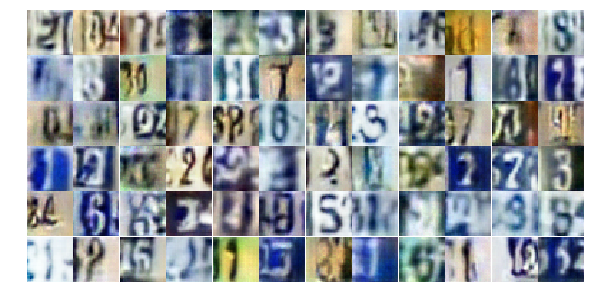

Epoch 13/30... Discriminator Loss: 1.1443... Generator Loss: 0.4940
Epoch 13/30... Discriminator Loss: 0.7383... Generator Loss: 2.3353
Epoch 13/30... Discriminator Loss: 0.9314... Generator Loss: 0.7438
Epoch 13/30... Discriminator Loss: 1.3974... Generator Loss: 0.3651
Epoch 13/30... Discriminator Loss: 0.7943... Generator Loss: 0.8133
Epoch 13/30... Discriminator Loss: 0.5768... Generator Loss: 1.5028
Epoch 13/30... Discriminator Loss: 0.3656... Generator Loss: 2.0917
Epoch 13/30... Discriminator Loss: 1.1731... Generator Loss: 0.5952
Epoch 13/30... Discriminator Loss: 0.5625... Generator Loss: 1.4087
Epoch 13/30... Discriminator Loss: 1.0087... Generator Loss: 0.6510


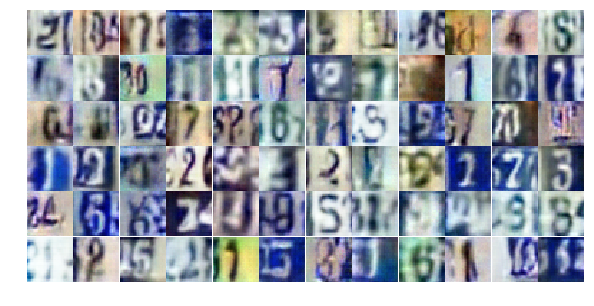

Epoch 13/30... Discriminator Loss: 0.4725... Generator Loss: 1.4500
Epoch 13/30... Discriminator Loss: 1.7541... Generator Loss: 3.1312
Epoch 13/30... Discriminator Loss: 0.7711... Generator Loss: 0.9691
Epoch 13/30... Discriminator Loss: 0.7042... Generator Loss: 1.0204
Epoch 13/30... Discriminator Loss: 0.8411... Generator Loss: 0.8256
Epoch 13/30... Discriminator Loss: 0.6296... Generator Loss: 1.0803
Epoch 13/30... Discriminator Loss: 0.6162... Generator Loss: 1.2222
Epoch 13/30... Discriminator Loss: 0.7363... Generator Loss: 0.9368
Epoch 13/30... Discriminator Loss: 0.9126... Generator Loss: 0.7616
Epoch 13/30... Discriminator Loss: 0.7948... Generator Loss: 0.8895


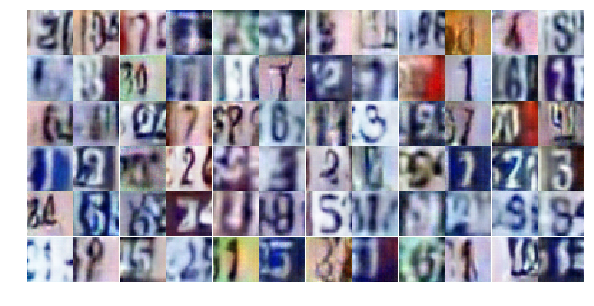

Epoch 13/30... Discriminator Loss: 0.3532... Generator Loss: 2.0760
Epoch 13/30... Discriminator Loss: 1.5475... Generator Loss: 0.4041
Epoch 13/30... Discriminator Loss: 0.6507... Generator Loss: 1.0649
Epoch 13/30... Discriminator Loss: 0.8732... Generator Loss: 0.7699
Epoch 14/30... Discriminator Loss: 1.4916... Generator Loss: 0.3732
Epoch 14/30... Discriminator Loss: 0.7754... Generator Loss: 0.9251
Epoch 14/30... Discriminator Loss: 0.7856... Generator Loss: 0.9259
Epoch 14/30... Discriminator Loss: 0.5155... Generator Loss: 1.4557
Epoch 14/30... Discriminator Loss: 0.5631... Generator Loss: 1.1725
Epoch 14/30... Discriminator Loss: 0.6196... Generator Loss: 1.0982


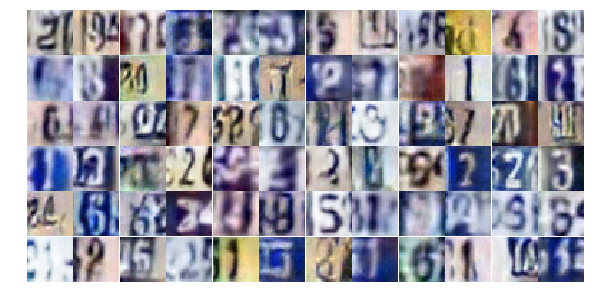

Epoch 14/30... Discriminator Loss: 0.7442... Generator Loss: 2.5489
Epoch 14/30... Discriminator Loss: 1.1089... Generator Loss: 0.5431
Epoch 14/30... Discriminator Loss: 0.6242... Generator Loss: 1.3306
Epoch 14/30... Discriminator Loss: 0.9402... Generator Loss: 0.7418
Epoch 14/30... Discriminator Loss: 1.3134... Generator Loss: 0.4791
Epoch 14/30... Discriminator Loss: 0.3109... Generator Loss: 1.7088
Epoch 14/30... Discriminator Loss: 0.4714... Generator Loss: 1.2736
Epoch 14/30... Discriminator Loss: 2.0094... Generator Loss: 0.2741
Epoch 14/30... Discriminator Loss: 2.1153... Generator Loss: 0.1908
Epoch 14/30... Discriminator Loss: 1.1754... Generator Loss: 0.5503


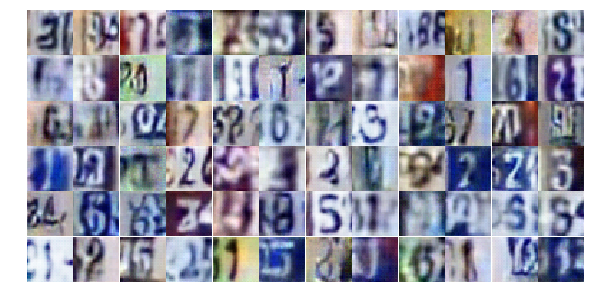

Epoch 14/30... Discriminator Loss: 0.6295... Generator Loss: 1.0466
Epoch 14/30... Discriminator Loss: 0.4310... Generator Loss: 1.6717
Epoch 14/30... Discriminator Loss: 0.8283... Generator Loss: 0.8471
Epoch 14/30... Discriminator Loss: 0.4982... Generator Loss: 1.3777
Epoch 14/30... Discriminator Loss: 1.0012... Generator Loss: 0.6204
Epoch 14/30... Discriminator Loss: 0.8484... Generator Loss: 0.8943
Epoch 14/30... Discriminator Loss: 0.6828... Generator Loss: 0.9558
Epoch 14/30... Discriminator Loss: 0.8088... Generator Loss: 0.9540
Epoch 14/30... Discriminator Loss: 0.7292... Generator Loss: 1.0469
Epoch 14/30... Discriminator Loss: 0.5015... Generator Loss: 1.3948


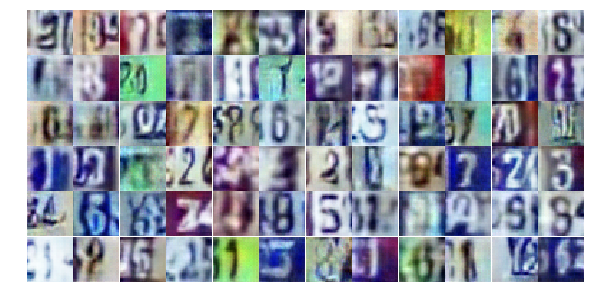

Epoch 14/30... Discriminator Loss: 1.7565... Generator Loss: 0.2803
Epoch 14/30... Discriminator Loss: 0.7379... Generator Loss: 0.8875
Epoch 14/30... Discriminator Loss: 0.4616... Generator Loss: 1.4464
Epoch 14/30... Discriminator Loss: 0.4467... Generator Loss: 1.3669
Epoch 14/30... Discriminator Loss: 0.6117... Generator Loss: 1.1003
Epoch 14/30... Discriminator Loss: 0.5719... Generator Loss: 1.2922
Epoch 14/30... Discriminator Loss: 0.6254... Generator Loss: 1.1167
Epoch 14/30... Discriminator Loss: 0.3212... Generator Loss: 1.9864
Epoch 14/30... Discriminator Loss: 0.6002... Generator Loss: 1.0716
Epoch 14/30... Discriminator Loss: 0.8686... Generator Loss: 0.9071


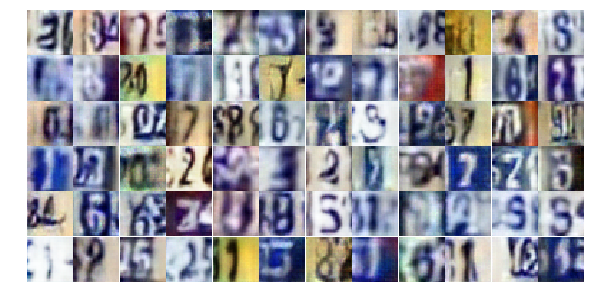

Epoch 14/30... Discriminator Loss: 1.3735... Generator Loss: 0.4012
Epoch 14/30... Discriminator Loss: 0.7112... Generator Loss: 0.9087
Epoch 14/30... Discriminator Loss: 0.9361... Generator Loss: 0.6963
Epoch 14/30... Discriminator Loss: 1.3807... Generator Loss: 0.4181
Epoch 14/30... Discriminator Loss: 0.9759... Generator Loss: 0.7214
Epoch 14/30... Discriminator Loss: 0.5170... Generator Loss: 1.2665
Epoch 14/30... Discriminator Loss: 0.6843... Generator Loss: 1.0419
Epoch 14/30... Discriminator Loss: 0.4794... Generator Loss: 1.7078
Epoch 14/30... Discriminator Loss: 1.9647... Generator Loss: 0.2227
Epoch 14/30... Discriminator Loss: 1.3853... Generator Loss: 0.4836


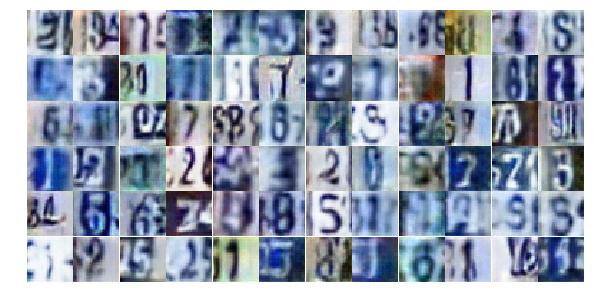

Epoch 14/30... Discriminator Loss: 0.7799... Generator Loss: 1.2022
Epoch 14/30... Discriminator Loss: 1.0783... Generator Loss: 0.6397
Epoch 14/30... Discriminator Loss: 0.6843... Generator Loss: 1.1775
Epoch 14/30... Discriminator Loss: 0.8255... Generator Loss: 0.8493
Epoch 14/30... Discriminator Loss: 0.4771... Generator Loss: 1.4962
Epoch 14/30... Discriminator Loss: 0.7202... Generator Loss: 0.9523
Epoch 14/30... Discriminator Loss: 0.5709... Generator Loss: 1.5010
Epoch 14/30... Discriminator Loss: 0.5869... Generator Loss: 1.4923
Epoch 14/30... Discriminator Loss: 0.8558... Generator Loss: 0.9291
Epoch 14/30... Discriminator Loss: 1.2265... Generator Loss: 0.4765


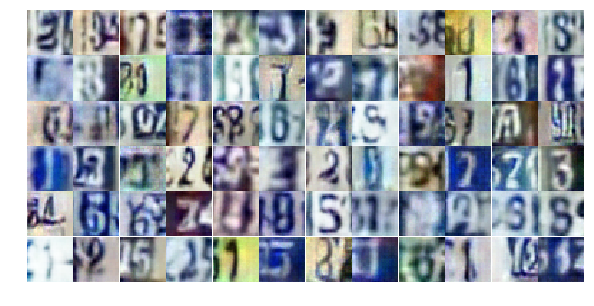

Epoch 14/30... Discriminator Loss: 0.6665... Generator Loss: 1.2743
Epoch 14/30... Discriminator Loss: 1.1059... Generator Loss: 0.5610
Epoch 15/30... Discriminator Loss: 0.9279... Generator Loss: 0.7211
Epoch 15/30... Discriminator Loss: 0.6908... Generator Loss: 0.9980
Epoch 15/30... Discriminator Loss: 0.5749... Generator Loss: 1.2069
Epoch 15/30... Discriminator Loss: 0.9697... Generator Loss: 0.7159
Epoch 15/30... Discriminator Loss: 1.1455... Generator Loss: 0.5304
Epoch 15/30... Discriminator Loss: 0.7106... Generator Loss: 1.0605
Epoch 15/30... Discriminator Loss: 0.9158... Generator Loss: 1.1945
Epoch 15/30... Discriminator Loss: 0.5986... Generator Loss: 1.1970


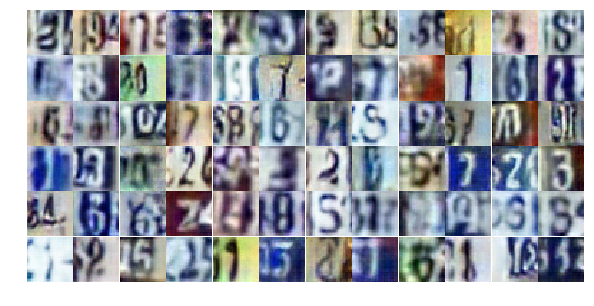

Epoch 15/30... Discriminator Loss: 0.6099... Generator Loss: 1.1954
Epoch 15/30... Discriminator Loss: 0.6044... Generator Loss: 1.7735
Epoch 15/30... Discriminator Loss: 0.9569... Generator Loss: 0.7481
Epoch 15/30... Discriminator Loss: 0.7401... Generator Loss: 0.9430
Epoch 15/30... Discriminator Loss: 0.8285... Generator Loss: 0.8946
Epoch 15/30... Discriminator Loss: 0.4738... Generator Loss: 1.4766
Epoch 15/30... Discriminator Loss: 1.2307... Generator Loss: 0.4634
Epoch 15/30... Discriminator Loss: 0.7407... Generator Loss: 0.9605
Epoch 15/30... Discriminator Loss: 0.4408... Generator Loss: 2.6466
Epoch 15/30... Discriminator Loss: 1.2604... Generator Loss: 0.5485


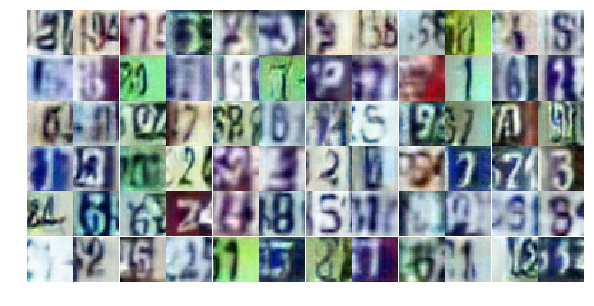

Epoch 15/30... Discriminator Loss: 1.0586... Generator Loss: 0.5974
Epoch 15/30... Discriminator Loss: 0.6368... Generator Loss: 1.0165
Epoch 15/30... Discriminator Loss: 0.6948... Generator Loss: 1.1025
Epoch 15/30... Discriminator Loss: 0.6071... Generator Loss: 1.2169
Epoch 15/30... Discriminator Loss: 1.1858... Generator Loss: 0.5237
Epoch 15/30... Discriminator Loss: 0.4800... Generator Loss: 1.6107
Epoch 15/30... Discriminator Loss: 1.0266... Generator Loss: 0.7742
Epoch 15/30... Discriminator Loss: 1.2020... Generator Loss: 0.5166
Epoch 15/30... Discriminator Loss: 0.7674... Generator Loss: 0.9136
Epoch 15/30... Discriminator Loss: 1.9901... Generator Loss: 0.3222


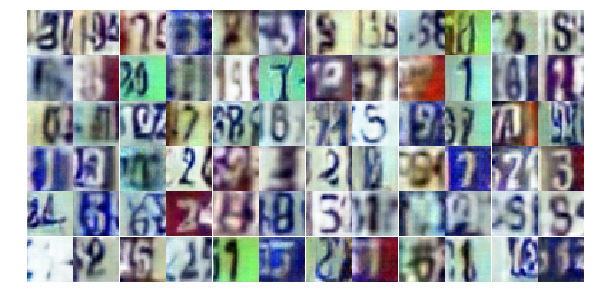

Epoch 15/30... Discriminator Loss: 3.8068... Generator Loss: 0.0595
Epoch 15/30... Discriminator Loss: 1.5657... Generator Loss: 0.4213
Epoch 15/30... Discriminator Loss: 0.4934... Generator Loss: 1.5214
Epoch 15/30... Discriminator Loss: 0.9181... Generator Loss: 0.8006
Epoch 15/30... Discriminator Loss: 0.6117... Generator Loss: 1.2236
Epoch 15/30... Discriminator Loss: 0.7042... Generator Loss: 1.7999
Epoch 15/30... Discriminator Loss: 0.5281... Generator Loss: 1.6125
Epoch 15/30... Discriminator Loss: 0.6194... Generator Loss: 1.0597
Epoch 15/30... Discriminator Loss: 0.6876... Generator Loss: 1.0038
Epoch 15/30... Discriminator Loss: 0.6801... Generator Loss: 1.3902


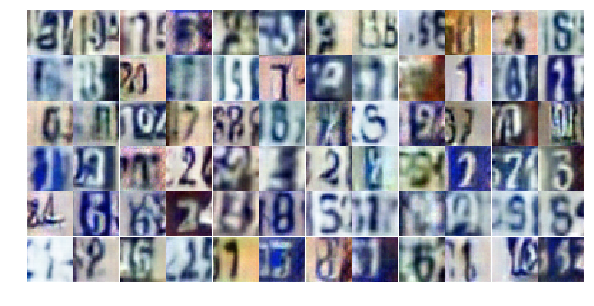

Epoch 15/30... Discriminator Loss: 0.5040... Generator Loss: 1.3998
Epoch 15/30... Discriminator Loss: 0.9574... Generator Loss: 0.7272
Epoch 15/30... Discriminator Loss: 0.7865... Generator Loss: 0.8775
Epoch 15/30... Discriminator Loss: 0.3910... Generator Loss: 1.6408
Epoch 15/30... Discriminator Loss: 0.5754... Generator Loss: 1.1076
Epoch 15/30... Discriminator Loss: 1.4002... Generator Loss: 0.4137
Epoch 15/30... Discriminator Loss: 0.5602... Generator Loss: 1.1440
Epoch 15/30... Discriminator Loss: 0.7832... Generator Loss: 0.8672
Epoch 15/30... Discriminator Loss: 0.6374... Generator Loss: 1.0537
Epoch 15/30... Discriminator Loss: 0.9326... Generator Loss: 0.7982


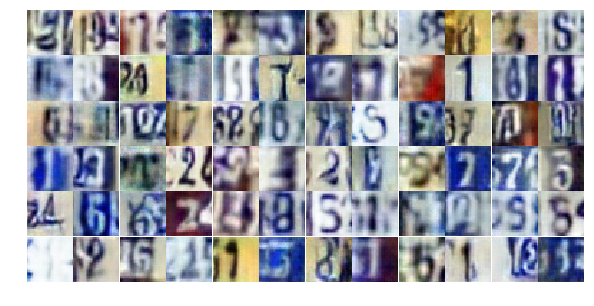

Epoch 15/30... Discriminator Loss: 0.7940... Generator Loss: 0.8216
Epoch 15/30... Discriminator Loss: 0.8261... Generator Loss: 0.8111
Epoch 15/30... Discriminator Loss: 0.5097... Generator Loss: 1.3229
Epoch 15/30... Discriminator Loss: 0.9135... Generator Loss: 0.7724
Epoch 15/30... Discriminator Loss: 0.5220... Generator Loss: 1.5580
Epoch 15/30... Discriminator Loss: 0.7526... Generator Loss: 1.7726
Epoch 15/30... Discriminator Loss: 0.6398... Generator Loss: 1.5190
Epoch 15/30... Discriminator Loss: 0.6999... Generator Loss: 1.0415
Epoch 15/30... Discriminator Loss: 1.9516... Generator Loss: 0.2190
Epoch 16/30... Discriminator Loss: 1.2907... Generator Loss: 0.4560


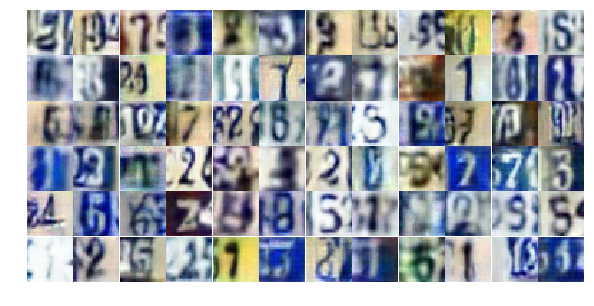

Epoch 16/30... Discriminator Loss: 0.5604... Generator Loss: 1.2223
Epoch 16/30... Discriminator Loss: 0.6897... Generator Loss: 0.9964
Epoch 16/30... Discriminator Loss: 1.4319... Generator Loss: 0.3868
Epoch 16/30... Discriminator Loss: 0.7118... Generator Loss: 1.0955
Epoch 16/30... Discriminator Loss: 0.6457... Generator Loss: 1.1780
Epoch 16/30... Discriminator Loss: 0.6035... Generator Loss: 1.1867
Epoch 16/30... Discriminator Loss: 2.0368... Generator Loss: 0.1956
Epoch 16/30... Discriminator Loss: 1.1804... Generator Loss: 0.5593
Epoch 16/30... Discriminator Loss: 0.3906... Generator Loss: 1.5134
Epoch 16/30... Discriminator Loss: 0.5633... Generator Loss: 1.3134


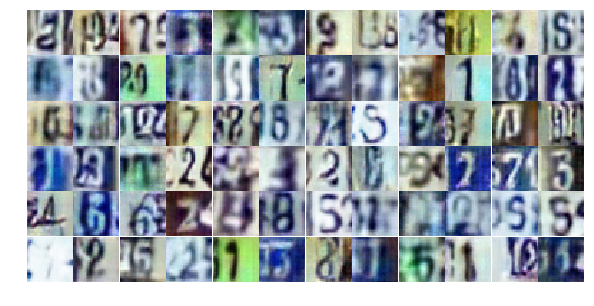

Epoch 16/30... Discriminator Loss: 1.2192... Generator Loss: 0.5584
Epoch 16/30... Discriminator Loss: 0.8805... Generator Loss: 0.7276
Epoch 16/30... Discriminator Loss: 0.7562... Generator Loss: 0.9184
Epoch 16/30... Discriminator Loss: 0.9043... Generator Loss: 0.7446
Epoch 16/30... Discriminator Loss: 0.4295... Generator Loss: 1.5265
Epoch 16/30... Discriminator Loss: 0.6488... Generator Loss: 1.0090
Epoch 16/30... Discriminator Loss: 1.0450... Generator Loss: 1.4110
Epoch 16/30... Discriminator Loss: 0.5956... Generator Loss: 1.5754
Epoch 16/30... Discriminator Loss: 0.5384... Generator Loss: 1.2663
Epoch 16/30... Discriminator Loss: 0.5634... Generator Loss: 1.3596


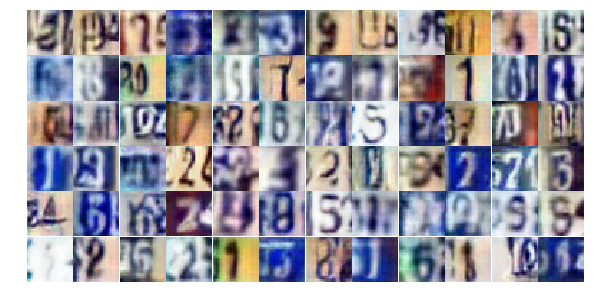

Epoch 16/30... Discriminator Loss: 0.7696... Generator Loss: 0.9575
Epoch 16/30... Discriminator Loss: 0.5510... Generator Loss: 1.3856
Epoch 16/30... Discriminator Loss: 0.6657... Generator Loss: 1.0389
Epoch 16/30... Discriminator Loss: 0.9684... Generator Loss: 0.7341
Epoch 16/30... Discriminator Loss: 0.7419... Generator Loss: 0.9639
Epoch 16/30... Discriminator Loss: 1.2348... Generator Loss: 0.5667
Epoch 16/30... Discriminator Loss: 0.6355... Generator Loss: 1.1177
Epoch 16/30... Discriminator Loss: 0.4976... Generator Loss: 1.2760
Epoch 16/30... Discriminator Loss: 1.2340... Generator Loss: 0.5307
Epoch 16/30... Discriminator Loss: 0.7243... Generator Loss: 0.8836


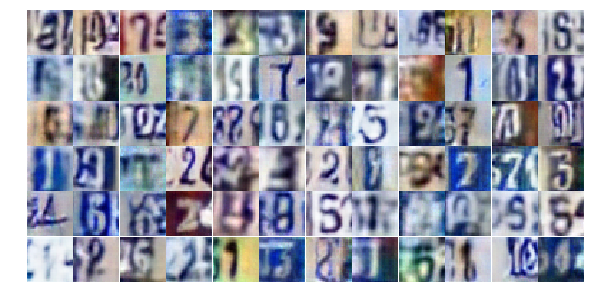

Epoch 16/30... Discriminator Loss: 0.6791... Generator Loss: 0.9473
Epoch 16/30... Discriminator Loss: 0.4038... Generator Loss: 1.7412
Epoch 16/30... Discriminator Loss: 0.7107... Generator Loss: 1.6190
Epoch 16/30... Discriminator Loss: 0.8752... Generator Loss: 0.7975
Epoch 16/30... Discriminator Loss: 0.9744... Generator Loss: 2.2269
Epoch 16/30... Discriminator Loss: 0.5904... Generator Loss: 1.4104
Epoch 16/30... Discriminator Loss: 0.8150... Generator Loss: 0.8114
Epoch 16/30... Discriminator Loss: 1.8921... Generator Loss: 0.2342
Epoch 16/30... Discriminator Loss: 1.8303... Generator Loss: 0.4005
Epoch 16/30... Discriminator Loss: 0.6314... Generator Loss: 1.1854


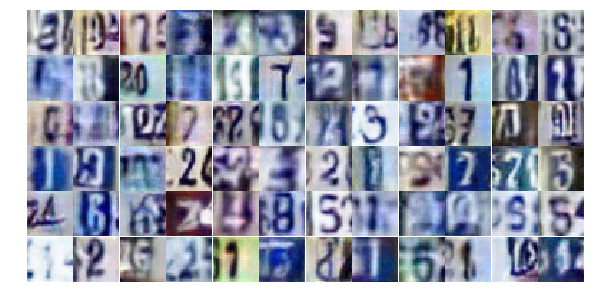

Epoch 16/30... Discriminator Loss: 0.7131... Generator Loss: 1.1839
Epoch 16/30... Discriminator Loss: 0.7406... Generator Loss: 0.9967
Epoch 16/30... Discriminator Loss: 1.0513... Generator Loss: 0.6042
Epoch 16/30... Discriminator Loss: 1.3745... Generator Loss: 0.6050
Epoch 16/30... Discriminator Loss: 0.8355... Generator Loss: 0.8764
Epoch 16/30... Discriminator Loss: 0.9291... Generator Loss: 0.8509
Epoch 16/30... Discriminator Loss: 0.5470... Generator Loss: 1.3098
Epoch 16/30... Discriminator Loss: 1.0596... Generator Loss: 0.6122
Epoch 16/30... Discriminator Loss: 0.5700... Generator Loss: 1.1848
Epoch 16/30... Discriminator Loss: 1.0184... Generator Loss: 0.6783


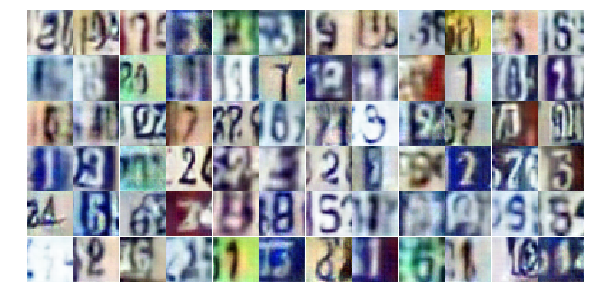

Epoch 16/30... Discriminator Loss: 0.9947... Generator Loss: 0.6797
Epoch 16/30... Discriminator Loss: 0.5928... Generator Loss: 1.9233
Epoch 16/30... Discriminator Loss: 1.0139... Generator Loss: 0.7694
Epoch 16/30... Discriminator Loss: 0.4379... Generator Loss: 1.4480
Epoch 16/30... Discriminator Loss: 0.6756... Generator Loss: 1.0836
Epoch 16/30... Discriminator Loss: 0.5643... Generator Loss: 1.3352
Epoch 17/30... Discriminator Loss: 0.6626... Generator Loss: 1.5272
Epoch 17/30... Discriminator Loss: 1.2184... Generator Loss: 0.5096
Epoch 17/30... Discriminator Loss: 0.5680... Generator Loss: 1.3177
Epoch 17/30... Discriminator Loss: 0.6493... Generator Loss: 1.2547


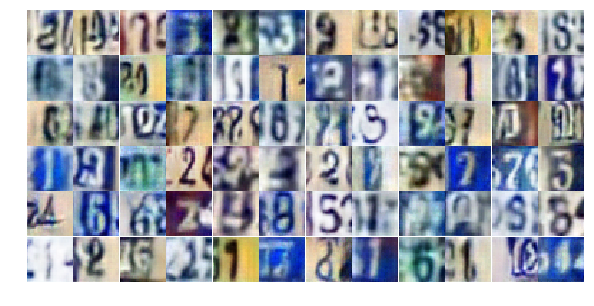

Epoch 17/30... Discriminator Loss: 0.5635... Generator Loss: 1.2206
Epoch 17/30... Discriminator Loss: 0.4603... Generator Loss: 1.6063
Epoch 17/30... Discriminator Loss: 0.6114... Generator Loss: 1.2922
Epoch 17/30... Discriminator Loss: 0.6713... Generator Loss: 0.9958
Epoch 17/30... Discriminator Loss: 0.8185... Generator Loss: 0.7911
Epoch 17/30... Discriminator Loss: 1.1059... Generator Loss: 0.6401
Epoch 17/30... Discriminator Loss: 0.7644... Generator Loss: 0.9419
Epoch 17/30... Discriminator Loss: 0.5710... Generator Loss: 1.2200
Epoch 17/30... Discriminator Loss: 0.3599... Generator Loss: 1.7550
Epoch 17/30... Discriminator Loss: 0.5969... Generator Loss: 1.3644


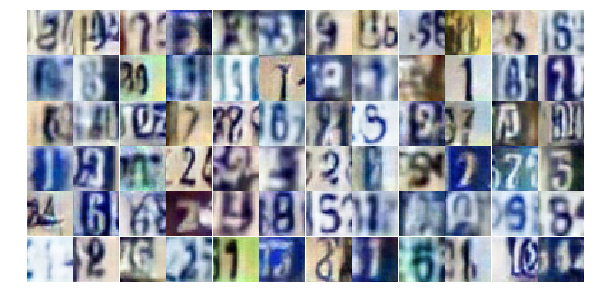

Epoch 17/30... Discriminator Loss: 1.2628... Generator Loss: 0.4634
Epoch 17/30... Discriminator Loss: 1.3670... Generator Loss: 3.8863
Epoch 17/30... Discriminator Loss: 0.8370... Generator Loss: 0.7948
Epoch 17/30... Discriminator Loss: 1.0879... Generator Loss: 0.6602
Epoch 17/30... Discriminator Loss: 0.7076... Generator Loss: 2.0271
Epoch 17/30... Discriminator Loss: 0.7621... Generator Loss: 0.9171
Epoch 17/30... Discriminator Loss: 0.5646... Generator Loss: 1.3076
Epoch 17/30... Discriminator Loss: 0.6442... Generator Loss: 1.1245
Epoch 17/30... Discriminator Loss: 0.8748... Generator Loss: 0.7265
Epoch 17/30... Discriminator Loss: 0.5682... Generator Loss: 1.2056


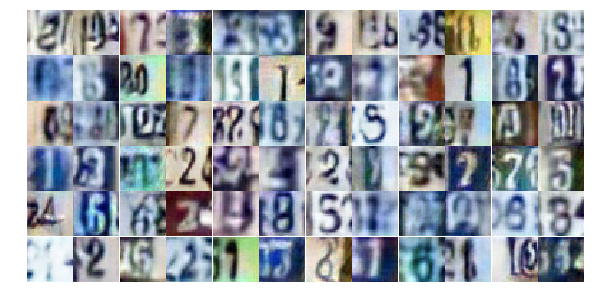

Epoch 17/30... Discriminator Loss: 1.8448... Generator Loss: 0.2874
Epoch 17/30... Discriminator Loss: 0.5241... Generator Loss: 1.4138
Epoch 17/30... Discriminator Loss: 0.5132... Generator Loss: 1.2007
Epoch 17/30... Discriminator Loss: 1.1831... Generator Loss: 0.5379
Epoch 17/30... Discriminator Loss: 1.5832... Generator Loss: 0.3762
Epoch 17/30... Discriminator Loss: 0.6157... Generator Loss: 1.0978
Epoch 17/30... Discriminator Loss: 0.7989... Generator Loss: 0.8371
Epoch 17/30... Discriminator Loss: 0.7969... Generator Loss: 0.8993
Epoch 17/30... Discriminator Loss: 0.9922... Generator Loss: 0.7371
Epoch 17/30... Discriminator Loss: 0.3669... Generator Loss: 1.9739


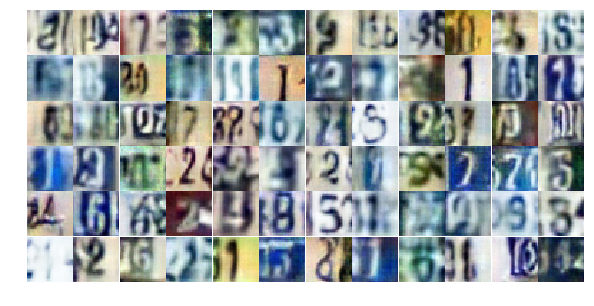

Epoch 17/30... Discriminator Loss: 0.6308... Generator Loss: 1.2807
Epoch 17/30... Discriminator Loss: 0.8304... Generator Loss: 0.9407
Epoch 17/30... Discriminator Loss: 0.5767... Generator Loss: 1.6407
Epoch 17/30... Discriminator Loss: 0.8808... Generator Loss: 1.0970
Epoch 17/30... Discriminator Loss: 1.0735... Generator Loss: 0.5802
Epoch 17/30... Discriminator Loss: 0.6050... Generator Loss: 1.2301
Epoch 17/30... Discriminator Loss: 0.5633... Generator Loss: 1.4546
Epoch 17/30... Discriminator Loss: 0.3908... Generator Loss: 1.5692
Epoch 17/30... Discriminator Loss: 0.3555... Generator Loss: 1.7002
Epoch 17/30... Discriminator Loss: 1.2410... Generator Loss: 0.4980


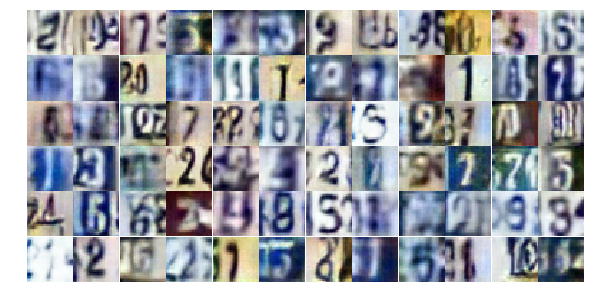

Epoch 17/30... Discriminator Loss: 1.5277... Generator Loss: 2.5113
Epoch 17/30... Discriminator Loss: 0.4400... Generator Loss: 1.4663
Epoch 17/30... Discriminator Loss: 1.4786... Generator Loss: 0.3864
Epoch 17/30... Discriminator Loss: 0.6016... Generator Loss: 1.0755
Epoch 17/30... Discriminator Loss: 0.6797... Generator Loss: 1.1587
Epoch 17/30... Discriminator Loss: 0.9721... Generator Loss: 0.7139
Epoch 17/30... Discriminator Loss: 1.4731... Generator Loss: 0.3774
Epoch 17/30... Discriminator Loss: 0.5476... Generator Loss: 1.5738
Epoch 17/30... Discriminator Loss: 0.6722... Generator Loss: 1.0764
Epoch 17/30... Discriminator Loss: 1.5043... Generator Loss: 0.3936


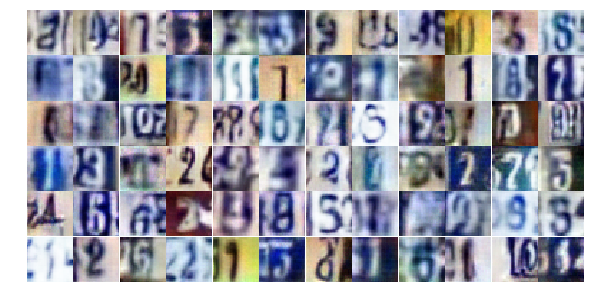

Epoch 17/30... Discriminator Loss: 1.4899... Generator Loss: 3.2665
Epoch 17/30... Discriminator Loss: 1.0295... Generator Loss: 2.3026
Epoch 17/30... Discriminator Loss: 0.6578... Generator Loss: 1.2060
Epoch 17/30... Discriminator Loss: 0.9199... Generator Loss: 0.7473
Epoch 18/30... Discriminator Loss: 1.1554... Generator Loss: 0.6073
Epoch 18/30... Discriminator Loss: 0.8545... Generator Loss: 0.8838
Epoch 18/30... Discriminator Loss: 0.8709... Generator Loss: 0.8592
Epoch 18/30... Discriminator Loss: 0.8347... Generator Loss: 0.7853
Epoch 18/30... Discriminator Loss: 1.4296... Generator Loss: 0.3991
Epoch 18/30... Discriminator Loss: 0.7930... Generator Loss: 0.8633


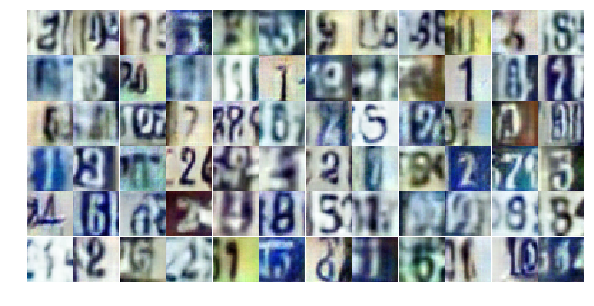

Epoch 18/30... Discriminator Loss: 0.4218... Generator Loss: 1.8586
Epoch 18/30... Discriminator Loss: 1.1417... Generator Loss: 0.5427
Epoch 18/30... Discriminator Loss: 1.0167... Generator Loss: 0.6185
Epoch 18/30... Discriminator Loss: 0.4966... Generator Loss: 1.5755
Epoch 18/30... Discriminator Loss: 0.7076... Generator Loss: 0.9549
Epoch 18/30... Discriminator Loss: 1.1285... Generator Loss: 0.6142
Epoch 18/30... Discriminator Loss: 0.6017... Generator Loss: 1.2021
Epoch 18/30... Discriminator Loss: 0.8502... Generator Loss: 0.8027
Epoch 18/30... Discriminator Loss: 0.8033... Generator Loss: 0.8537
Epoch 18/30... Discriminator Loss: 0.4221... Generator Loss: 1.3622


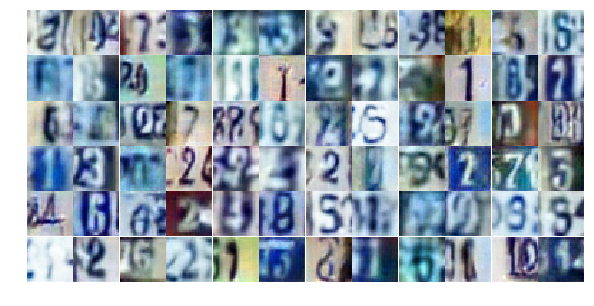

Epoch 18/30... Discriminator Loss: 0.7753... Generator Loss: 0.9629
Epoch 18/30... Discriminator Loss: 0.4990... Generator Loss: 1.7113
Epoch 18/30... Discriminator Loss: 1.2062... Generator Loss: 0.5651
Epoch 18/30... Discriminator Loss: 0.5198... Generator Loss: 1.3474
Epoch 18/30... Discriminator Loss: 0.7686... Generator Loss: 0.8909
Epoch 18/30... Discriminator Loss: 1.1439... Generator Loss: 0.5839
Epoch 18/30... Discriminator Loss: 0.7716... Generator Loss: 0.9960
Epoch 18/30... Discriminator Loss: 0.9378... Generator Loss: 0.7084
Epoch 18/30... Discriminator Loss: 0.8044... Generator Loss: 0.8777
Epoch 18/30... Discriminator Loss: 0.6312... Generator Loss: 1.1221


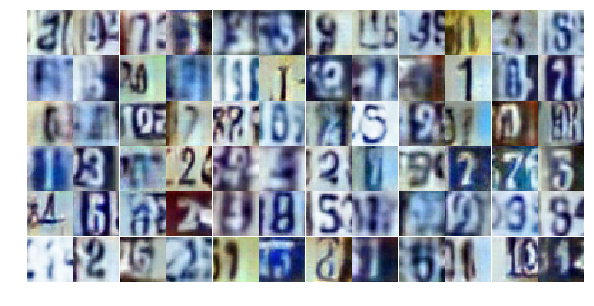

Epoch 18/30... Discriminator Loss: 0.4341... Generator Loss: 1.7154
Epoch 18/30... Discriminator Loss: 0.6776... Generator Loss: 1.1184
Epoch 18/30... Discriminator Loss: 0.6412... Generator Loss: 1.0958
Epoch 18/30... Discriminator Loss: 0.6799... Generator Loss: 1.0216
Epoch 18/30... Discriminator Loss: 0.5904... Generator Loss: 1.1769
Epoch 18/30... Discriminator Loss: 0.6403... Generator Loss: 1.0967
Epoch 18/30... Discriminator Loss: 0.6699... Generator Loss: 1.1311
Epoch 18/30... Discriminator Loss: 0.6866... Generator Loss: 1.0493
Epoch 18/30... Discriminator Loss: 0.5872... Generator Loss: 1.3852
Epoch 18/30... Discriminator Loss: 0.7617... Generator Loss: 1.0757


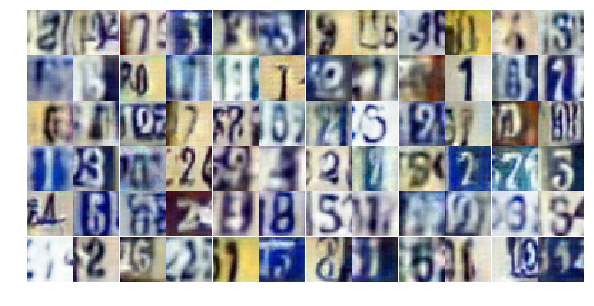

Epoch 18/30... Discriminator Loss: 0.5563... Generator Loss: 1.2020
Epoch 18/30... Discriminator Loss: 0.6975... Generator Loss: 1.0995
Epoch 18/30... Discriminator Loss: 0.7000... Generator Loss: 0.9909
Epoch 18/30... Discriminator Loss: 0.5595... Generator Loss: 3.7937
Epoch 18/30... Discriminator Loss: 2.8469... Generator Loss: 4.2737
Epoch 18/30... Discriminator Loss: 1.0904... Generator Loss: 0.6608
Epoch 18/30... Discriminator Loss: 0.9067... Generator Loss: 0.7993
Epoch 18/30... Discriminator Loss: 1.0868... Generator Loss: 0.6893
Epoch 18/30... Discriminator Loss: 0.6801... Generator Loss: 1.0573
Epoch 18/30... Discriminator Loss: 0.4018... Generator Loss: 1.5877


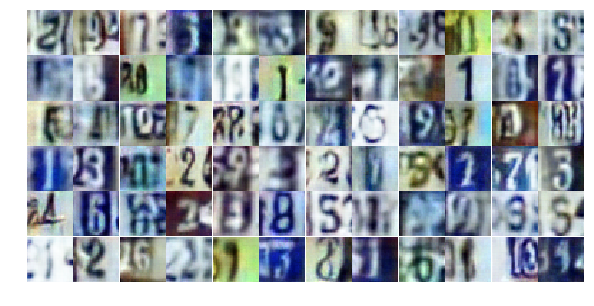

Epoch 18/30... Discriminator Loss: 0.5147... Generator Loss: 1.3588
Epoch 18/30... Discriminator Loss: 0.8073... Generator Loss: 0.9422
Epoch 18/30... Discriminator Loss: 0.7606... Generator Loss: 0.9173
Epoch 18/30... Discriminator Loss: 1.1337... Generator Loss: 0.5588
Epoch 18/30... Discriminator Loss: 0.7996... Generator Loss: 0.8647
Epoch 18/30... Discriminator Loss: 0.6590... Generator Loss: 1.0146
Epoch 18/30... Discriminator Loss: 0.5628... Generator Loss: 1.2526
Epoch 18/30... Discriminator Loss: 0.3776... Generator Loss: 1.5955
Epoch 18/30... Discriminator Loss: 1.0683... Generator Loss: 0.6567
Epoch 18/30... Discriminator Loss: 0.5699... Generator Loss: 1.1330


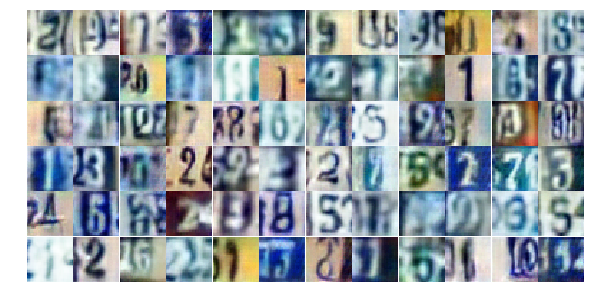

Epoch 18/30... Discriminator Loss: 0.5668... Generator Loss: 2.3038
Epoch 19/30... Discriminator Loss: 0.8224... Generator Loss: 1.2319
Epoch 19/30... Discriminator Loss: 1.3298... Generator Loss: 0.4612
Epoch 19/30... Discriminator Loss: 0.7966... Generator Loss: 1.0172
Epoch 19/30... Discriminator Loss: 0.5488... Generator Loss: 1.1769
Epoch 19/30... Discriminator Loss: 1.1849... Generator Loss: 0.5209
Epoch 19/30... Discriminator Loss: 0.4657... Generator Loss: 1.4631
Epoch 19/30... Discriminator Loss: 0.9053... Generator Loss: 0.7851
Epoch 19/30... Discriminator Loss: 0.5649... Generator Loss: 2.3660
Epoch 19/30... Discriminator Loss: 0.8361... Generator Loss: 0.8345


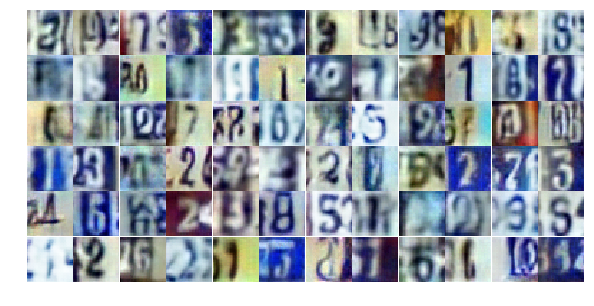

Epoch 19/30... Discriminator Loss: 0.6714... Generator Loss: 1.0160
Epoch 19/30... Discriminator Loss: 0.7531... Generator Loss: 0.9681
Epoch 19/30... Discriminator Loss: 0.5171... Generator Loss: 1.4575
Epoch 19/30... Discriminator Loss: 1.3622... Generator Loss: 0.4461
Epoch 19/30... Discriminator Loss: 0.9401... Generator Loss: 0.8619
Epoch 19/30... Discriminator Loss: 0.7515... Generator Loss: 0.8952
Epoch 19/30... Discriminator Loss: 1.2925... Generator Loss: 0.4693
Epoch 19/30... Discriminator Loss: 0.5426... Generator Loss: 1.1761
Epoch 19/30... Discriminator Loss: 0.7113... Generator Loss: 1.0934
Epoch 19/30... Discriminator Loss: 1.0600... Generator Loss: 0.6366


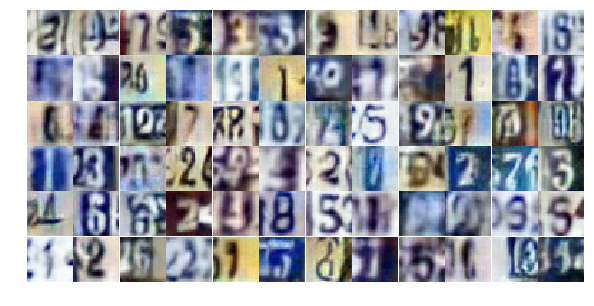

Epoch 19/30... Discriminator Loss: 0.5033... Generator Loss: 1.2730
Epoch 19/30... Discriminator Loss: 1.3710... Generator Loss: 0.4333
Epoch 19/30... Discriminator Loss: 0.9531... Generator Loss: 0.9258
Epoch 19/30... Discriminator Loss: 0.8800... Generator Loss: 0.8513
Epoch 19/30... Discriminator Loss: 1.2256... Generator Loss: 0.5052
Epoch 19/30... Discriminator Loss: 0.9731... Generator Loss: 0.7051
Epoch 19/30... Discriminator Loss: 0.7564... Generator Loss: 0.9327
Epoch 19/30... Discriminator Loss: 0.6664... Generator Loss: 1.0003
Epoch 19/30... Discriminator Loss: 0.8013... Generator Loss: 0.8475
Epoch 19/30... Discriminator Loss: 0.9740... Generator Loss: 0.7573


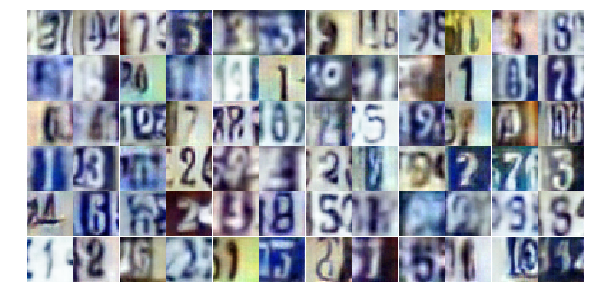

Epoch 19/30... Discriminator Loss: 1.0800... Generator Loss: 0.6164
Epoch 19/30... Discriminator Loss: 0.6324... Generator Loss: 1.0584
Epoch 19/30... Discriminator Loss: 0.9434... Generator Loss: 0.7200
Epoch 19/30... Discriminator Loss: 0.4357... Generator Loss: 1.4612
Epoch 19/30... Discriminator Loss: 0.7680... Generator Loss: 0.9806
Epoch 19/30... Discriminator Loss: 1.5899... Generator Loss: 0.3162
Epoch 19/30... Discriminator Loss: 0.8578... Generator Loss: 0.8504
Epoch 19/30... Discriminator Loss: 0.4775... Generator Loss: 1.5018
Epoch 19/30... Discriminator Loss: 0.8593... Generator Loss: 0.7485
Epoch 19/30... Discriminator Loss: 0.8927... Generator Loss: 0.6773


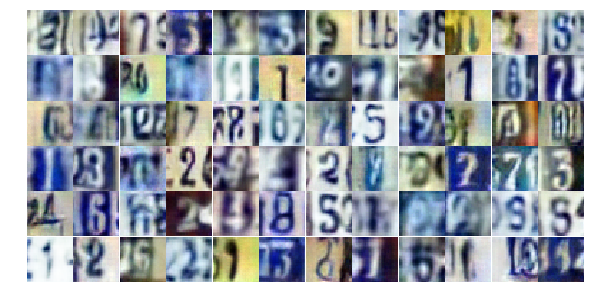

Epoch 19/30... Discriminator Loss: 0.7494... Generator Loss: 0.8129
Epoch 19/30... Discriminator Loss: 0.8686... Generator Loss: 2.2058
Epoch 19/30... Discriminator Loss: 0.8066... Generator Loss: 0.8285
Epoch 19/30... Discriminator Loss: 0.6186... Generator Loss: 1.1445
Epoch 19/30... Discriminator Loss: 0.7446... Generator Loss: 1.2708
Epoch 19/30... Discriminator Loss: 1.4354... Generator Loss: 0.5098
Epoch 19/30... Discriminator Loss: 0.6986... Generator Loss: 1.1482
Epoch 19/30... Discriminator Loss: 0.4034... Generator Loss: 1.8486
Epoch 19/30... Discriminator Loss: 0.8524... Generator Loss: 0.7828
Epoch 19/30... Discriminator Loss: 0.6347... Generator Loss: 1.2870


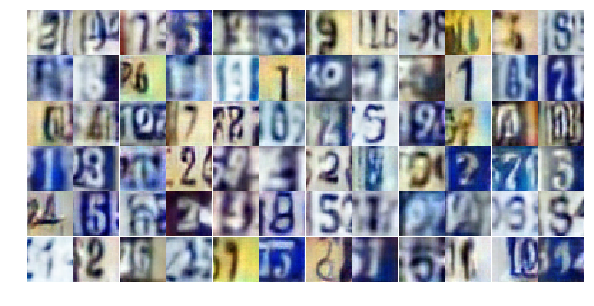

Epoch 19/30... Discriminator Loss: 1.4914... Generator Loss: 0.4045
Epoch 19/30... Discriminator Loss: 0.7925... Generator Loss: 0.9214
Epoch 19/30... Discriminator Loss: 0.7578... Generator Loss: 2.2585
Epoch 19/30... Discriminator Loss: 1.0160... Generator Loss: 1.3701
Epoch 19/30... Discriminator Loss: 0.7420... Generator Loss: 1.2364
Epoch 19/30... Discriminator Loss: 0.5601... Generator Loss: 1.4876
Epoch 19/30... Discriminator Loss: 1.4387... Generator Loss: 0.4329
Epoch 19/30... Discriminator Loss: 0.6056... Generator Loss: 1.2122
Epoch 20/30... Discriminator Loss: 0.6586... Generator Loss: 1.1129
Epoch 20/30... Discriminator Loss: 0.7025... Generator Loss: 0.9551


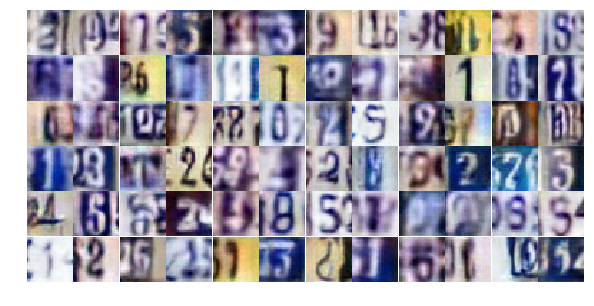

Epoch 20/30... Discriminator Loss: 0.5286... Generator Loss: 1.2564
Epoch 20/30... Discriminator Loss: 0.6636... Generator Loss: 1.2075
Epoch 20/30... Discriminator Loss: 1.3947... Generator Loss: 0.4407
Epoch 20/30... Discriminator Loss: 0.8856... Generator Loss: 0.7620
Epoch 20/30... Discriminator Loss: 0.5283... Generator Loss: 1.2807
Epoch 20/30... Discriminator Loss: 0.4615... Generator Loss: 1.3321
Epoch 20/30... Discriminator Loss: 0.8774... Generator Loss: 0.8997
Epoch 20/30... Discriminator Loss: 0.7633... Generator Loss: 1.6350
Epoch 20/30... Discriminator Loss: 1.5936... Generator Loss: 0.3443
Epoch 20/30... Discriminator Loss: 0.8952... Generator Loss: 0.7423


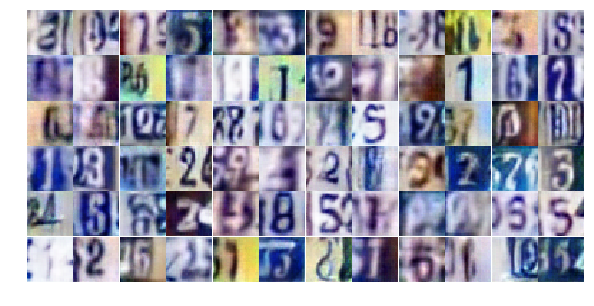

Epoch 20/30... Discriminator Loss: 1.1010... Generator Loss: 0.6234
Epoch 20/30... Discriminator Loss: 1.0827... Generator Loss: 0.5924
Epoch 20/30... Discriminator Loss: 0.6397... Generator Loss: 1.1672
Epoch 20/30... Discriminator Loss: 0.6831... Generator Loss: 1.2617
Epoch 20/30... Discriminator Loss: 1.2268... Generator Loss: 0.5428
Epoch 20/30... Discriminator Loss: 1.3934... Generator Loss: 1.3839
Epoch 20/30... Discriminator Loss: 1.0208... Generator Loss: 0.7168
Epoch 20/30... Discriminator Loss: 0.6831... Generator Loss: 1.1102
Epoch 20/30... Discriminator Loss: 0.6766... Generator Loss: 1.0790
Epoch 20/30... Discriminator Loss: 1.0227... Generator Loss: 0.6714


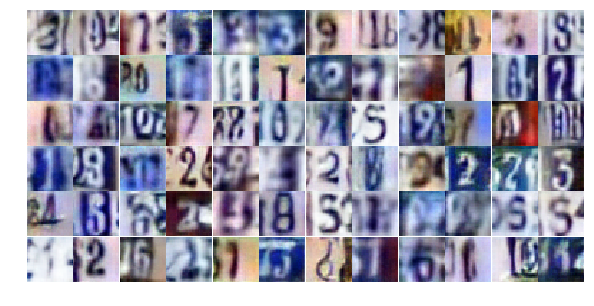

Epoch 20/30... Discriminator Loss: 0.9525... Generator Loss: 0.7036
Epoch 20/30... Discriminator Loss: 0.5924... Generator Loss: 1.3053
Epoch 20/30... Discriminator Loss: 0.2553... Generator Loss: 1.9956
Epoch 20/30... Discriminator Loss: 1.6686... Generator Loss: 0.3560
Epoch 20/30... Discriminator Loss: 0.8522... Generator Loss: 0.8935
Epoch 20/30... Discriminator Loss: 0.3779... Generator Loss: 1.7693
Epoch 20/30... Discriminator Loss: 0.6372... Generator Loss: 1.3158
Epoch 20/30... Discriminator Loss: 1.7884... Generator Loss: 0.2625
Epoch 20/30... Discriminator Loss: 0.9440... Generator Loss: 0.7002
Epoch 20/30... Discriminator Loss: 0.5632... Generator Loss: 1.1603


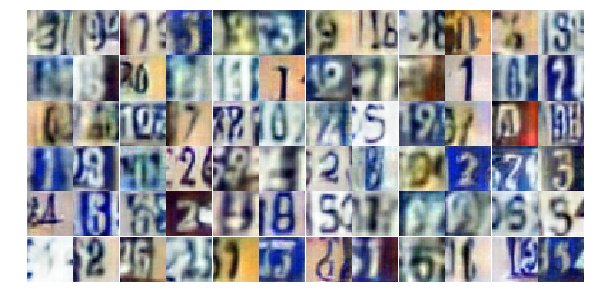

Epoch 20/30... Discriminator Loss: 0.8376... Generator Loss: 0.7934
Epoch 20/30... Discriminator Loss: 0.3956... Generator Loss: 1.4461
Epoch 20/30... Discriminator Loss: 1.3583... Generator Loss: 0.5270
Epoch 20/30... Discriminator Loss: 0.8893... Generator Loss: 0.7764
Epoch 20/30... Discriminator Loss: 1.1768... Generator Loss: 0.5557
Epoch 20/30... Discriminator Loss: 0.6957... Generator Loss: 1.2677
Epoch 20/30... Discriminator Loss: 0.7329... Generator Loss: 1.0154
Epoch 20/30... Discriminator Loss: 0.9161... Generator Loss: 0.9514
Epoch 20/30... Discriminator Loss: 0.6947... Generator Loss: 1.1598
Epoch 20/30... Discriminator Loss: 0.8402... Generator Loss: 0.8302


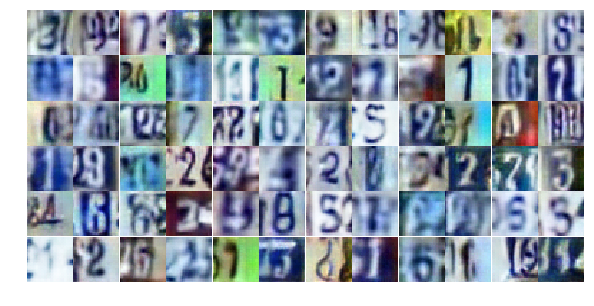

Epoch 20/30... Discriminator Loss: 0.5038... Generator Loss: 1.3726
Epoch 20/30... Discriminator Loss: 0.9870... Generator Loss: 0.6542
Epoch 20/30... Discriminator Loss: 0.4898... Generator Loss: 1.5171
Epoch 20/30... Discriminator Loss: 0.7780... Generator Loss: 0.9189
Epoch 20/30... Discriminator Loss: 0.7017... Generator Loss: 1.0464
Epoch 20/30... Discriminator Loss: 0.7258... Generator Loss: 0.9743
Epoch 20/30... Discriminator Loss: 1.3852... Generator Loss: 0.4192
Epoch 20/30... Discriminator Loss: 0.3958... Generator Loss: 1.6791
Epoch 20/30... Discriminator Loss: 0.4783... Generator Loss: 1.5080
Epoch 20/30... Discriminator Loss: 0.5280... Generator Loss: 1.2873


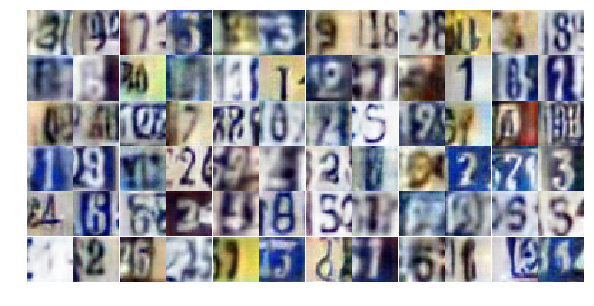

Epoch 20/30... Discriminator Loss: 0.3877... Generator Loss: 1.7219
Epoch 20/30... Discriminator Loss: 0.8659... Generator Loss: 2.8329
Epoch 20/30... Discriminator Loss: 0.4933... Generator Loss: 1.3395
Epoch 20/30... Discriminator Loss: 0.9460... Generator Loss: 0.7460
Epoch 20/30... Discriminator Loss: 0.5290... Generator Loss: 1.3477
Epoch 20/30... Discriminator Loss: 0.3710... Generator Loss: 1.7764
Epoch 21/30... Discriminator Loss: 0.9860... Generator Loss: 0.7101
Epoch 21/30... Discriminator Loss: 0.6513... Generator Loss: 1.0302
Epoch 21/30... Discriminator Loss: 1.4442... Generator Loss: 0.4185
Epoch 21/30... Discriminator Loss: 1.1997... Generator Loss: 0.5520


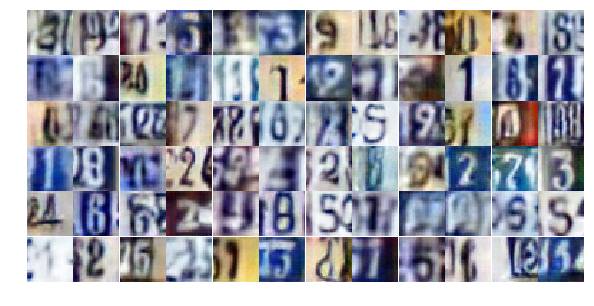

Epoch 21/30... Discriminator Loss: 0.5713... Generator Loss: 1.5580
Epoch 21/30... Discriminator Loss: 1.4931... Generator Loss: 0.4397
Epoch 21/30... Discriminator Loss: 0.5297... Generator Loss: 1.3276
Epoch 21/30... Discriminator Loss: 0.5034... Generator Loss: 1.1908
Epoch 21/30... Discriminator Loss: 0.5858... Generator Loss: 1.1658
Epoch 21/30... Discriminator Loss: 0.5656... Generator Loss: 1.1733
Epoch 21/30... Discriminator Loss: 1.2499... Generator Loss: 0.4767
Epoch 21/30... Discriminator Loss: 1.1927... Generator Loss: 0.5289
Epoch 21/30... Discriminator Loss: 0.6609... Generator Loss: 1.0706
Epoch 21/30... Discriminator Loss: 0.8185... Generator Loss: 1.0505


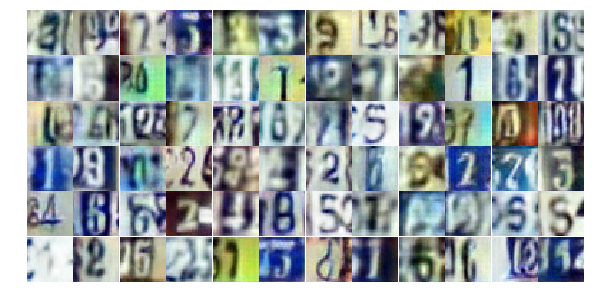

Epoch 21/30... Discriminator Loss: 0.2364... Generator Loss: 2.2713
Epoch 21/30... Discriminator Loss: 1.5032... Generator Loss: 0.4682
Epoch 21/30... Discriminator Loss: 1.7384... Generator Loss: 0.4315
Epoch 21/30... Discriminator Loss: 0.5211... Generator Loss: 1.5164
Epoch 21/30... Discriminator Loss: 0.6018... Generator Loss: 1.3212
Epoch 21/30... Discriminator Loss: 0.9598... Generator Loss: 0.6941
Epoch 21/30... Discriminator Loss: 1.0314... Generator Loss: 0.6668
Epoch 21/30... Discriminator Loss: 0.5894... Generator Loss: 1.1225
Epoch 21/30... Discriminator Loss: 0.4794... Generator Loss: 1.3566
Epoch 21/30... Discriminator Loss: 0.7732... Generator Loss: 0.9395


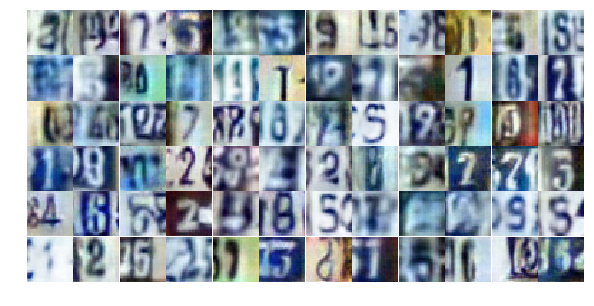

Epoch 21/30... Discriminator Loss: 0.9581... Generator Loss: 0.9430
Epoch 21/30... Discriminator Loss: 0.2921... Generator Loss: 2.1225
Epoch 21/30... Discriminator Loss: 0.9683... Generator Loss: 0.6933
Epoch 21/30... Discriminator Loss: 0.8243... Generator Loss: 0.8205
Epoch 21/30... Discriminator Loss: 0.6690... Generator Loss: 1.0070
Epoch 21/30... Discriminator Loss: 0.8224... Generator Loss: 0.9398
Epoch 21/30... Discriminator Loss: 0.5203... Generator Loss: 1.3201
Epoch 21/30... Discriminator Loss: 0.9327... Generator Loss: 0.7002
Epoch 21/30... Discriminator Loss: 1.6452... Generator Loss: 0.3737
Epoch 21/30... Discriminator Loss: 1.7101... Generator Loss: 0.3868


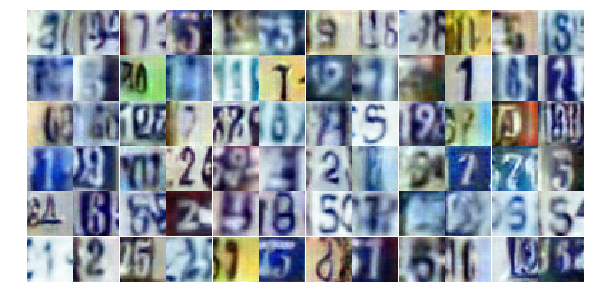

Epoch 21/30... Discriminator Loss: 1.0968... Generator Loss: 0.5647
Epoch 21/30... Discriminator Loss: 0.5486... Generator Loss: 1.3269
Epoch 21/30... Discriminator Loss: 1.4681... Generator Loss: 0.3614
Epoch 21/30... Discriminator Loss: 0.6961... Generator Loss: 0.9754
Epoch 21/30... Discriminator Loss: 0.6153... Generator Loss: 1.0759
Epoch 21/30... Discriminator Loss: 0.8279... Generator Loss: 0.8671
Epoch 21/30... Discriminator Loss: 1.0396... Generator Loss: 0.6711
Epoch 21/30... Discriminator Loss: 1.7437... Generator Loss: 0.3129
Epoch 21/30... Discriminator Loss: 0.8398... Generator Loss: 0.8341
Epoch 21/30... Discriminator Loss: 0.3033... Generator Loss: 2.3855


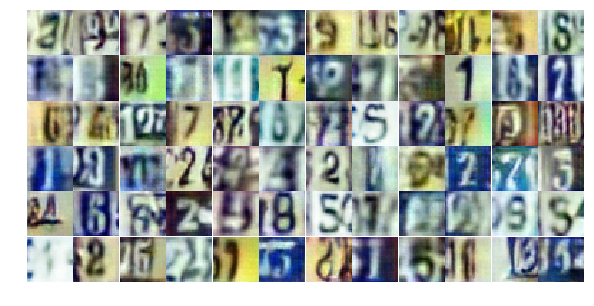

Epoch 21/30... Discriminator Loss: 0.8683... Generator Loss: 0.8453
Epoch 21/30... Discriminator Loss: 0.8211... Generator Loss: 0.9554
Epoch 21/30... Discriminator Loss: 0.6140... Generator Loss: 1.2013
Epoch 21/30... Discriminator Loss: 0.7543... Generator Loss: 1.2863
Epoch 21/30... Discriminator Loss: 0.3424... Generator Loss: 1.8424
Epoch 21/30... Discriminator Loss: 0.8423... Generator Loss: 0.8042
Epoch 21/30... Discriminator Loss: 0.7690... Generator Loss: 0.9567
Epoch 21/30... Discriminator Loss: 1.7233... Generator Loss: 0.4447
Epoch 21/30... Discriminator Loss: 1.7798... Generator Loss: 0.4509
Epoch 21/30... Discriminator Loss: 0.6867... Generator Loss: 1.1688


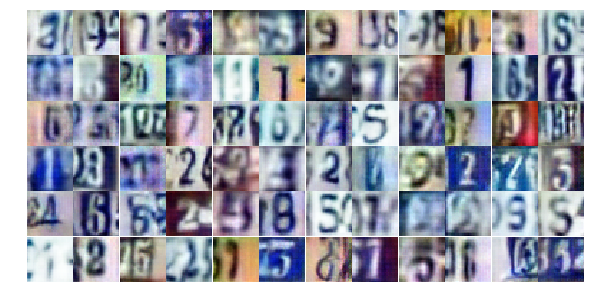

Epoch 21/30... Discriminator Loss: 0.6255... Generator Loss: 1.1865
Epoch 21/30... Discriminator Loss: 0.7260... Generator Loss: 0.9402
Epoch 21/30... Discriminator Loss: 0.6353... Generator Loss: 1.3464
Epoch 22/30... Discriminator Loss: 1.1025... Generator Loss: 0.7207
Epoch 22/30... Discriminator Loss: 0.8856... Generator Loss: 0.8022
Epoch 22/30... Discriminator Loss: 0.6727... Generator Loss: 1.1109
Epoch 22/30... Discriminator Loss: 0.5137... Generator Loss: 1.4529
Epoch 22/30... Discriminator Loss: 0.4977... Generator Loss: 1.2819
Epoch 22/30... Discriminator Loss: 0.7653... Generator Loss: 0.9892
Epoch 22/30... Discriminator Loss: 0.9742... Generator Loss: 0.7283


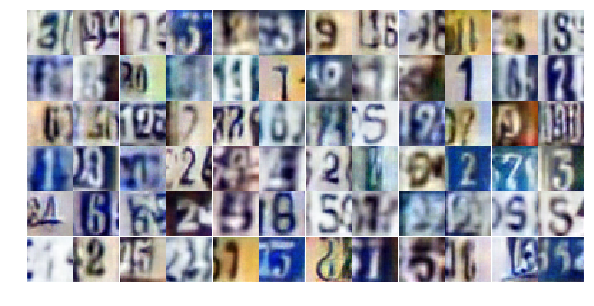

Epoch 22/30... Discriminator Loss: 0.5383... Generator Loss: 1.7564
Epoch 22/30... Discriminator Loss: 0.8817... Generator Loss: 0.8546
Epoch 22/30... Discriminator Loss: 1.4419... Generator Loss: 0.4330
Epoch 22/30... Discriminator Loss: 0.6205... Generator Loss: 1.0667
Epoch 22/30... Discriminator Loss: 0.6897... Generator Loss: 1.0609
Epoch 22/30... Discriminator Loss: 0.5400... Generator Loss: 1.2833
Epoch 22/30... Discriminator Loss: 0.7128... Generator Loss: 0.9354
Epoch 22/30... Discriminator Loss: 0.3813... Generator Loss: 1.8202
Epoch 22/30... Discriminator Loss: 1.2756... Generator Loss: 0.4991
Epoch 22/30... Discriminator Loss: 2.1018... Generator Loss: 0.2671


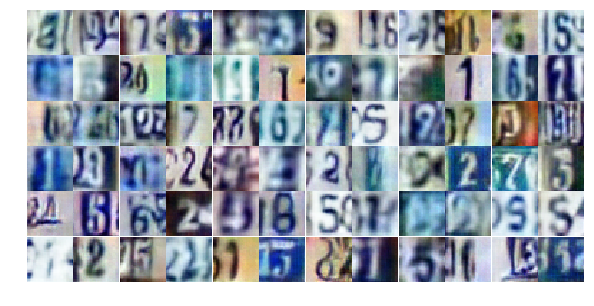

Epoch 22/30... Discriminator Loss: 1.2166... Generator Loss: 4.0396
Epoch 22/30... Discriminator Loss: 0.7562... Generator Loss: 0.9115
Epoch 22/30... Discriminator Loss: 0.9453... Generator Loss: 0.6924
Epoch 22/30... Discriminator Loss: 0.4782... Generator Loss: 1.6758
Epoch 22/30... Discriminator Loss: 0.4651... Generator Loss: 1.4489
Epoch 22/30... Discriminator Loss: 0.9665... Generator Loss: 0.7502
Epoch 22/30... Discriminator Loss: 0.6370... Generator Loss: 1.0454
Epoch 22/30... Discriminator Loss: 0.4845... Generator Loss: 1.3021
Epoch 22/30... Discriminator Loss: 0.6009... Generator Loss: 1.0971
Epoch 22/30... Discriminator Loss: 1.0017... Generator Loss: 0.6754


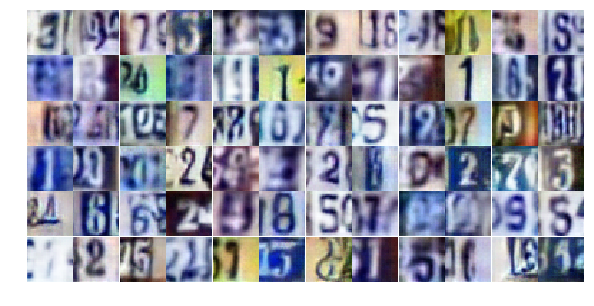

Epoch 22/30... Discriminator Loss: 0.3988... Generator Loss: 2.0161
Epoch 22/30... Discriminator Loss: 0.4747... Generator Loss: 1.6213
Epoch 22/30... Discriminator Loss: 0.8177... Generator Loss: 0.8776
Epoch 22/30... Discriminator Loss: 0.9052... Generator Loss: 0.8121
Epoch 22/30... Discriminator Loss: 0.8180... Generator Loss: 0.9496
Epoch 22/30... Discriminator Loss: 0.8258... Generator Loss: 0.8399
Epoch 22/30... Discriminator Loss: 1.3352... Generator Loss: 0.5177
Epoch 22/30... Discriminator Loss: 2.0634... Generator Loss: 3.8897
Epoch 22/30... Discriminator Loss: 0.7594... Generator Loss: 1.6924
Epoch 22/30... Discriminator Loss: 1.3032... Generator Loss: 0.4675


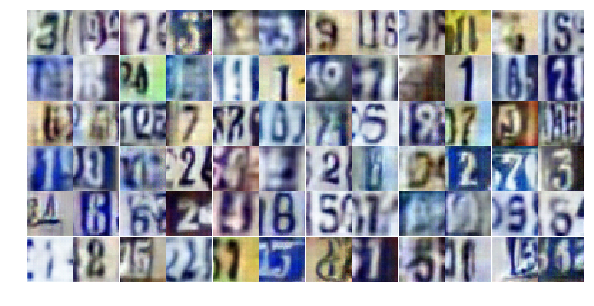

Epoch 22/30... Discriminator Loss: 0.8252... Generator Loss: 0.9274
Epoch 22/30... Discriminator Loss: 0.5965... Generator Loss: 1.2423
Epoch 22/30... Discriminator Loss: 0.4625... Generator Loss: 1.4024
Epoch 22/30... Discriminator Loss: 0.9813... Generator Loss: 0.6571
Epoch 22/30... Discriminator Loss: 0.4829... Generator Loss: 1.3770
Epoch 22/30... Discriminator Loss: 0.5282... Generator Loss: 1.2187
Epoch 22/30... Discriminator Loss: 0.5136... Generator Loss: 1.3824
Epoch 22/30... Discriminator Loss: 0.7219... Generator Loss: 1.1919
Epoch 22/30... Discriminator Loss: 1.0380... Generator Loss: 0.7336
Epoch 22/30... Discriminator Loss: 0.5126... Generator Loss: 1.5377


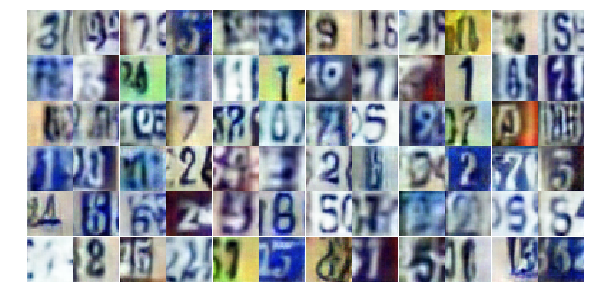

Epoch 22/30... Discriminator Loss: 1.0667... Generator Loss: 0.6787
Epoch 22/30... Discriminator Loss: 0.5198... Generator Loss: 1.6879
Epoch 22/30... Discriminator Loss: 0.9842... Generator Loss: 0.6370
Epoch 22/30... Discriminator Loss: 0.8209... Generator Loss: 0.9193
Epoch 22/30... Discriminator Loss: 1.0009... Generator Loss: 0.7654
Epoch 22/30... Discriminator Loss: 1.0894... Generator Loss: 0.5876
Epoch 22/30... Discriminator Loss: 0.8307... Generator Loss: 1.1132
Epoch 22/30... Discriminator Loss: 0.5015... Generator Loss: 1.3881
Epoch 22/30... Discriminator Loss: 1.0180... Generator Loss: 1.8085
Epoch 22/30... Discriminator Loss: 0.6194... Generator Loss: 1.2114


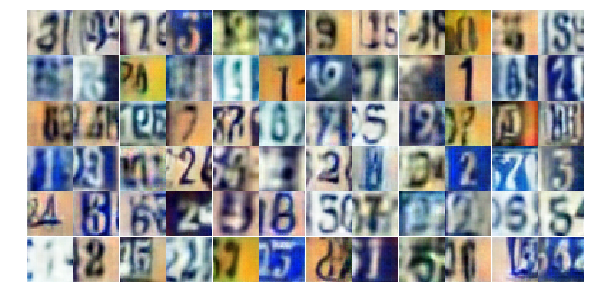

Epoch 23/30... Discriminator Loss: 0.6179... Generator Loss: 1.2935
Epoch 23/30... Discriminator Loss: 0.5326... Generator Loss: 1.1592
Epoch 23/30... Discriminator Loss: 1.1817... Generator Loss: 0.5385
Epoch 23/30... Discriminator Loss: 0.5249... Generator Loss: 1.4837
Epoch 23/30... Discriminator Loss: 0.7454... Generator Loss: 0.8665
Epoch 23/30... Discriminator Loss: 1.7840... Generator Loss: 0.2797
Epoch 23/30... Discriminator Loss: 1.0724... Generator Loss: 0.6499
Epoch 23/30... Discriminator Loss: 0.6417... Generator Loss: 1.1113
Epoch 23/30... Discriminator Loss: 0.8260... Generator Loss: 1.0001
Epoch 23/30... Discriminator Loss: 0.3788... Generator Loss: 1.6728


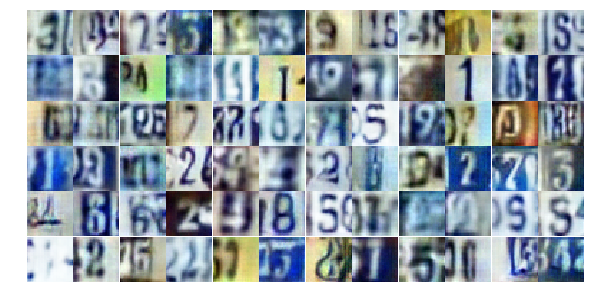

Epoch 23/30... Discriminator Loss: 0.7456... Generator Loss: 0.8898
Epoch 23/30... Discriminator Loss: 0.9444... Generator Loss: 0.7339
Epoch 23/30... Discriminator Loss: 1.0970... Generator Loss: 0.6008
Epoch 23/30... Discriminator Loss: 0.5817... Generator Loss: 1.1639
Epoch 23/30... Discriminator Loss: 0.4687... Generator Loss: 1.3255
Epoch 23/30... Discriminator Loss: 0.7702... Generator Loss: 0.9987
Epoch 23/30... Discriminator Loss: 0.9538... Generator Loss: 0.7049
Epoch 23/30... Discriminator Loss: 1.1829... Generator Loss: 1.6389
Epoch 23/30... Discriminator Loss: 1.3035... Generator Loss: 0.5019
Epoch 23/30... Discriminator Loss: 0.8167... Generator Loss: 0.9122


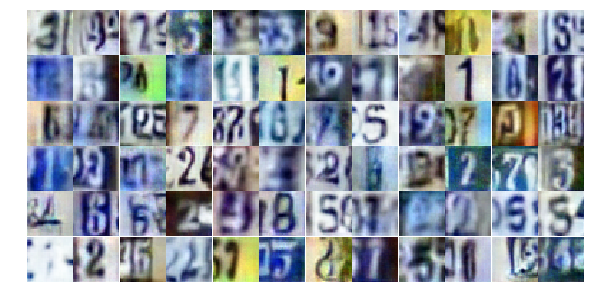

Epoch 23/30... Discriminator Loss: 1.5009... Generator Loss: 0.3934
Epoch 23/30... Discriminator Loss: 0.5022... Generator Loss: 1.4247
Epoch 23/30... Discriminator Loss: 1.1061... Generator Loss: 0.6131
Epoch 23/30... Discriminator Loss: 0.6591... Generator Loss: 1.0637
Epoch 23/30... Discriminator Loss: 0.5669... Generator Loss: 1.5340
Epoch 23/30... Discriminator Loss: 0.6244... Generator Loss: 1.3684
Epoch 23/30... Discriminator Loss: 0.4251... Generator Loss: 1.4337
Epoch 23/30... Discriminator Loss: 0.6689... Generator Loss: 1.0799
Epoch 23/30... Discriminator Loss: 0.8585... Generator Loss: 0.8446
Epoch 23/30... Discriminator Loss: 0.8791... Generator Loss: 1.2739


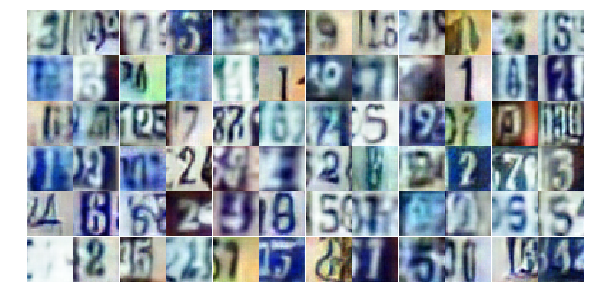

Epoch 23/30... Discriminator Loss: 0.5088... Generator Loss: 1.2748
Epoch 23/30... Discriminator Loss: 0.6189... Generator Loss: 1.1368
Epoch 23/30... Discriminator Loss: 0.6061... Generator Loss: 1.3332
Epoch 23/30... Discriminator Loss: 1.1560... Generator Loss: 0.5748
Epoch 23/30... Discriminator Loss: 0.8480... Generator Loss: 1.0661
Epoch 23/30... Discriminator Loss: 0.7252... Generator Loss: 1.0492
Epoch 23/30... Discriminator Loss: 1.7001... Generator Loss: 0.3857
Epoch 23/30... Discriminator Loss: 1.1270... Generator Loss: 0.6056
Epoch 23/30... Discriminator Loss: 0.4502... Generator Loss: 1.5187
Epoch 23/30... Discriminator Loss: 0.5561... Generator Loss: 1.2934


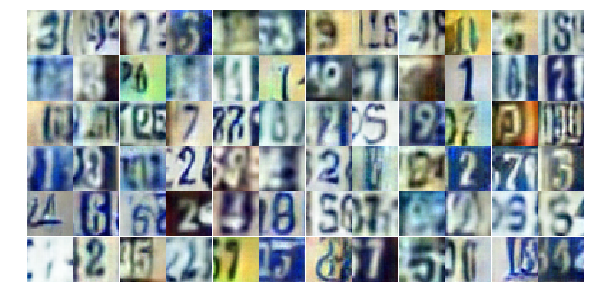

Epoch 23/30... Discriminator Loss: 1.1082... Generator Loss: 0.6501
Epoch 23/30... Discriminator Loss: 0.6715... Generator Loss: 0.9957
Epoch 23/30... Discriminator Loss: 1.2344... Generator Loss: 0.5095
Epoch 23/30... Discriminator Loss: 0.5905... Generator Loss: 1.5552
Epoch 23/30... Discriminator Loss: 2.5557... Generator Loss: 3.2389
Epoch 23/30... Discriminator Loss: 0.9533... Generator Loss: 0.8072
Epoch 23/30... Discriminator Loss: 1.2456... Generator Loss: 0.6325
Epoch 23/30... Discriminator Loss: 0.9333... Generator Loss: 0.7829
Epoch 23/30... Discriminator Loss: 0.6487... Generator Loss: 1.0730
Epoch 23/30... Discriminator Loss: 0.7492... Generator Loss: 0.9310


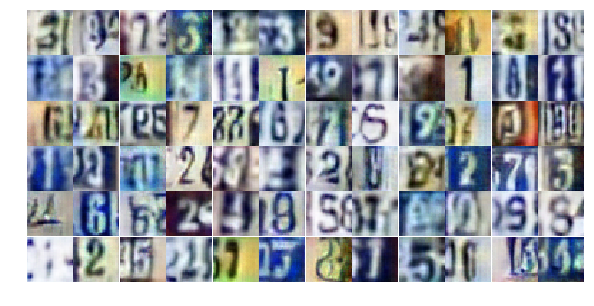

Epoch 23/30... Discriminator Loss: 0.6473... Generator Loss: 1.3241
Epoch 23/30... Discriminator Loss: 1.4512... Generator Loss: 0.4005
Epoch 23/30... Discriminator Loss: 0.6417... Generator Loss: 1.1367
Epoch 23/30... Discriminator Loss: 0.3982... Generator Loss: 1.9399
Epoch 23/30... Discriminator Loss: 1.5479... Generator Loss: 0.4788
Epoch 23/30... Discriminator Loss: 0.9426... Generator Loss: 0.7661
Epoch 23/30... Discriminator Loss: 1.1949... Generator Loss: 0.5733
Epoch 24/30... Discriminator Loss: 0.7796... Generator Loss: 0.8771
Epoch 24/30... Discriminator Loss: 0.6521... Generator Loss: 1.1948
Epoch 24/30... Discriminator Loss: 0.7487... Generator Loss: 1.2379


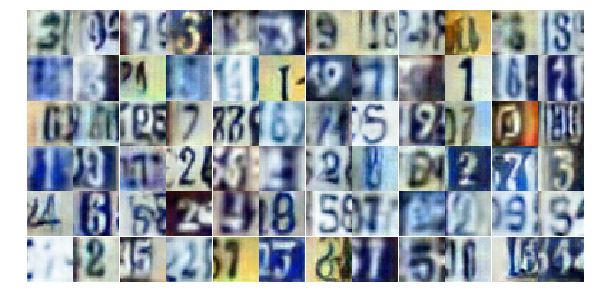

Epoch 24/30... Discriminator Loss: 0.5129... Generator Loss: 1.6269
Epoch 24/30... Discriminator Loss: 0.4800... Generator Loss: 1.6041
Epoch 24/30... Discriminator Loss: 0.9531... Generator Loss: 0.7333
Epoch 24/30... Discriminator Loss: 0.7337... Generator Loss: 1.2535
Epoch 24/30... Discriminator Loss: 0.7143... Generator Loss: 0.9467
Epoch 24/30... Discriminator Loss: 0.4930... Generator Loss: 1.3387
Epoch 24/30... Discriminator Loss: 0.6521... Generator Loss: 1.2591
Epoch 24/30... Discriminator Loss: 1.2183... Generator Loss: 0.5409
Epoch 24/30... Discriminator Loss: 0.5482... Generator Loss: 1.1730
Epoch 24/30... Discriminator Loss: 0.4448... Generator Loss: 1.4876


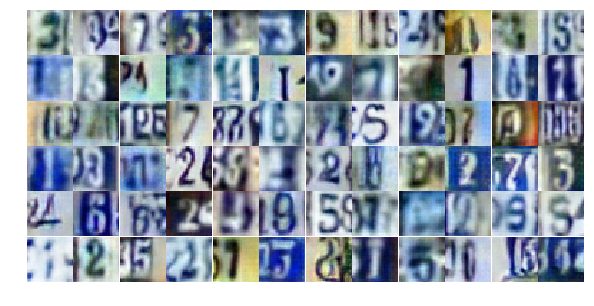

Epoch 24/30... Discriminator Loss: 1.3946... Generator Loss: 0.3687
Epoch 24/30... Discriminator Loss: 0.9110... Generator Loss: 0.8441
Epoch 24/30... Discriminator Loss: 1.1244... Generator Loss: 0.6868
Epoch 24/30... Discriminator Loss: 0.6542... Generator Loss: 0.9318
Epoch 24/30... Discriminator Loss: 0.4489... Generator Loss: 1.4144
Epoch 24/30... Discriminator Loss: 1.0737... Generator Loss: 0.5935
Epoch 24/30... Discriminator Loss: 0.6743... Generator Loss: 1.0304
Epoch 24/30... Discriminator Loss: 0.7652... Generator Loss: 1.3882
Epoch 24/30... Discriminator Loss: 0.8759... Generator Loss: 2.0853
Epoch 24/30... Discriminator Loss: 0.8344... Generator Loss: 0.8449


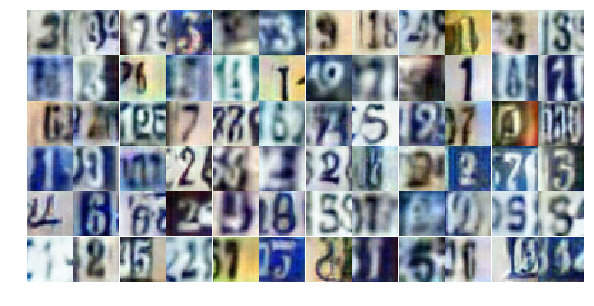

Epoch 24/30... Discriminator Loss: 0.9433... Generator Loss: 0.7247
Epoch 24/30... Discriminator Loss: 0.6517... Generator Loss: 1.0884
Epoch 24/30... Discriminator Loss: 0.6094... Generator Loss: 1.0758
Epoch 24/30... Discriminator Loss: 1.4142... Generator Loss: 0.5033
Epoch 24/30... Discriminator Loss: 0.5709... Generator Loss: 1.1126
Epoch 24/30... Discriminator Loss: 0.5245... Generator Loss: 1.2484
Epoch 24/30... Discriminator Loss: 0.5727... Generator Loss: 1.7191
Epoch 24/30... Discriminator Loss: 0.6661... Generator Loss: 1.3325
Epoch 24/30... Discriminator Loss: 0.6745... Generator Loss: 1.2525
Epoch 24/30... Discriminator Loss: 0.8794... Generator Loss: 0.7805


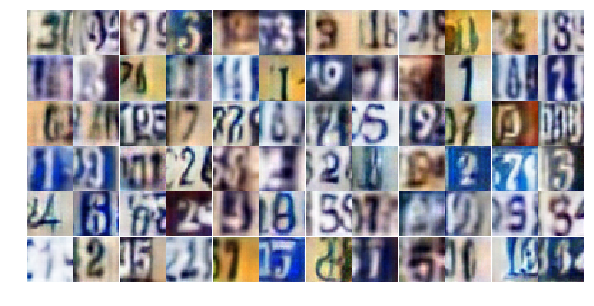

Epoch 24/30... Discriminator Loss: 0.6319... Generator Loss: 1.2181
Epoch 24/30... Discriminator Loss: 0.5320... Generator Loss: 1.3292
Epoch 24/30... Discriminator Loss: 0.7355... Generator Loss: 1.3847
Epoch 24/30... Discriminator Loss: 1.6149... Generator Loss: 0.3978
Epoch 24/30... Discriminator Loss: 0.8387... Generator Loss: 0.8714
Epoch 24/30... Discriminator Loss: 1.3183... Generator Loss: 0.4492
Epoch 24/30... Discriminator Loss: 1.1108... Generator Loss: 0.6612
Epoch 24/30... Discriminator Loss: 0.6400... Generator Loss: 1.0157
Epoch 24/30... Discriminator Loss: 0.6658... Generator Loss: 1.1703
Epoch 24/30... Discriminator Loss: 0.6564... Generator Loss: 2.5415


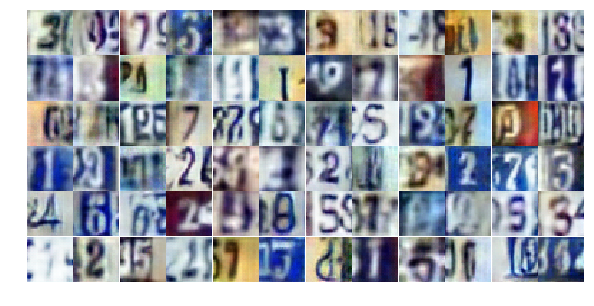

Epoch 24/30... Discriminator Loss: 0.7500... Generator Loss: 0.9496
Epoch 24/30... Discriminator Loss: 1.1355... Generator Loss: 0.6689
Epoch 24/30... Discriminator Loss: 1.8022... Generator Loss: 0.3555
Epoch 24/30... Discriminator Loss: 1.0576... Generator Loss: 0.8323
Epoch 24/30... Discriminator Loss: 1.2099... Generator Loss: 0.5404
Epoch 24/30... Discriminator Loss: 0.5568... Generator Loss: 1.3759
Epoch 24/30... Discriminator Loss: 0.9632... Generator Loss: 0.7121
Epoch 24/30... Discriminator Loss: 0.5744... Generator Loss: 1.2381
Epoch 24/30... Discriminator Loss: 0.9238... Generator Loss: 0.6941
Epoch 24/30... Discriminator Loss: 0.7635... Generator Loss: 1.6975


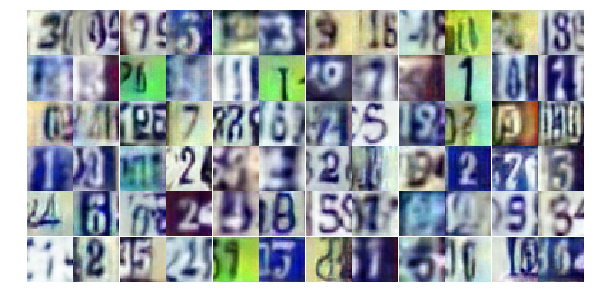

Epoch 24/30... Discriminator Loss: 0.7961... Generator Loss: 0.8853
Epoch 24/30... Discriminator Loss: 1.6440... Generator Loss: 0.3500
Epoch 24/30... Discriminator Loss: 0.6936... Generator Loss: 0.9591
Epoch 24/30... Discriminator Loss: 1.5378... Generator Loss: 0.3954
Epoch 24/30... Discriminator Loss: 1.6020... Generator Loss: 0.3178
Epoch 25/30... Discriminator Loss: 0.6555... Generator Loss: 1.3264
Epoch 25/30... Discriminator Loss: 0.4814... Generator Loss: 1.5344
Epoch 25/30... Discriminator Loss: 0.6220... Generator Loss: 1.1442
Epoch 25/30... Discriminator Loss: 1.1547... Generator Loss: 0.5911
Epoch 25/30... Discriminator Loss: 0.9037... Generator Loss: 0.7628


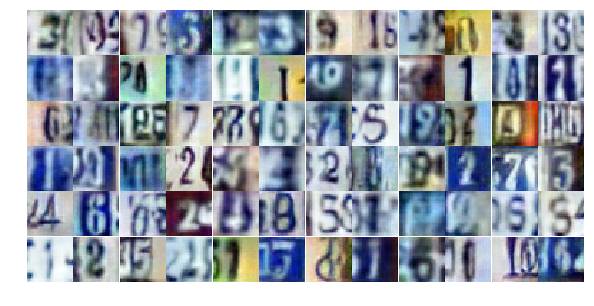

Epoch 25/30... Discriminator Loss: 0.8127... Generator Loss: 0.8313
Epoch 25/30... Discriminator Loss: 1.2235... Generator Loss: 0.5022
Epoch 25/30... Discriminator Loss: 0.8523... Generator Loss: 0.8097
Epoch 25/30... Discriminator Loss: 0.7130... Generator Loss: 1.3539
Epoch 25/30... Discriminator Loss: 0.7428... Generator Loss: 1.5526
Epoch 25/30... Discriminator Loss: 0.7462... Generator Loss: 1.0011
Epoch 25/30... Discriminator Loss: 0.8141... Generator Loss: 0.8000
Epoch 25/30... Discriminator Loss: 0.6064... Generator Loss: 1.2125
Epoch 25/30... Discriminator Loss: 0.4310... Generator Loss: 1.3988
Epoch 25/30... Discriminator Loss: 0.7632... Generator Loss: 0.8974


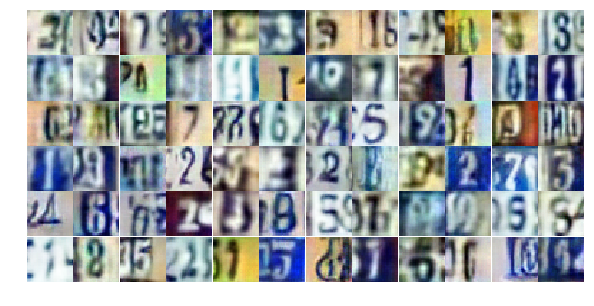

Epoch 25/30... Discriminator Loss: 0.5005... Generator Loss: 1.6512
Epoch 25/30... Discriminator Loss: 0.3860... Generator Loss: 2.8002
Epoch 25/30... Discriminator Loss: 1.4593... Generator Loss: 0.5121
Epoch 25/30... Discriminator Loss: 1.1268... Generator Loss: 0.5477
Epoch 25/30... Discriminator Loss: 1.0038... Generator Loss: 0.6279
Epoch 25/30... Discriminator Loss: 0.5658... Generator Loss: 1.3869
Epoch 25/30... Discriminator Loss: 1.3929... Generator Loss: 0.4350
Epoch 25/30... Discriminator Loss: 0.8308... Generator Loss: 1.0520
Epoch 25/30... Discriminator Loss: 0.6038... Generator Loss: 1.2083
Epoch 25/30... Discriminator Loss: 0.5609... Generator Loss: 1.2811


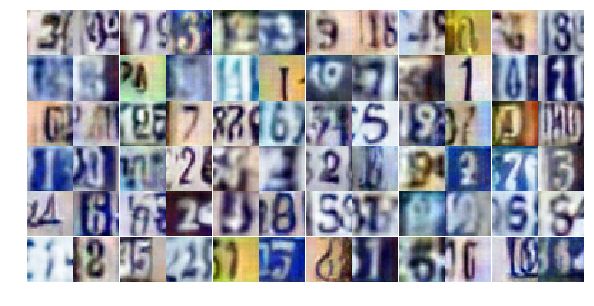

Epoch 25/30... Discriminator Loss: 0.9298... Generator Loss: 0.6960
Epoch 25/30... Discriminator Loss: 0.6198... Generator Loss: 1.3693
Epoch 25/30... Discriminator Loss: 1.4393... Generator Loss: 0.4816
Epoch 25/30... Discriminator Loss: 0.5245... Generator Loss: 1.2136
Epoch 25/30... Discriminator Loss: 1.1971... Generator Loss: 0.5497
Epoch 25/30... Discriminator Loss: 0.7750... Generator Loss: 0.8870
Epoch 25/30... Discriminator Loss: 0.9024... Generator Loss: 0.9533
Epoch 25/30... Discriminator Loss: 0.7308... Generator Loss: 0.9613
Epoch 25/30... Discriminator Loss: 0.7608... Generator Loss: 2.2892
Epoch 25/30... Discriminator Loss: 0.3972... Generator Loss: 1.7953


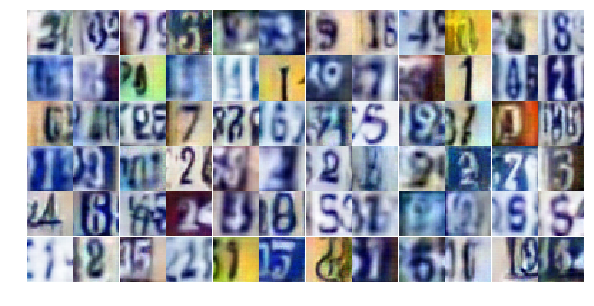

Epoch 25/30... Discriminator Loss: 0.6704... Generator Loss: 1.1314
Epoch 25/30... Discriminator Loss: 0.4367... Generator Loss: 1.5772
Epoch 25/30... Discriminator Loss: 1.5824... Generator Loss: 0.3241
Epoch 25/30... Discriminator Loss: 1.0210... Generator Loss: 0.7263
Epoch 25/30... Discriminator Loss: 0.9889... Generator Loss: 0.8377
Epoch 25/30... Discriminator Loss: 0.7582... Generator Loss: 1.0375
Epoch 25/30... Discriminator Loss: 0.3901... Generator Loss: 1.6940
Epoch 25/30... Discriminator Loss: 0.7155... Generator Loss: 0.9328
Epoch 25/30... Discriminator Loss: 1.7203... Generator Loss: 0.3125
Epoch 25/30... Discriminator Loss: 0.7221... Generator Loss: 0.8729


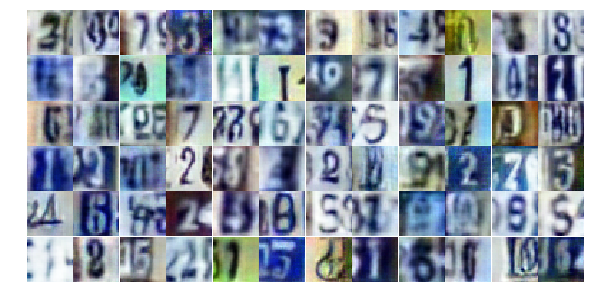

Epoch 25/30... Discriminator Loss: 0.7523... Generator Loss: 1.3115
Epoch 25/30... Discriminator Loss: 1.0246... Generator Loss: 0.7007
Epoch 25/30... Discriminator Loss: 1.4708... Generator Loss: 0.3912
Epoch 25/30... Discriminator Loss: 1.1078... Generator Loss: 0.6197
Epoch 25/30... Discriminator Loss: 1.1517... Generator Loss: 0.5802
Epoch 25/30... Discriminator Loss: 0.7723... Generator Loss: 0.9372
Epoch 25/30... Discriminator Loss: 0.8890... Generator Loss: 0.7735
Epoch 25/30... Discriminator Loss: 0.5687... Generator Loss: 1.2742
Epoch 25/30... Discriminator Loss: 1.1371... Generator Loss: 2.0853
Epoch 25/30... Discriminator Loss: 1.1487... Generator Loss: 0.6163


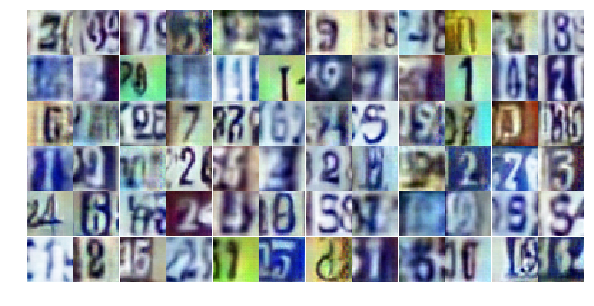

Epoch 25/30... Discriminator Loss: 0.4583... Generator Loss: 1.6812
Epoch 25/30... Discriminator Loss: 1.7595... Generator Loss: 0.2994
Epoch 26/30... Discriminator Loss: 1.7286... Generator Loss: 0.2950
Epoch 26/30... Discriminator Loss: 0.6799... Generator Loss: 1.1432
Epoch 26/30... Discriminator Loss: 1.0309... Generator Loss: 0.6058
Epoch 26/30... Discriminator Loss: 0.9820... Generator Loss: 0.7546
Epoch 26/30... Discriminator Loss: 0.5944... Generator Loss: 1.5307
Epoch 26/30... Discriminator Loss: 0.6300... Generator Loss: 1.3041
Epoch 26/30... Discriminator Loss: 0.7609... Generator Loss: 1.2035
Epoch 26/30... Discriminator Loss: 1.6434... Generator Loss: 0.4036


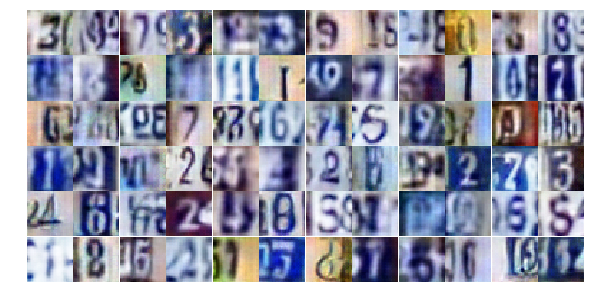

Epoch 26/30... Discriminator Loss: 0.8934... Generator Loss: 0.8116
Epoch 26/30... Discriminator Loss: 0.7317... Generator Loss: 0.8592
Epoch 26/30... Discriminator Loss: 1.0483... Generator Loss: 0.6503
Epoch 26/30... Discriminator Loss: 0.9052... Generator Loss: 0.7113
Epoch 26/30... Discriminator Loss: 1.1227... Generator Loss: 0.6098
Epoch 26/30... Discriminator Loss: 0.6306... Generator Loss: 1.1686
Epoch 26/30... Discriminator Loss: 0.8827... Generator Loss: 0.8202
Epoch 26/30... Discriminator Loss: 0.5043... Generator Loss: 1.3946
Epoch 26/30... Discriminator Loss: 0.6189... Generator Loss: 1.5972
Epoch 26/30... Discriminator Loss: 1.0617... Generator Loss: 1.2452


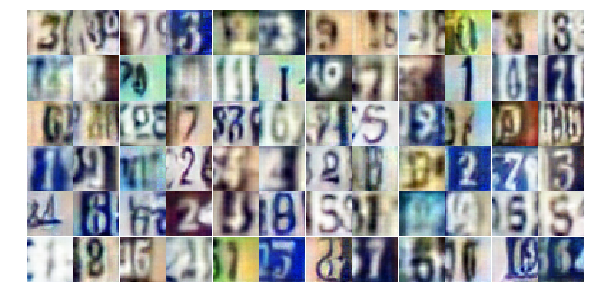

Epoch 26/30... Discriminator Loss: 0.3750... Generator Loss: 1.9020
Epoch 26/30... Discriminator Loss: 0.5152... Generator Loss: 1.3599
Epoch 26/30... Discriminator Loss: 0.6476... Generator Loss: 1.1081
Epoch 26/30... Discriminator Loss: 0.7517... Generator Loss: 0.9341
Epoch 26/30... Discriminator Loss: 0.5750... Generator Loss: 2.3112
Epoch 26/30... Discriminator Loss: 0.9556... Generator Loss: 0.7908
Epoch 26/30... Discriminator Loss: 1.1019... Generator Loss: 0.5579
Epoch 26/30... Discriminator Loss: 0.5714... Generator Loss: 1.3196
Epoch 26/30... Discriminator Loss: 0.8012... Generator Loss: 1.0415
Epoch 26/30... Discriminator Loss: 1.1483... Generator Loss: 0.5259


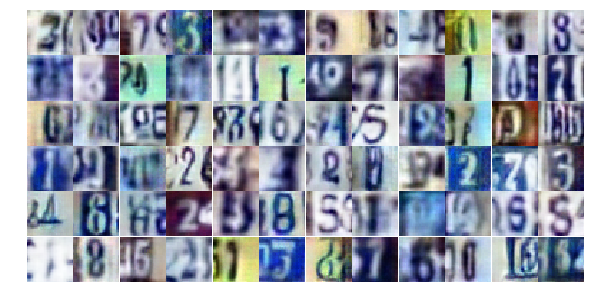

Epoch 26/30... Discriminator Loss: 0.5071... Generator Loss: 2.8054
Epoch 26/30... Discriminator Loss: 0.8914... Generator Loss: 1.1040
Epoch 26/30... Discriminator Loss: 1.1598... Generator Loss: 0.5788
Epoch 26/30... Discriminator Loss: 0.6932... Generator Loss: 1.0612
Epoch 26/30... Discriminator Loss: 0.7740... Generator Loss: 0.8770
Epoch 26/30... Discriminator Loss: 0.5382... Generator Loss: 1.3646
Epoch 26/30... Discriminator Loss: 0.9461... Generator Loss: 0.7804
Epoch 26/30... Discriminator Loss: 1.0730... Generator Loss: 0.7194
Epoch 26/30... Discriminator Loss: 0.6519... Generator Loss: 1.2202
Epoch 26/30... Discriminator Loss: 1.6463... Generator Loss: 0.3084


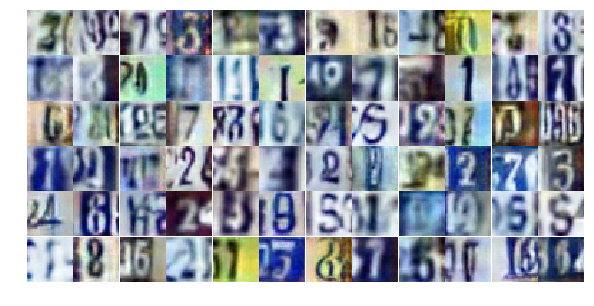

Epoch 26/30... Discriminator Loss: 0.6328... Generator Loss: 1.0592
Epoch 26/30... Discriminator Loss: 0.8638... Generator Loss: 0.9900
Epoch 26/30... Discriminator Loss: 0.6798... Generator Loss: 1.0075
Epoch 26/30... Discriminator Loss: 0.6034... Generator Loss: 1.1642
Epoch 26/30... Discriminator Loss: 0.5516... Generator Loss: 1.3015
Epoch 26/30... Discriminator Loss: 1.1520... Generator Loss: 0.5496
Epoch 26/30... Discriminator Loss: 0.5051... Generator Loss: 2.2072
Epoch 26/30... Discriminator Loss: 0.7620... Generator Loss: 1.0665
Epoch 26/30... Discriminator Loss: 2.1276... Generator Loss: 0.2203
Epoch 26/30... Discriminator Loss: 0.8408... Generator Loss: 0.9406


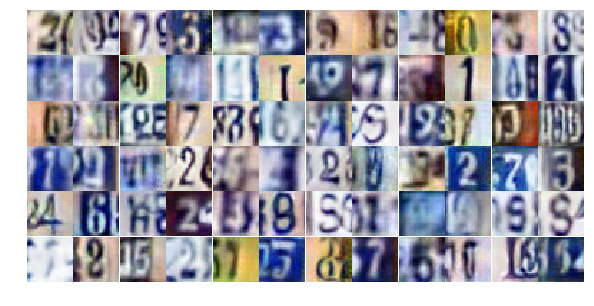

Epoch 26/30... Discriminator Loss: 1.0752... Generator Loss: 0.6348
Epoch 26/30... Discriminator Loss: 0.5493... Generator Loss: 1.1956
Epoch 26/30... Discriminator Loss: 1.0197... Generator Loss: 0.6976
Epoch 26/30... Discriminator Loss: 0.9310... Generator Loss: 0.9559
Epoch 26/30... Discriminator Loss: 0.6654... Generator Loss: 1.2836
Epoch 26/30... Discriminator Loss: 1.1885... Generator Loss: 0.6043
Epoch 26/30... Discriminator Loss: 0.6052... Generator Loss: 1.1131
Epoch 26/30... Discriminator Loss: 0.4807... Generator Loss: 1.9974
Epoch 26/30... Discriminator Loss: 0.9304... Generator Loss: 0.7114
Epoch 27/30... Discriminator Loss: 0.6467... Generator Loss: 2.3852


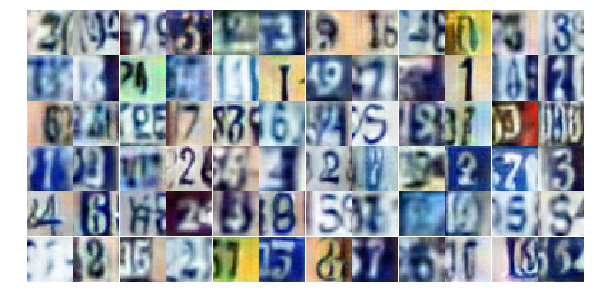

Epoch 27/30... Discriminator Loss: 0.5900... Generator Loss: 1.2216
Epoch 27/30... Discriminator Loss: 0.6037... Generator Loss: 1.5848
Epoch 27/30... Discriminator Loss: 0.6760... Generator Loss: 1.2997
Epoch 27/30... Discriminator Loss: 0.4717... Generator Loss: 1.4024
Epoch 27/30... Discriminator Loss: 0.5004... Generator Loss: 1.3214
Epoch 27/30... Discriminator Loss: 0.9134... Generator Loss: 0.7815
Epoch 27/30... Discriminator Loss: 0.9986... Generator Loss: 0.6861
Epoch 27/30... Discriminator Loss: 1.3591... Generator Loss: 0.5121
Epoch 27/30... Discriminator Loss: 0.7236... Generator Loss: 1.4089
Epoch 27/30... Discriminator Loss: 0.9924... Generator Loss: 0.7189


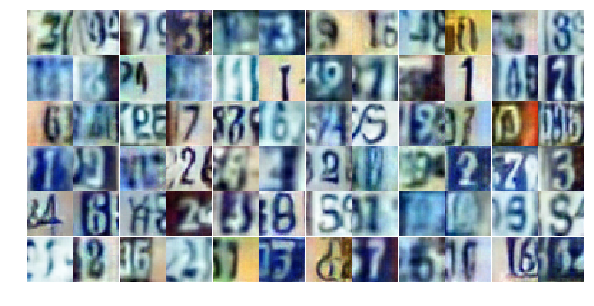

Epoch 27/30... Discriminator Loss: 0.6480... Generator Loss: 1.0282
Epoch 27/30... Discriminator Loss: 0.3750... Generator Loss: 1.7378
Epoch 27/30... Discriminator Loss: 0.5760... Generator Loss: 1.6545
Epoch 27/30... Discriminator Loss: 0.7317... Generator Loss: 1.5959
Epoch 27/30... Discriminator Loss: 1.1798... Generator Loss: 0.5785
Epoch 27/30... Discriminator Loss: 0.3887... Generator Loss: 1.5585
Epoch 27/30... Discriminator Loss: 1.4974... Generator Loss: 0.4563
Epoch 27/30... Discriminator Loss: 0.8798... Generator Loss: 1.4541
Epoch 27/30... Discriminator Loss: 1.0132... Generator Loss: 1.3192
Epoch 27/30... Discriminator Loss: 0.8498... Generator Loss: 1.1861


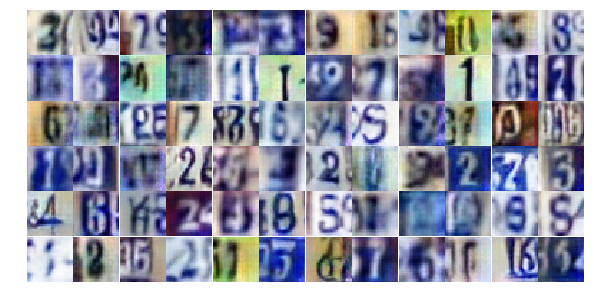

Epoch 27/30... Discriminator Loss: 0.8199... Generator Loss: 0.8780
Epoch 27/30... Discriminator Loss: 0.6966... Generator Loss: 1.0776
Epoch 27/30... Discriminator Loss: 0.6414... Generator Loss: 1.1276
Epoch 27/30... Discriminator Loss: 1.0173... Generator Loss: 0.7064
Epoch 27/30... Discriminator Loss: 0.7229... Generator Loss: 1.1480
Epoch 27/30... Discriminator Loss: 0.7284... Generator Loss: 1.0432
Epoch 27/30... Discriminator Loss: 1.0231... Generator Loss: 0.6516
Epoch 27/30... Discriminator Loss: 1.7510... Generator Loss: 0.3393
Epoch 27/30... Discriminator Loss: 0.4474... Generator Loss: 1.5177
Epoch 27/30... Discriminator Loss: 0.7118... Generator Loss: 1.0017


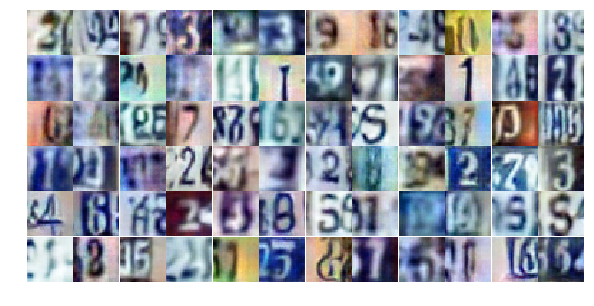

Epoch 27/30... Discriminator Loss: 0.6961... Generator Loss: 1.0900
Epoch 27/30... Discriminator Loss: 1.5949... Generator Loss: 0.3656
Epoch 27/30... Discriminator Loss: 0.3343... Generator Loss: 1.8462
Epoch 27/30... Discriminator Loss: 0.6669... Generator Loss: 1.0801
Epoch 27/30... Discriminator Loss: 0.9504... Generator Loss: 0.7470
Epoch 27/30... Discriminator Loss: 0.6814... Generator Loss: 1.3142
Epoch 27/30... Discriminator Loss: 0.6055... Generator Loss: 1.6657
Epoch 27/30... Discriminator Loss: 1.0111... Generator Loss: 0.6204
Epoch 27/30... Discriminator Loss: 0.8033... Generator Loss: 0.9283
Epoch 27/30... Discriminator Loss: 1.3503... Generator Loss: 0.5239


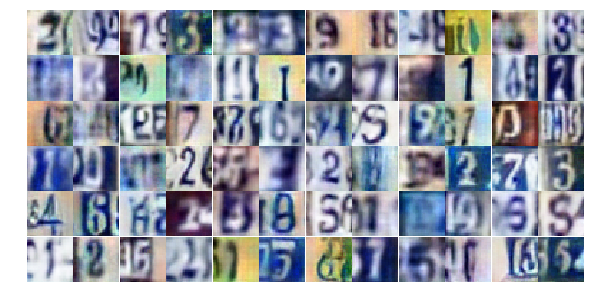

Epoch 27/30... Discriminator Loss: 0.5719... Generator Loss: 1.2800
Epoch 27/30... Discriminator Loss: 0.3690... Generator Loss: 2.5670
Epoch 27/30... Discriminator Loss: 1.2854... Generator Loss: 0.5822
Epoch 27/30... Discriminator Loss: 1.1489... Generator Loss: 0.6591
Epoch 27/30... Discriminator Loss: 0.4191... Generator Loss: 1.6531
Epoch 27/30... Discriminator Loss: 1.7533... Generator Loss: 0.4116
Epoch 27/30... Discriminator Loss: 0.5416... Generator Loss: 1.4679
Epoch 27/30... Discriminator Loss: 0.7846... Generator Loss: 1.0732
Epoch 27/30... Discriminator Loss: 1.4303... Generator Loss: 0.4178
Epoch 27/30... Discriminator Loss: 1.7707... Generator Loss: 0.3170


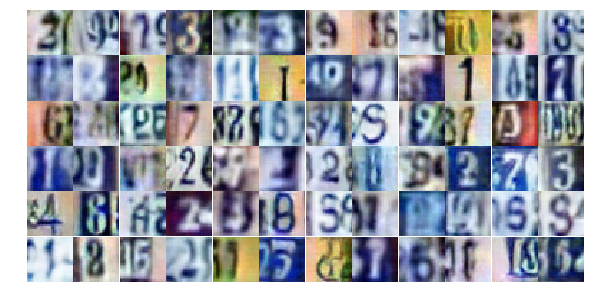

Epoch 27/30... Discriminator Loss: 0.6911... Generator Loss: 1.3134
Epoch 27/30... Discriminator Loss: 0.7671... Generator Loss: 1.1512
Epoch 27/30... Discriminator Loss: 1.8469... Generator Loss: 0.2994
Epoch 27/30... Discriminator Loss: 0.9735... Generator Loss: 0.7286
Epoch 27/30... Discriminator Loss: 1.3637... Generator Loss: 0.4893
Epoch 27/30... Discriminator Loss: 0.5527... Generator Loss: 1.3372
Epoch 27/30... Discriminator Loss: 1.0761... Generator Loss: 0.6595
Epoch 28/30... Discriminator Loss: 0.8971... Generator Loss: 0.7790
Epoch 28/30... Discriminator Loss: 0.7899... Generator Loss: 0.9271
Epoch 28/30... Discriminator Loss: 0.6683... Generator Loss: 1.1374


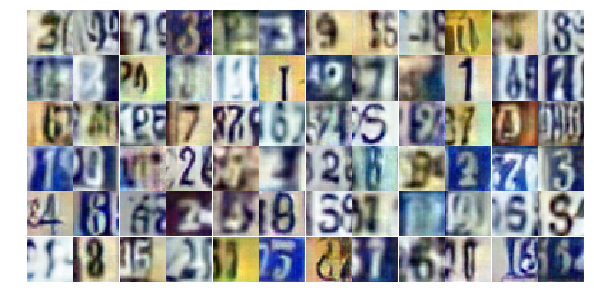

Epoch 28/30... Discriminator Loss: 0.9470... Generator Loss: 0.7469
Epoch 28/30... Discriminator Loss: 1.1039... Generator Loss: 0.5591
Epoch 28/30... Discriminator Loss: 0.7824... Generator Loss: 0.9779
Epoch 28/30... Discriminator Loss: 0.4039... Generator Loss: 1.7049
Epoch 28/30... Discriminator Loss: 1.0199... Generator Loss: 0.6625
Epoch 28/30... Discriminator Loss: 0.9064... Generator Loss: 0.7348
Epoch 28/30... Discriminator Loss: 0.3531... Generator Loss: 2.1177
Epoch 28/30... Discriminator Loss: 1.0257... Generator Loss: 0.6841
Epoch 28/30... Discriminator Loss: 1.4437... Generator Loss: 0.4689
Epoch 28/30... Discriminator Loss: 0.3795... Generator Loss: 1.6559


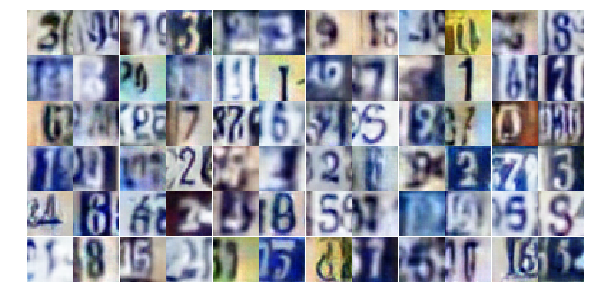

Epoch 28/30... Discriminator Loss: 0.6318... Generator Loss: 1.1416
Epoch 28/30... Discriminator Loss: 0.5205... Generator Loss: 1.2072
Epoch 28/30... Discriminator Loss: 0.4037... Generator Loss: 1.4731
Epoch 28/30... Discriminator Loss: 0.8383... Generator Loss: 1.0792
Epoch 28/30... Discriminator Loss: 0.6749... Generator Loss: 2.0620
Epoch 28/30... Discriminator Loss: 1.1159... Generator Loss: 0.6133
Epoch 28/30... Discriminator Loss: 0.5602... Generator Loss: 1.3003
Epoch 28/30... Discriminator Loss: 0.8282... Generator Loss: 0.9099
Epoch 28/30... Discriminator Loss: 0.9919... Generator Loss: 0.7235
Epoch 28/30... Discriminator Loss: 0.8392... Generator Loss: 1.1999


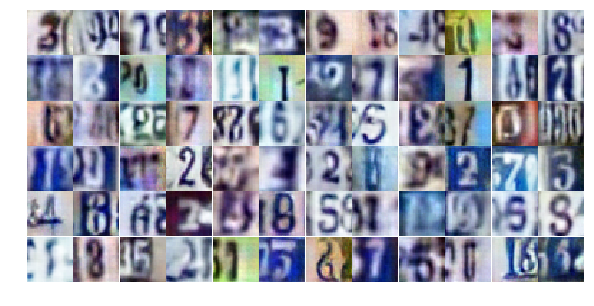

Epoch 28/30... Discriminator Loss: 0.6127... Generator Loss: 1.1723
Epoch 28/30... Discriminator Loss: 0.3879... Generator Loss: 1.6539
Epoch 28/30... Discriminator Loss: 0.4314... Generator Loss: 1.5249
Epoch 28/30... Discriminator Loss: 0.4470... Generator Loss: 1.4853
Epoch 28/30... Discriminator Loss: 0.9826... Generator Loss: 0.7798
Epoch 28/30... Discriminator Loss: 0.3891... Generator Loss: 1.5745
Epoch 28/30... Discriminator Loss: 0.6204... Generator Loss: 1.2260
Epoch 28/30... Discriminator Loss: 0.6001... Generator Loss: 1.2528
Epoch 28/30... Discriminator Loss: 0.6849... Generator Loss: 1.0446
Epoch 28/30... Discriminator Loss: 0.7224... Generator Loss: 1.0430


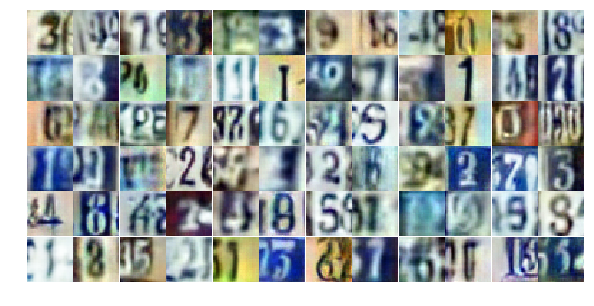

Epoch 28/30... Discriminator Loss: 0.2584... Generator Loss: 2.1938
Epoch 28/30... Discriminator Loss: 0.9985... Generator Loss: 0.6784
Epoch 28/30... Discriminator Loss: 1.3014... Generator Loss: 0.4408
Epoch 28/30... Discriminator Loss: 0.6167... Generator Loss: 1.2114
Epoch 28/30... Discriminator Loss: 0.8752... Generator Loss: 0.8418
Epoch 28/30... Discriminator Loss: 0.8102... Generator Loss: 0.8565
Epoch 28/30... Discriminator Loss: 0.6030... Generator Loss: 1.1023
Epoch 28/30... Discriminator Loss: 1.7190... Generator Loss: 0.3262
Epoch 28/30... Discriminator Loss: 0.3260... Generator Loss: 1.7401
Epoch 28/30... Discriminator Loss: 1.1359... Generator Loss: 0.5768


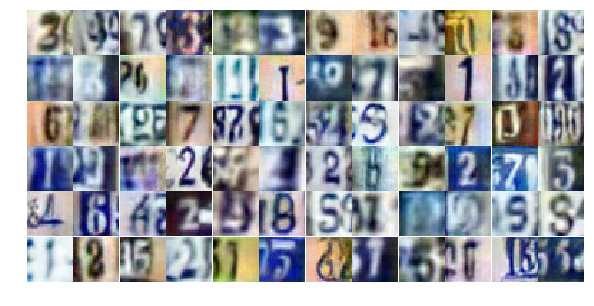

Epoch 28/30... Discriminator Loss: 2.3069... Generator Loss: 0.2757
Epoch 28/30... Discriminator Loss: 2.7274... Generator Loss: 0.1997
Epoch 28/30... Discriminator Loss: 0.3446... Generator Loss: 2.2396
Epoch 28/30... Discriminator Loss: 0.4727... Generator Loss: 1.4630
Epoch 28/30... Discriminator Loss: 0.8446... Generator Loss: 0.9578
Epoch 28/30... Discriminator Loss: 0.9601... Generator Loss: 0.7567
Epoch 28/30... Discriminator Loss: 1.1230... Generator Loss: 0.6320
Epoch 28/30... Discriminator Loss: 1.7624... Generator Loss: 0.2668
Epoch 28/30... Discriminator Loss: 0.6680... Generator Loss: 2.2836
Epoch 28/30... Discriminator Loss: 0.5305... Generator Loss: 1.3471


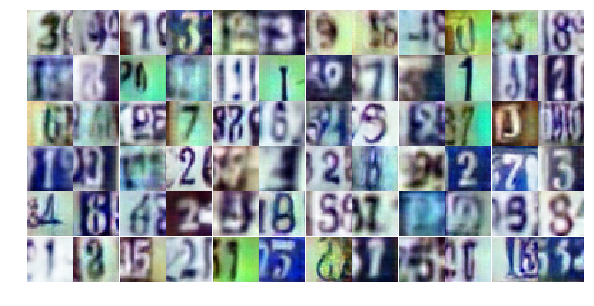

Epoch 28/30... Discriminator Loss: 0.5958... Generator Loss: 1.1293
Epoch 28/30... Discriminator Loss: 1.2527... Generator Loss: 0.5616
Epoch 28/30... Discriminator Loss: 0.5812... Generator Loss: 1.2341
Epoch 28/30... Discriminator Loss: 0.9442... Generator Loss: 3.5136
Epoch 29/30... Discriminator Loss: 1.3739... Generator Loss: 0.4637
Epoch 29/30... Discriminator Loss: 1.0798... Generator Loss: 0.6251
Epoch 29/30... Discriminator Loss: 0.7467... Generator Loss: 1.0944
Epoch 29/30... Discriminator Loss: 0.5357... Generator Loss: 1.3992
Epoch 29/30... Discriminator Loss: 0.7731... Generator Loss: 0.9518
Epoch 29/30... Discriminator Loss: 0.4722... Generator Loss: 1.5837


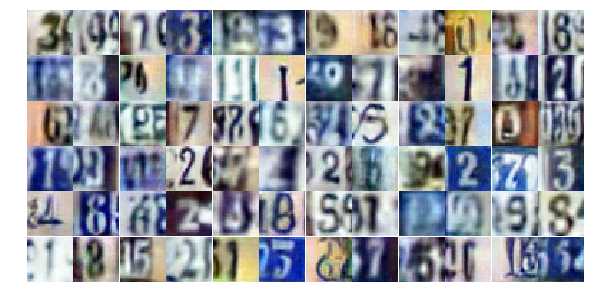

Epoch 29/30... Discriminator Loss: 0.7854... Generator Loss: 1.1860
Epoch 29/30... Discriminator Loss: 0.7859... Generator Loss: 1.0199
Epoch 29/30... Discriminator Loss: 0.9318... Generator Loss: 0.8010
Epoch 29/30... Discriminator Loss: 0.5961... Generator Loss: 1.2777
Epoch 29/30... Discriminator Loss: 0.7107... Generator Loss: 1.0453
Epoch 29/30... Discriminator Loss: 0.9314... Generator Loss: 1.2730
Epoch 29/30... Discriminator Loss: 1.0996... Generator Loss: 0.6404
Epoch 29/30... Discriminator Loss: 0.9613... Generator Loss: 0.7473
Epoch 29/30... Discriminator Loss: 1.4485... Generator Loss: 0.3764
Epoch 29/30... Discriminator Loss: 0.8049... Generator Loss: 0.8522


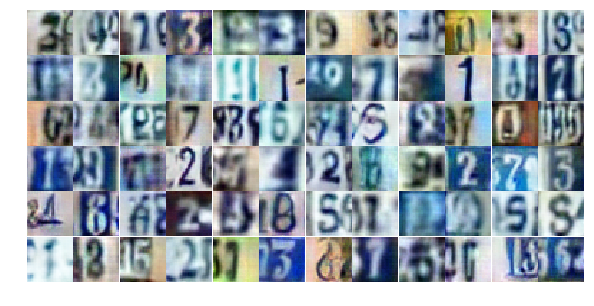

Epoch 29/30... Discriminator Loss: 0.7669... Generator Loss: 0.9513
Epoch 29/30... Discriminator Loss: 0.8331... Generator Loss: 0.9843
Epoch 29/30... Discriminator Loss: 1.1419... Generator Loss: 0.7006
Epoch 29/30... Discriminator Loss: 1.3364... Generator Loss: 0.6026
Epoch 29/30... Discriminator Loss: 0.9060... Generator Loss: 0.8729
Epoch 29/30... Discriminator Loss: 1.4989... Generator Loss: 0.4285
Epoch 29/30... Discriminator Loss: 0.8806... Generator Loss: 0.7452
Epoch 29/30... Discriminator Loss: 0.9812... Generator Loss: 0.7033
Epoch 29/30... Discriminator Loss: 0.7019... Generator Loss: 1.0216
Epoch 29/30... Discriminator Loss: 0.6049... Generator Loss: 1.1792


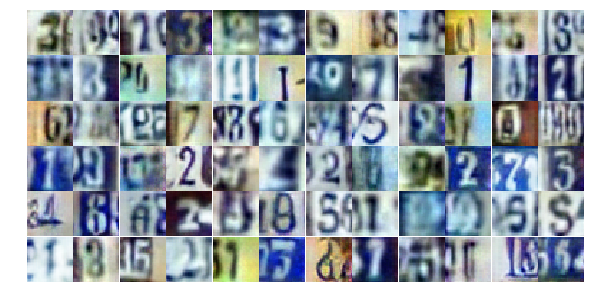

Epoch 29/30... Discriminator Loss: 0.5293... Generator Loss: 1.2936
Epoch 29/30... Discriminator Loss: 0.9181... Generator Loss: 0.7887
Epoch 29/30... Discriminator Loss: 0.6377... Generator Loss: 1.4884
Epoch 29/30... Discriminator Loss: 0.8815... Generator Loss: 0.8297
Epoch 29/30... Discriminator Loss: 0.5100... Generator Loss: 1.3497
Epoch 29/30... Discriminator Loss: 1.1321... Generator Loss: 0.6374
Epoch 29/30... Discriminator Loss: 1.8127... Generator Loss: 0.3025
Epoch 29/30... Discriminator Loss: 0.8652... Generator Loss: 0.9089
Epoch 29/30... Discriminator Loss: 1.2831... Generator Loss: 0.5924
Epoch 29/30... Discriminator Loss: 0.6127... Generator Loss: 1.1933


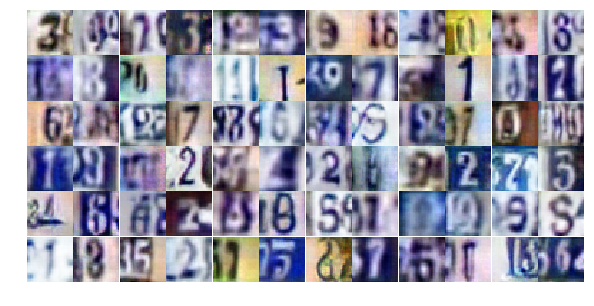

Epoch 29/30... Discriminator Loss: 0.3742... Generator Loss: 1.8068
Epoch 29/30... Discriminator Loss: 1.1849... Generator Loss: 0.5468
Epoch 29/30... Discriminator Loss: 0.9381... Generator Loss: 0.8066
Epoch 29/30... Discriminator Loss: 0.9835... Generator Loss: 0.6746
Epoch 29/30... Discriminator Loss: 0.7946... Generator Loss: 0.9647
Epoch 29/30... Discriminator Loss: 1.1272... Generator Loss: 0.5260
Epoch 29/30... Discriminator Loss: 0.4255... Generator Loss: 1.7239
Epoch 29/30... Discriminator Loss: 0.6331... Generator Loss: 1.3487
Epoch 29/30... Discriminator Loss: 0.3076... Generator Loss: 2.0606
Epoch 29/30... Discriminator Loss: 0.7859... Generator Loss: 0.8958


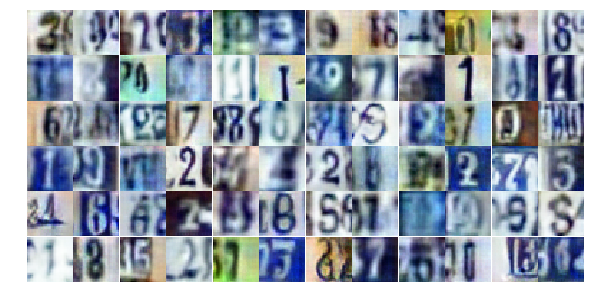

Epoch 29/30... Discriminator Loss: 0.4783... Generator Loss: 1.6348
Epoch 29/30... Discriminator Loss: 0.5058... Generator Loss: 1.3575
Epoch 29/30... Discriminator Loss: 1.1607... Generator Loss: 0.5803
Epoch 29/30... Discriminator Loss: 1.1492... Generator Loss: 0.6042
Epoch 29/30... Discriminator Loss: 0.9365... Generator Loss: 0.8549
Epoch 29/30... Discriminator Loss: 0.9270... Generator Loss: 3.4640
Epoch 29/30... Discriminator Loss: 0.6322... Generator Loss: 1.5427
Epoch 29/30... Discriminator Loss: 1.3054... Generator Loss: 0.5166
Epoch 29/30... Discriminator Loss: 0.6287... Generator Loss: 1.3111
Epoch 29/30... Discriminator Loss: 1.4453... Generator Loss: 0.4583


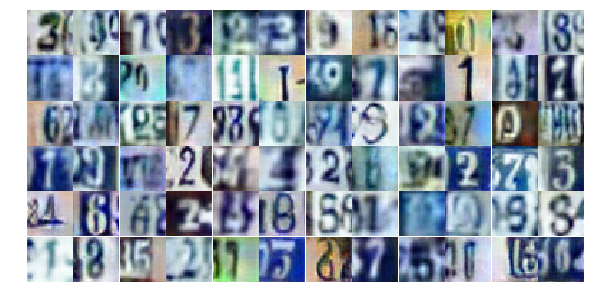

Epoch 29/30... Discriminator Loss: 0.5126... Generator Loss: 1.2849
Epoch 30/30... Discriminator Loss: 1.0213... Generator Loss: 0.6804
Epoch 30/30... Discriminator Loss: 0.8353... Generator Loss: 0.8587
Epoch 30/30... Discriminator Loss: 0.4916... Generator Loss: 1.3520
Epoch 30/30... Discriminator Loss: 0.9158... Generator Loss: 0.8523
Epoch 30/30... Discriminator Loss: 0.9084... Generator Loss: 0.7363
Epoch 30/30... Discriminator Loss: 1.2723... Generator Loss: 0.5717
Epoch 30/30... Discriminator Loss: 0.5386... Generator Loss: 1.3606
Epoch 30/30... Discriminator Loss: 1.3856... Generator Loss: 0.4392
Epoch 30/30... Discriminator Loss: 0.5328... Generator Loss: 1.2927


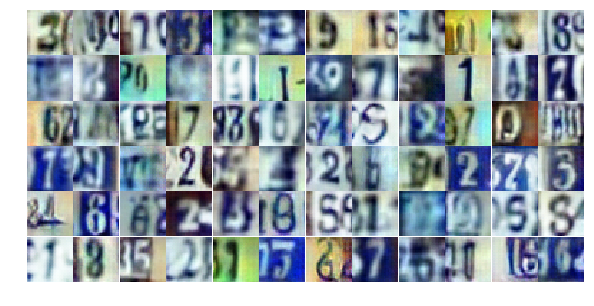

Epoch 30/30... Discriminator Loss: 0.8328... Generator Loss: 0.8164
Epoch 30/30... Discriminator Loss: 0.8082... Generator Loss: 0.9070
Epoch 30/30... Discriminator Loss: 1.2291... Generator Loss: 0.4952
Epoch 30/30... Discriminator Loss: 0.9698... Generator Loss: 0.7016
Epoch 30/30... Discriminator Loss: 1.3010... Generator Loss: 0.5696
Epoch 30/30... Discriminator Loss: 1.0365... Generator Loss: 0.7215
Epoch 30/30... Discriminator Loss: 0.7075... Generator Loss: 2.7193
Epoch 30/30... Discriminator Loss: 1.3071... Generator Loss: 0.6566
Epoch 30/30... Discriminator Loss: 1.2607... Generator Loss: 4.2614
Epoch 30/30... Discriminator Loss: 1.2991... Generator Loss: 0.6344


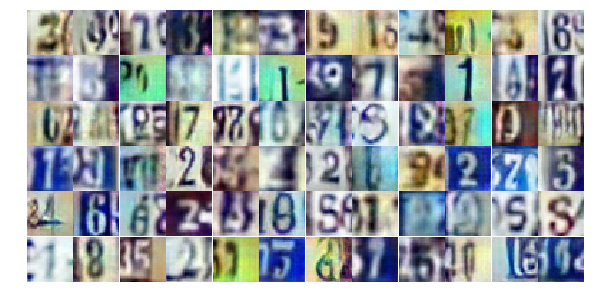

Epoch 30/30... Discriminator Loss: 0.6771... Generator Loss: 1.2619
Epoch 30/30... Discriminator Loss: 0.5287... Generator Loss: 1.3200
Epoch 30/30... Discriminator Loss: 0.8912... Generator Loss: 1.0450
Epoch 30/30... Discriminator Loss: 0.5903... Generator Loss: 1.1332
Epoch 30/30... Discriminator Loss: 0.5617... Generator Loss: 1.2277
Epoch 30/30... Discriminator Loss: 0.4868... Generator Loss: 1.1810
Epoch 30/30... Discriminator Loss: 1.4265... Generator Loss: 0.4616
Epoch 30/30... Discriminator Loss: 1.1885... Generator Loss: 0.5796
Epoch 30/30... Discriminator Loss: 0.4523... Generator Loss: 1.7180
Epoch 30/30... Discriminator Loss: 2.0539... Generator Loss: 4.6519


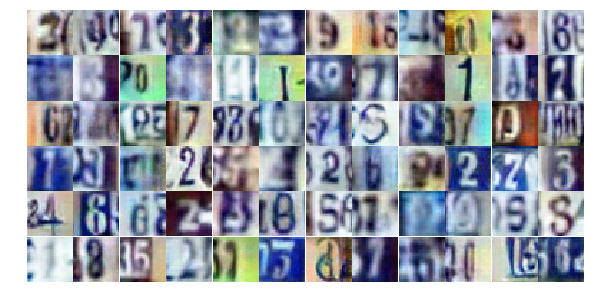

Epoch 30/30... Discriminator Loss: 4.6700... Generator Loss: 5.3970
Epoch 30/30... Discriminator Loss: 1.2243... Generator Loss: 0.6953
Epoch 30/30... Discriminator Loss: 0.5452... Generator Loss: 1.7932
Epoch 30/30... Discriminator Loss: 0.8935... Generator Loss: 0.8715
Epoch 30/30... Discriminator Loss: 0.6482... Generator Loss: 1.1994
Epoch 30/30... Discriminator Loss: 1.0043... Generator Loss: 0.7234
Epoch 30/30... Discriminator Loss: 0.8332... Generator Loss: 0.9099
Epoch 30/30... Discriminator Loss: 1.1636... Generator Loss: 0.6875
Epoch 30/30... Discriminator Loss: 0.7235... Generator Loss: 1.1188
Epoch 30/30... Discriminator Loss: 1.0749... Generator Loss: 0.6417


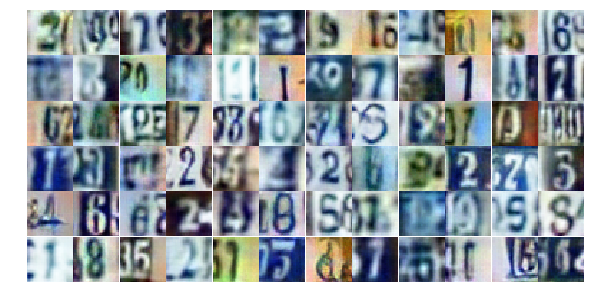

Epoch 30/30... Discriminator Loss: 0.9258... Generator Loss: 0.7336
Epoch 30/30... Discriminator Loss: 1.0363... Generator Loss: 1.3671
Epoch 30/30... Discriminator Loss: 0.8924... Generator Loss: 0.8890
Epoch 30/30... Discriminator Loss: 0.5184... Generator Loss: 1.4254
Epoch 30/30... Discriminator Loss: 0.7908... Generator Loss: 0.9728
Epoch 30/30... Discriminator Loss: 0.3713... Generator Loss: 2.3397
Epoch 30/30... Discriminator Loss: 0.4312... Generator Loss: 1.6958
Epoch 30/30... Discriminator Loss: 0.7512... Generator Loss: 1.0724
Epoch 30/30... Discriminator Loss: 0.6987... Generator Loss: 1.1379
Epoch 30/30... Discriminator Loss: 1.6173... Generator Loss: 0.3833


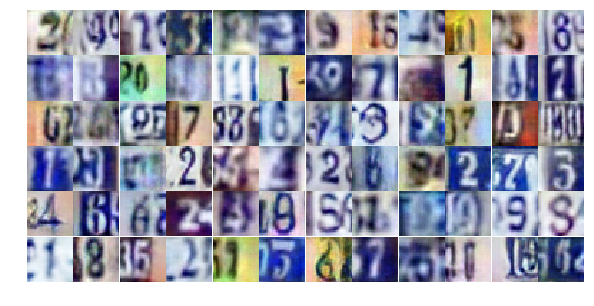

Epoch 30/30... Discriminator Loss: 0.5279... Generator Loss: 2.8571
Epoch 30/30... Discriminator Loss: 1.1462... Generator Loss: 0.5461
Epoch 30/30... Discriminator Loss: 0.5171... Generator Loss: 1.4575
Epoch 30/30... Discriminator Loss: 0.5387... Generator Loss: 1.2715
Epoch 30/30... Discriminator Loss: 1.3075... Generator Loss: 0.4720
Epoch 30/30... Discriminator Loss: 0.4948... Generator Loss: 1.5619
Epoch 30/30... Discriminator Loss: 0.8683... Generator Loss: 1.7366
Epoch 30/30... Discriminator Loss: 0.5740... Generator Loss: 1.3435
Epoch 30/30... Discriminator Loss: 0.5592... Generator Loss: 1.2582


In [28]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

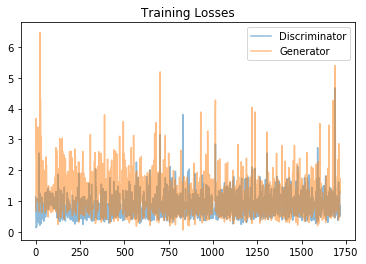

In [29]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

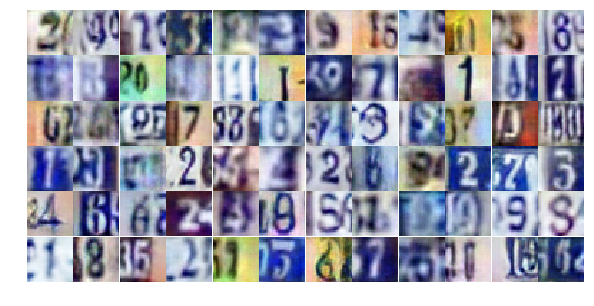

In [30]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))